### Prepare functions

In [1]:
import hoomd
from hoomd import hpmc, md
import numpy as np
# import hoomd.htf as htf
import tensorflow as tf

In [2]:
# gpus = tf.config.list_physical_devices('GPU')
# if gpus:
#   # Restrict TensorFlow to only allocate 1GB of memory on the first GPU
#   try:
#     tf.config.experimental.set_virtual_device_configuration(
#         gpus[0],
#         [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=4096)])
#     logical_gpus = tf.config.experimental.list_logical_devices('GPU')
#     print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
#   except RuntimeError as e:
#     # Virtual devices must be set before GPUs have been initialized
#     print(e)

In [3]:
print(np.__version__)

1.19.5


In [4]:
def plot_config(pts,L=1):
    fig, ax = plt.subplots()
    fig.set_size_inches(5,5)
    circles = [plt.Circle(p,.5) for p in pts]
    for c in circles:
        ax.add_patch(c)
    ax.set_xlim(-L/2,L/2)
    ax.set_ylim(-L/2,L/2)

In [5]:
def overlapper(pts, sigma=1):
    pts_np = np.array(pts)
    pts_mtx = np.sqrt(((pts_np[:,:,None] - pts_np[:,:,None].T)**2).sum(1))
    np.fill_diagonal(pts_mtx, 99999.0)
#     print(pts_mtx, pts_mtx.shape)
#     print(np.min(pts_mtx,axis=1) < sigma)
    return np.where(np.min(pts_mtx,axis=1) < sigma)

In [6]:
import matplotlib.pyplot as plt
def plot_config_wrap(pts,L=1,title=None,color_overlapper=False,lm=None,ring=None):
    
    fig, ax = plt.subplots()
#     print(f'Length of pts is {len(pts)}')
    if lm is None:
        lm = 1 # length_multiplier - for larger plots when points are more
        if len(pts) > 256:
            lm = np.sqrt(len(pts)/256.0)
        if len(pts) > 256*9:
            lm = 3
#     print(f'lm is {lm}')
    fig.set_size_inches(6*lm,6*lm)
    
    if ring is None:
        if len(pts) > 2048:
            ring=False
        else:
            ring=True
    
    
    pts_addl = []
    for p in pts:
        if p[0] < -L/2+0.5:
            pts_addl.append([p[0]+L, p[1]])  
            if p[1] < -L/2+0.5:
                pts_addl.append([p[0]+L, p[1]+L])
            if p[1] > L/2+0.5:
                pts_addl.append([p[0]+L, p[1]-L])
        if p[0] > L/2+0.5:
            pts_addl.append([p[0]-L, p[1]])
            if p[1] < -L/2+0.5:
                pts_addl.append([p[0]-L, p[1]+L])
            if p[1] > L/2+0.5:
                pts_addl.append([p[0]-L, p[1]-L])
        if p[1] < -L/2+0.5:
            pts_addl.append([p[0], p[1]+L])
        if p[1] > L/2+0.5:
            pts_addl.append([p[0], p[1]-L])

    if len(pts_addl) > 0:
        pts_addl = np.array(pts_addl)
        pts_total = np.vstack([pts,pts_addl])
    else:
        pts_total = pts
        
    if color_overlapper:
        overlapping_particles = overlapper(pts_total)[0]
    if ring:
        circles = [plt.Circle(p,.5,alpha=0.5,ec='red') for p in pts]
        circles2 = [plt.Circle(p,.5,alpha=0.5,ec='red') for p in pts_addl]
    else:
        circles = [plt.Circle(p,.5,alpha=0.5) for p in pts]
        circles2 = [plt.Circle(p,.5,alpha=0.5) for p in pts_addl]


    for c in circles:
        ax.add_patch(c)
    for c in circles2:
        ax.add_patch(c)
    if color_overlapper:
        circles_overlap  = [plt.Circle(pts_total[ii],.5,alpha=0.5,ec='none',fc='tab:red') for ii in overlapping_particles]
        for c in circles_overlap:
            ax.add_patch(c)
    ax.set_xlim(-L/2,L/2)
    ax.set_ylim(-L/2,L/2)
    if title is not None:
        ax.set_title(title)

In [7]:
import matplotlib.pyplot as plt
def plot_config_wrap_multiple(pts,L=1,title=None,first=False,fig=None,ax=None,color_overlapper=False,ring=None):
    if first:
        fig, ax = plt.subplots()
        lm = 1 # length_multiplier - for larger plots
        if len(pts) > 256:
            lm = np.sqrt(len(pts)/256.0)
        if len(pts) > 256*4:
            lm = 2
        fig.set_size_inches(6*lm,6*lm)
    if ring is None:
        if len(pts) > 2048:
            ring=False
        else:
            ring=True
    
    pts_addl = []
    for p in pts:
        if p[0] < -L/2+0.5:
            pts_addl.append([p[0]+L, p[1]])  
            if p[1] < -L/2+0.5:
                pts_addl.append([p[0]+L, p[1]+L])
            if p[1] > L/2+0.5:
                pts_addl.append([p[0]+L, p[1]-L])
        if p[0] > L/2+0.5:
            pts_addl.append([p[0]-L, p[1]])
            if p[1] < -L/2+0.5:
                pts_addl.append([p[0]-L, p[1]+L])
            if p[1] > L/2+0.5:
                pts_addl.append([p[0]-L, p[1]-L])
        if p[1] < -L/2+0.5:
            pts_addl.append([p[0], p[1]+L])
        if p[1] > L/2+0.5:
            pts_addl.append([p[0], p[1]-L])
        
    if len(pts_addl) > 0:
        pts_addl = np.array(pts_addl)
        pts_total = np.vstack([pts,pts_addl])
    else:
        pts_total = pts
        
    if color_overlapper:
        overlapping_particles = overlapper(pts_total)[0]
    if ring:
        circles = [plt.Circle(p,.5,alpha=0.1,ec='red') for p in pts]
        circles2 = [plt.Circle(p,.5,alpha=0.1,ec='red') for p in pts_addl]
    else:
        circles = [plt.Circle(p,.5,alpha=0.1) for p in pts]
        circles2 = [plt.Circle(p,.5,alpha=0.1) for p in pts_addl]
        
    for c in circles:
        ax.add_patch(c)
    for c in circles2:
        ax.add_patch(c)
    if color_overlapper:
        circles_overlap  = [plt.Circle(pts_total[ii],.5,alpha=0.1,ec='none',fc='tab:red') for ii in overlapping_particles]
        for c in circles_overlap:
            ax.add_patch(c)
    ax.set_xlim(-L/2,L/2)
    ax.set_ylim(-L/2,L/2)
    if title is not None:
        ax.set_title(title)
    if first:
        return fig, ax

### Invertible network for hard particles

In [8]:
# Maximum likelihood in z
import tensorflow as tf
def loss_z(inv_net):
    return -inv_net.log_likelihood_z_normal()

In [9]:
import tensorflow as tf
def loss_x(inv_net):
    x = inv_net.output_x
    f = inv_net.overlap_model.smooth_overlap_tf(x)
    #return tf.where(f>0,tf.math.log(f)-inv_net.log_det_Jzx[:,0],0)
    #return f*tf.math.exp(-inv_net.log_det_Jzx[:,0])
    return f-inv_net.log_det_Jzx[:,0]
    #return f*tf.math.exp(-inv_net.log_det_Jzx[:,0])
    

In [10]:
import tensorflow.keras as keras
import tensorflow as tf
from deep_boltzmann.networks.invertible import InvNet

class OverlapInvNet(InvNet):

    def __init__(self, overlap_model, layers):
        """ Invertible net where we have an overlap function (==0 or 1) that defines p(x)
            and the prior is the uniform on the interval [a,b)"""
        self.overlap_model = overlap_model
        super().__init__(overlap_model.dim, layers, prior='normal')
        
        self.Tzx.add_loss(loss_x(self))
        self.Txz.add_loss(loss_z(self))
        
    @classmethod
    def load(cls, filename, overlap_model):
        """ Loads parameters into model. Careful: this clears the whole TF session!!
        """
        from deep_boltzmann.util import load_obj
        keras.backend.clear_session()
        D = load_obj(filename)
#         prior = D['prior']
        layerdicts = D['layers']
        layers = [eval(d['type']).from_dict(d) for d in layerdicts]
        return OverlapInvNet(overlap_model, layers)

    def weight(self):
        """ Computes the reweighting factor
        """
        z = self.input_z
        x = self.output_x
        # compute overlap property
        f = self.overlap_model.smooth_overlap_tf(x)
        weight = tf.math.exp(self.log_det_Jzx[:, 0])
        return weight

    def sample(self, nsample=100000, temperature=1.0):
        """ Samples from prior distribution in z and produces generated x configurations

        Parameters:
        -----------
        temperature : float
            Relative temperature. Equal to the variance of the isotropic Gaussian sampled in z-space.
        nsample : int
            Number of samples

        Returns:
        --------
        sample_z : array
            Samples in z-space
        sample_x : array
            Samples in x-space
        weight_z:
            Weight of z samples
        overlap_x : array
            Overlap property of x samples
        w : array
            Weight of samples

        """

        sample_z, energy_z = self.sample_z(nsample=nsample, return_energy=True, temperature=temperature)

        sample_x, Jzx = self.transform_zxJ(sample_z)
        overlap_x = self.overlap_model.smooth_overlap_tf(sample_x).numpy()
        print(overlap_x)
        w = np.exp(Jzx)
        logw = overlap_x + energy_z + Jzx

        return sample_z, sample_x, energy_z, overlap_x, w, logw

    
    def train_z(self, x, xval=None, optimizer=None, lr=0.001, epochs=2000, batch_size=1024, verbose=1, clipnorm=None):
        if optimizer is None:
            if clipnorm is None:
                optimizer = keras.optimizers.Adam(lr=lr)
            else:
                optimizer = keras.optimizers.Adam(lr=lr, clipnorm=clipnorm)
                
        self.Txz.compile(optimizer)

        if xval is not None:
            validation_data = (xval, np.zeros_like(xval))
        else:
            validation_data = None

        hist = self.Txz.fit(x=x, validation_data=validation_data,
                            batch_size=batch_size, epochs=epochs, verbose=verbose, shuffle=True)

        return hist
    
    def train_x(self, optimizer=None, lr=0.001, batches=1,epochs=2000, batch_size=1024, verbose=1, clipnorm=None):
        if optimizer is None:
            if clipnorm is None:
                optimizer = keras.optimizers.Adam(lr=lr)
            else:
                optimizer = keras.optimizers.Adam(lr=lr, clipnorm=clipnorm)
                
        self.Tzx.compile(optimizer)

        x = self.sample_z(nsample=batches*batch_size, return_energy=False)
        hist = self.Tzx.fit(x=x,batch_size=batch_size, epochs=epochs, verbose=verbose, shuffle=True)

        return hist

    def train_both(self, x, xval=None, optimizer=None, lr=0.001, epochs=2000, batch_size=1024, verbose=1, clipnorm=None):
        if optimizer is None:
            if clipnorm is None:
                optimizer = keras.optimizers.Adam(lr=lr)
            else:
                optimizer = keras.optimizers.Adam(lr=lr, clipnorm=clipnorm)
       
        inputs = []
        outputs = []
        losses = []
        losses.append(loss_z(self))
        losses.append(loss_x(self))
        inputs.append(self.input_x)
        inputs.append(self.input_z)
        outputs.append(self.output_z)
        outputs.append(self.output_x)

        self.model = keras.models.Model(inputs=inputs, outputs=outputs)
        l = losses[0]+losses[1]
        self.model.add_loss(l)
        self.model.compile(optimizer=optimizer)
        
        if xval is not None:
            validation_data = (xval, np.zeros_like(xval))
        else:
            validation_data = None

        w = self.sample_z(nsample=x.shape[0], return_energy=False)
        hist = self.model.fit(x=[x,w], validation_data=validation_data,
                            batch_size=batch_size, epochs=epochs, verbose=verbose, shuffle=True)

        return hist

In [11]:
class Limit(object):
    def __init__(self, dim, L=1):
        self.L = L
        self.dim = dim
    
        self.tanh = tf.keras.layers.Activation('tanh')
        self.scale = tf.keras.layers.experimental.preprocessing.Rescaling(scale=self.L/2)
        self.inv_scale = tf.keras.layers.experimental.preprocessing.Rescaling(scale=2/self.L)
        self.atanh = tf.keras.layers.Activation(lambda x: tf.atanh(x))
        
    def connect_xz(self, x):
        def lambda_Jxz(x):
            J = -tf.math.log(1-(2*x/self.L)**2)
            return tf.reduce_sum(J,axis=-1)[0] * tf.ones((tf.shape(x)[0], 1))
        self.log_det_xz = keras.layers.Lambda(lambda_Jxz)(x)
        z = self.atanh(self.inv_scale(x))
        return z

    def connect_zx(self, z):
        def lambda_Jzx(z):
            J = -tf.math.log(tf.cosh(z)**2)
            return tf.reduce_sum(J,axis=-1)[0] * tf.ones((tf.shape(z)[0], 1))
        self.log_det_zx = keras.layers.Lambda(lambda_Jzx)(z)
        x = self.scale(self.tanh(z))
        return x

    @property
    def log_det_Jxz(self):
        """ Log of |det(dz/dx)| for the current batch. Format is batchsize x 1 or a number """
        return self.log_det_xz

    @property
    def log_det_Jzx(self):
        """ Log of |det(dx/dz)| for the current batch. Format is batchsize x 1 or a number """
        return self.log_det_zx
    
    def to_dict(self):
        D = {}
        D['L'] = self.L
#         D['trainable'] = self.trainable
        D['dim'] = self.dim
        return D
    
    @classmethod
    def from_dict(cls, D):
        dim = D['dim']
#         trainable = D['trainable']
        L = D['L']
        return Limit(dim=dim, L=L)



In [12]:
from deep_boltzmann.networks.invertible import split_merge_indices, SplitChannels, MergeChannels, \
                                               RealNVP, NICER, InvNet, nonlinear_transform, Scaling

def invnet(dim, layer_types, overlap_model=None, channels=None, L=1.0,
           nl_layers=2, nl_hidden=100, nl_activation='relu',
           nl_activation_t='relu',scale=None, prior='normal'):
    """
    layer_types : str
        String describing the sequence of layers. Usage:
            N NICER layer
            R RealNVP layerl
            S Scaling layer
        Splitting and merging layers will be added automatically
    overlap_model : Overlap model class
        Class with overlap_tf() and dim
    channels : array or None
        Assignment of dimensions to channels (0/1 array of length ndim)
    nl_layers : int
        Number of hidden layers in the nonlinear transformations
    nl_hidden : int
        Number of hidden units in each nonlinear layer
    nl_activation : str
        Activation functions used in the nonlinear layers
    scale : None or float
        If a scaling layer is used, fix the scale to this number. If None, scaling layers are trainable
    """
    # fix channels
    channels, indices_split, indices_merge = split_merge_indices(dim, nchannels=2, channels=channels)

    # augment layer types with split and merge layers
    split = False
    tmp = ''
    for ltype in layer_types:
        if (ltype == 'S' or ltype == 'L') and split:
            tmp += '>'
            split = False
        if (ltype == 'N' or ltype == 'R') and not split:
            tmp += '<'
            split = True
        tmp += ltype
    if split:
        tmp += '>'
    layer_types = tmp
    print(layer_types)

    # prepare layers
    layers = []

#     reg = tf.keras.regularizers.l2(.01) #?
    reg = None
    for ltype in layer_types:
        if ltype == '<':
            # split into two x channels
            layers.append(SplitChannels(dim, nchannels=2, channels=channels))
        if ltype == '>':
            # merge into one z channel
            layers.append(MergeChannels(dim, nchannels=2, channels=channels))
        if ltype == 'N':
            M1 = nonlinear_transform(indices_split[1].size, nlayers=nl_layers, nhidden=nl_hidden,
                                     activation=nl_activation)
            M2 = nonlinear_transform(indices_split[0].size, nlayers=nl_layers, nhidden=nl_hidden,
                                     activation=nl_activation)
            layers.append(NICER([M1, M2]))
        elif ltype == 'R':
            S1 = nonlinear_transform(indices_split[1].size, nlayers=nl_layers, nhidden=nl_hidden,
                                     activation=nl_activation, init_outputs=0,
                                     activity_regularizer=reg)
            T1 = nonlinear_transform(indices_split[1].size, nlayers=nl_layers, nhidden=nl_hidden,
                                     activation=nl_activation_t)
            S2 = nonlinear_transform(indices_split[0].size, nlayers=nl_layers, nhidden=nl_hidden,
                                     activation=nl_activation, init_outputs=0,
                                     activity_regularizer=reg)
            T2 = nonlinear_transform(indices_split[0].size, nlayers=nl_layers, nhidden=nl_hidden,
                                     activation=nl_activation_t)
            layers.append(RealNVP([S1, T1, S2, T2]))
        elif ltype == 'L':
            layers.append(Limit(dim, L=L))
        elif ltype == 'S':
            # scaling layer
            if scale is None:
                scaling_factors = None
            else:
                scaling_factors = scale * np.ones((1, dim))
            layers.append(Scaling(dim, scaling_factors=scaling_factors, trainable=(scale is None)))

    if overlap_model is None:
        inv_net = InvNet(dim, layers, prior='normal')
    else:
        inv_net = OverlapInvNet(overlap_model, layers)
    
    inv_net.reg = reg
    return inv_net

### Hard disk overlap

In [13]:
import numpy as np

def ensure_traj(X):
    if np.ndim(X) == 2:
        return X
    if np.ndim(X) == 1:
        return np.array([X])
    raise ValueError('Incompatible array with shape: ', np.shape(X))

    
def dist2_min_image(crd1, crd2, L, dim=2):
    """ Returns the distance matrix or matrices between particles, with periodic boundary conditions

    Parameters
    ----------
    crd1 : array or matrix
        first coordinate set
    crd2 : array or matrix
        second coordinate set
    L: length of simulation box
    dim : int
        dimension of particle system. If d=2, coordinate vectors are [x1, y1, x2, y2, ...]

    """
    crd1 = ensure_traj(crd1)
    crd2 = ensure_traj(crd2)
    n = int(np.shape(crd1)[1]/dim)

    crd1_components = [np.tile(np.expand_dims(crd1[:, i::dim], 2), (1, 1, n)) for i in range(dim)]
    crd2_components = [np.tile(np.expand_dims(crd2[:, i::dim], 2), (1, 1, n)) for i in range(dim)]
    
    dr_components = np.array([(crd1_components[i] - np.transpose(crd2_components[i], axes=(0, 2, 1))) for i in range(dim)])
    
    # minimum image
    D2_components = dr_components - L*((dr_components+0.5*L)//L)
    D2_components = D2_components**2
    D2 = np.sum(D2_components, axis=0)
    return D2

# class WCAPotential(htf.SimModel):
#     def setup(self, sigma):
#         self.avg_rdf = tf.keras.metrics.MeanTensor()
#         self.sigma = sigma
#     def compute(self, nlist):
#         # Use Weeks-Chandler-Anderson (WCA) repulisve potential
#         r12 = htf.nlist_rinv(nlist)**12 # nlist_rinv is neighbor 1 / r^12
#         # make it so anything above sigma is 0
#         r = tf.norm(nlist[:,:,:2], axis=2)
#         pair_energy = tf.cast(r < sigma, tf.float32) * r12
#         particle_energy = tf.reduce_sum(pair_energy, axis=1) # sum over neighbors  
#         all_energy = tf.reduce_sum(particle_energy)
# #         print(particle_energy)
# #         self.particle_e = particle_energy
# #         forces = htf.compute_nlist_forces(nlist, particle_energy)
#         # compute rdf
# #         inst_rdf = htf.compute_rdf(nlist, [0, 3.5])
# #         self.avg_rdf.update_state(inst_rdf)
#         return all_energy


class HardDisks(object):
    def __init__(self,N, L,sigma,eps=1):
        """ N: number of particles
            L: Box length
            sigma: Particle size"""
        self.N = N
        self.dim = 2*self.N # dim = 2
        self.L = L
        self.sigma = sigma
        self.mask_matrix = np.ones((self.N, self.N), dtype=np.float32)
        for i in range(self.N):
            self.mask_matrix[i, i] = 0.0
        self.eps=eps
        
#         self.hoomd_init()
        
    def hoomd_init(self):
        # Initialize an HOOMD md context as well as a potential function
        # Then whenever the equivalent of "smooth_overlap_tf" is called, return from the potential function
        hoomd.context.initialize('')
        self.box = hoomd.data.boxdim(L=self.L,dimensions=2)
        self.snap = hoomd.data.make_snapshot(N=self.N,particle_types=['A'],box=self.box)
        self.a = self.L/np.sqrt(self.N)
        self.snap.particles.position[:] = \
            [(i,j,0) for i in np.arange(-self.L/2,self.L/2,self.a) for j in np.arange(-self.L/2,self.L/2,self.a)]
        self.system = hoomd.init.read_snapshot(self.snap)
        hoomd.md.integrate.mode_standard(dt=0.0001)
        hoomd.md.integrate.nvt(group=hoomd.group.all(), kT=1e-6, tau=0.5).randomize_velocities(seed=1)
        self.model = WCAPotential(32, output_forces=False, sigma=self.sigma)
        self.nlist = hoomd.md.nlist.cell()
        self.tfcompute = htf.tfcompute(self.model)
        self.tfcompute.attach(self.nlist, r_cut=3, save_output_period=1)
        # Test run
        hoomd.run(1, quiet=True)
        print(self.model.compute(nlist=self.tfcompute.get_nlist_array().astype(np.float32)))
        
    def wrap(self, x):
        xcomp = x[:, 0::2]
        ycomp = x[:, 1::2]        
        xcomp -= ((xcomp+0.5*self.L)//self.L)*self.L
        ycomp -= ((ycomp+0.5*self.L)//self.L)*self.L
        out = np.zeros(shape=x.shape)
        out[:,0::2] = xcomp
        out[:,1::2] = ycomp
        return out
    
    def overlap(self, x):
        # all pairwise distances
        batchsize = np.shape(x)[0]
        D2 = dist2_min_image(x, x, self.L)
        mmatrix = np.tile(np.expand_dims(self.mask_matrix, 0), (batchsize, 1, 1))
        
        # overlap
        f = np.max(mmatrix*np.where(D2<self.sigma*self.sigma,1.0,0.0), axis=(1, 2))
        return f
    

    @tf.custom_gradient
    def tf_min_image(self,Dx):
        res = Dx-tf.math.floordiv(Dx+0.5*self.L,self.L)*self.L
        return res, lambda upstream: upstream

    def overlap_tf(self, x):

        xcomp = x[:, 0::2]
        ycomp = x[:, 1::2]
        batchsize = tf.shape(x)[0]
        n = tf.shape(xcomp)[1]
        Xcomp = tf.tile(tf.expand_dims(xcomp, 2), [1, 1, n])
        Ycomp = tf.tile(tf.expand_dims(ycomp, 2), [1, 1, n])
        Dx = Xcomp - tf.transpose(Xcomp, perm=[0, 2, 1])
        Dy = Ycomp - tf.transpose(Ycomp, perm=[0, 2, 1])

        # minimum image
        layer_min_image = tf.keras.layers.Lambda(lambda x: self.tf_min_image(x))
        Dx = layer_min_image(Dx) 
        Dy = layer_min_image(Dy) 
        D2 = Dx**2 + Dy**2

        mmatrix = tf.tile(tf.expand_dims(self.mask_matrix, 0), [batchsize, 1, 1])

        return tf.reduce_max(tf.where((D2<self.sigma*self.sigma),
                                      mmatrix*tf.ones_like(D2),tf.zeros_like(D2)),
                             axis=(1, 2))
    
    
    
    def smooth_overlap_tf(self, x):

        xcomp = x[:, 0::2]
        ycomp = x[:, 1::2]
        batchsize = tf.shape(x)[0]
        n = tf.shape(xcomp)[1]
        Xcomp = tf.tile(tf.expand_dims(xcomp, 2), [1, 1, n])
        Ycomp = tf.tile(tf.expand_dims(ycomp, 2), [1, 1, n])

        mmatrix = tf.tile(tf.expand_dims(self.mask_matrix, 0), [batchsize, 1, 1])

        # minimum image
        layer_min_image = tf.keras.layers.Lambda(lambda x: self.tf_min_image(x))
        Dx = Xcomp - tf.transpose(Xcomp, perm=[0, 2, 1])
        Dy = Ycomp - tf.transpose(Ycomp, perm=[0, 2, 1])
        Dx = layer_min_image(Dx) 
        Dy = layer_min_image(Dy) 
        D2 = Dx**2 + Dy**2

        mmatrix = tf.tile(tf.expand_dims(self.mask_matrix, 0), [batchsize, 1, 1])
        return tf.reduce_sum(self.eps*tf.nn.relu(mmatrix*(self.sigma-tf.math.sqrt(D2))), axis=(1, 2))

        # res = None
        # for i in range(-1,2):
        #     for j in range(-1,2):

        #       Dx = Xcomp - tf.transpose(Xcomp+i*self.L, perm=[0, 2, 1])
        #       Dy = Ycomp - tf.transpose(Ycomp+j*self.L, perm=[0, 2, 1])
        #       D2 = Dx**2 + Dy**2

        #       o = tf.reduce_sum(self.eps*tf.nn.relu(mmatrix*(self.sigma-tf.math.sqrt(D2))), axis=(1, 2))
        #       if res == None:
        #           res = o
        #       else:
        #           res += o
        # return res
        
    def smooth_overlap_tf_3(self, x):

        xcomp = x[:, 0::2]
        ycomp = x[:, 1::2]
        batchsize = tf.shape(x)[0]
        n = tf.shape(xcomp)[1]
        Xcomp = tf.tile(tf.expand_dims(xcomp, 2), [1, 1, n])
        Ycomp = tf.tile(tf.expand_dims(ycomp, 2), [1, 1, n])

        mmatrix = tf.tile(tf.expand_dims(self.mask_matrix, 0), [batchsize, 1, 1])

        # minimum image
        layer_min_image = tf.keras.layers.Lambda(lambda x: self.tf_min_image(x))
        Dx = Xcomp - tf.transpose(Xcomp, perm=[0, 2, 1])
        Dy = Ycomp - tf.transpose(Ycomp, perm=[0, 2, 1])
        Dx = layer_min_image(Dx) 
        Dy = layer_min_image(Dy) 
        D2 = Dx**2 + Dy**2

        mmatrix = tf.tile(tf.expand_dims(self.mask_matrix, 0), [batchsize, 1, 1])
        return tf.reduce_sum(self.eps*(tf.nn.relu(mmatrix*(self.sigma-tf.math.sqrt(D2)))), axis=(1, 2))
#         return tf.reduce_sum(self.eps*(tf.nn.relu(mmatrix*(self.sigma-tf.math.sqrt(D2)))+
#                                        1*mmatrix*tf.ones_like(D2)*(tf.cast(self.sigma-tf.math.sqrt(D2) > 0, tf.float32))), axis=(1, 2))    
#         return tf.reduce_sum(self.eps*mmatrix*tf.ones_like(D2)*(tf.cast(self.sigma-tf.math.sqrt(D2) > 0, tf.float32)), axis=(1, 2))
        
    def smooth_overlap_hoomd_tf(self, x):
        xcomp = x[:, 0::2]
        ycomp = x[:, 1::2]
        paddings = tf.constant([[0, 0], [0, 1], [0, 0]])
        
        
        pos = tf.pad(tf.stack((xcomp, ycomp), axis=1), paddings, "CONSTANT")
        pos = tf.transpose(pos[0])
        
        ####
        snap = hoomd.data.snapshot(n=self.N, particle_types = ['A'], box=hoomd.data.boxdim(L=self.L))
        snap.particles.position[:] = pos.numpy() #get the numpy of the pos, like 
        self.system.restore_snapshot(snap)
        ####
        
        for idx, particle in enumerate(self.system.particles):
            particle.position = pos[idx]
        hoomd.run(1, quiet=True)
        energy = self.model.compute(nlist=self.tfcompute.get_nlist_array().astype(np.float32))
#         print(energy)
        return energy

    def smooth_overlap_tf2(self, x):

        xcomp = x[:, 0::2]
        ycomp = x[:, 1::2]
        batchsize = tf.shape(x)[0]
        n = tf.shape(xcomp)[1]
        Xcomp = tf.tile(tf.expand_dims(xcomp, 2), [1, 1, n])
        Ycomp = tf.tile(tf.expand_dims(ycomp, 2), [1, 1, n])

        mmatrix = tf.tile(tf.expand_dims(self.mask_matrix, 0), [batchsize, 1, 1])

        # minimum image
        layer_min_image = tf.keras.layers.Lambda(lambda x: self.tf_min_image(x))
        Dx = Xcomp - tf.transpose(Xcomp, perm=[0, 2, 1])
        Dy = Ycomp - tf.transpose(Ycomp, perm=[0, 2, 1])
        Dx = layer_min_image(Dx) 
        Dy = layer_min_image(Dy) 
        D2 = Dx**2 + Dy**2

        mmatrix = tf.tile(tf.expand_dims(self.mask_matrix, 0), [batchsize, 1, 1])
        return tf.reduce_sum(self.eps*tf.nn.relu(mmatrix*tf.cast(tf.math.sqrt(D2) < 1, tf.float32)*(tf.math.pow(1e-3+D2,-1)-1)), axis=(1, 2))

In [14]:
def act(x):
    return -tf.nn.relu(x)

### Create the model

### Train phi = .3, N = 36

In [15]:
# Xtrain = np.load('Xtrain_1024_706_10k.npy')
phi = 0.3 # packing fraction
sigma = 1
N = 36
L = (N*(np.pi*0.25*sigma**2)/phi)**0.5
a = L/np.sqrt(N)

#### Now instead of generating fake trajectories, generate real MC

In [16]:
hoomd.context.initialize('--mode=cpu')
box = hoomd.data.boxdim(L=L,dimensions=2)
snap = hoomd.data.make_snapshot(N=N,particle_types=['A'],box=box)

snap.particles.position[:] = [(i,j,0) for i in np.arange(-L/2,L/2,a) for j in np.arange(-L/2,L/2,a)]
system = hoomd.init.read_snapshot(snap)
mc = hpmc.integrate.sphere(seed=123)
mc.shape_param.set('A',diameter=sigma)
gsd = hoomd.dump.gsd(f'trajectory_{N}_{phi:.3f}.gsd',period=10,group=hoomd.group.all(),overwrite=True)
mc.set_params(d=0.05)
hoomd.run(3000000)

HOOMD-blue 2.9.6 CUDA (11.0) DOUBLE HPMC_MIXED TBB SSE SSE2 SSE3 
Compiled: 03/17/2021
Copyright (c) 2009-2019 The Regents of the University of Michigan.
-----
You are using HOOMD-blue. Please cite the following:
* J A Anderson, J Glaser, and S C Glotzer. "HOOMD-blue: A Python package for
  high-performance molecular dynamics and hard particle Monte Carlo
  simulations", Computational Materials Science 173 (2020) 109363
-----
-----
You are using HPMC. Please cite the following:
* J A Anderson, M E Irrgang, and S C Glotzer. "Scalable Metropolis Monte Carlo
  for simulation of hard shapes", Computer Physics Communications 204 (2016) 21
  --30
-----
HOOMD-blue is running on the CPU
notice(2): Setting number of TBB threads to value of OMP_NUM_THREADS=12
notice(2): Group "all" created containing 36 particles
** starting run **
Time 00:00:10 | Step 253745 / 3000000 | TPS 25374.5 | ETA 00:01:48
Time 00:00:20 | Step 508072 / 3000000 | TPS 25432.7 | ETA 00:01:37
Time 00:00:30 | Step 760547 / 30

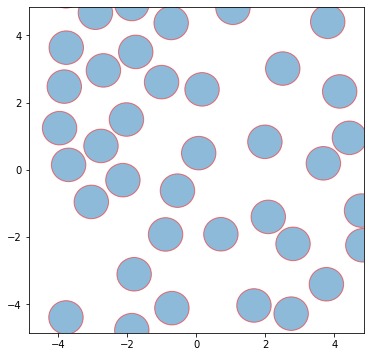

In [17]:
snap = system.take_snapshot()
pts = snap.particles.position[:]
plot_config_wrap(pts[:,:2],L=system.box.Lx)

In [19]:
import gsd.hoomd
f = gsd.hoomd.open(name=f'trajectory_{N}_{phi:.3f}.gsd', mode='rb')
# permute indistinguishable particles to minimize RMSD wrt reference structure
from deep_boltzmann.sampling.permutation import HungarianMapper
mapper = HungarianMapper(xref=f[1].particles.position[:,:2].reshape(1,-1),
                         identical_particles=np.arange(len(f[1].particles.position)))


In [20]:
Xpos = np.zeros((len(f), len(f[0].particles.position[:,:2].flatten())))
for idx, fi in enumerate(f):
    if idx % 10000 == 0:
        print(idx)
    Xpos[idx] = fi.particles.position[:,:2].flatten()

0
10000
20000
30000
40000
50000
60000
70000
80000
90000
100000
110000
120000
130000
140000
150000
160000
170000
180000
190000
200000
210000
220000
230000
240000
250000
260000
270000
280000
290000


In [21]:
import time
Xtrain = np.zeros((len(f), len(f[0].particles.position[:,:2].flatten())))

t1 = time.time()
for i in range(0, len(f)):
    if i % 5000 == 0:
#         print(i)
        t2 = time.time()
        print(f'{i:6d} Time elapsed = {t2-t1} s')
    Xpos_this = Xpos[i]
    Xtrain[i] = mapper.map(Xpos_this)
# %timeit Xtrain[0] = mapper.map(f[0].particles.position[:,:2].flatten())

     0 Time elapsed = 8.749961853027344e-05 s
  5000 Time elapsed = 0.888970136642456 s
 10000 Time elapsed = 1.7794859409332275 s
 15000 Time elapsed = 2.662263870239258 s
 20000 Time elapsed = 3.5577375888824463 s
 25000 Time elapsed = 4.448382139205933 s
 30000 Time elapsed = 5.338899850845337 s
 35000 Time elapsed = 6.214142084121704 s
 40000 Time elapsed = 7.0991737842559814 s
 45000 Time elapsed = 7.976944446563721 s
 50000 Time elapsed = 8.859298944473267 s
 55000 Time elapsed = 9.762845277786255 s
 60000 Time elapsed = 10.661128759384155 s
 65000 Time elapsed = 11.542638063430786 s
 70000 Time elapsed = 12.422864198684692 s
 75000 Time elapsed = 13.299895286560059 s
 80000 Time elapsed = 14.191446542739868 s
 85000 Time elapsed = 15.088172435760498 s
 90000 Time elapsed = 15.97937822341919 s
 95000 Time elapsed = 16.867559909820557 s
100000 Time elapsed = 17.759880542755127 s
105000 Time elapsed = 18.64967370033264 s
110000 Time elapsed = 19.532625675201416 s
115000 Time elapse

In [22]:
import pickle
with open(f'trajectory_{N}_{phi:.3f}.pkl', mode='wb') as f:
    pickle.dump(Xtrain, f)

In [171]:
import pickle
with open(f'trajectory_{N}_{phi:.3f}.pkl', mode='rb') as f:
    Xtrain = pickle.load(f)

In [172]:
# # Generate fake configurations for train_z
# num_frames = 500
# side = int(np.sqrt(N))
# Xtrain = np.zeros((num_frames,N*2))
# for h in np.arange(num_frames):
#     for idx, i in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
#         for idy, j in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
#             Xtrain[h,idx*side*2+idy*2] = i
#             Xtrain[h,idx*side*2+idy*2+1] = j
# # print(Xtrain[0][:10])
# # print(Xtrain[0].reshape(-1,2).shape)
# # plot_config_wrap(model.wrap(Xtrain[0].reshape(-1,2)),L=L,lm=1)

In [142]:
model = HardDisks(N=N,
                  L=L,
                  sigma=sigma,
                  eps=15)

In [143]:
# reset model
#bg = invnet(model.dim, 'LRRRRRRRRRRRR', overlap_model=model, nl_layers=4, nl_hidden=200, #100
bg = invnet(model.dim, 'LRRRRRRRRR', overlap_model=model, nl_layers=3, nl_hidden=200, #200, #100
#            nl_activation='tanh', nl_activation_t='tanh', L=L)
           nl_activation='tanh', nl_activation_t='relu', L=L)

L<RRRRRRRRR>


In [144]:
# bg = OverlapInvNet.load('test1024.model',overlap_model=model)

In [145]:
batchsize = 4096

In [146]:
# hist_bg = bg.train_z(x=Xtrain[::1],epochs=2,lr=0.00001,batch_size=batchsize)

In [147]:
_, sample_x, b, overlap_x, w, logw = bg.sample(nsample=1, temperature=0.1)

[274.63132]


In [148]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=10,lr=0.0003,verbose=True)

Epoch 1/10
293/293 [==============================] - 6s 11ms/step - loss: -87.3002
Epoch 2/10
293/293 [==============================] - 3s 11ms/step - loss: -115.2167
Epoch 3/10
293/293 [==============================] - 3s 10ms/step - loss: -117.0478
Epoch 4/10
293/293 [==============================] - 3s 10ms/step - loss: -117.8422
Epoch 5/10
293/293 [==============================] - 3s 10ms/step - loss: -118.8537
Epoch 6/10
293/293 [==============================] - 3s 10ms/step - loss: -118.6164
Epoch 7/10
293/293 [==============================] - 3s 11ms/step - loss: -119.9652
Epoch 8/10
293/293 [==============================] - 3s 11ms/step - loss: -119.5885
Epoch 9/10
293/293 [==============================] - 3s 11ms/step - loss: -119.8717
Epoch 10/10
293/293 [==============================] - 3s 10ms/step - loss: -120.3318


In [149]:
# hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.0001,batch_size=100,verbose=False)

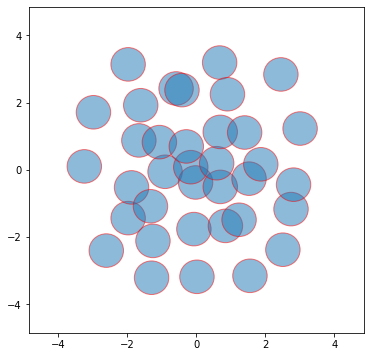

In [150]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)
# plot_config_wrap(model.wrap(np.mean(Xtrain.reshape(len(Xtrain),-1,2),axis=0)),L=L)

In [151]:
hist_bg = bg.train_x(batches=100,epochs=12,lr=0.0001,batch_size=batchsize)
hist_bg = bg.train_x(batches=100,epochs=10,lr=0.001,batch_size=batchsize)


Epoch 1/12
100/100 [==============================] - 5s 19ms/step - loss: 208.0744
Epoch 2/12
100/100 [==============================] - 2s 18ms/step - loss: 202.7421
Epoch 3/12
100/100 [==============================] - 2s 19ms/step - loss: 202.3804
Epoch 4/12
100/100 [==============================] - 2s 19ms/step - loss: 202.0880
Epoch 5/12
100/100 [==============================] - 2s 19ms/step - loss: 201.7406
Epoch 6/12
100/100 [==============================] - 2s 19ms/step - loss: 201.2271
Epoch 7/12
100/100 [==============================] - 2s 19ms/step - loss: 200.2822
Epoch 8/12
100/100 [==============================] - 2s 19ms/step - loss: 200.8002
Epoch 9/12
100/100 [==============================] - 2s 19ms/step - loss: 200.9664
Epoch 10/12
100/100 [==============================] - 2s 19ms/step - loss: 200.5623
Epoch 11/12
100/100 [==============================] - 2s 19ms/step - loss: 199.9173
Epoch 12/12
100/100 [==============================] - 2s 19ms/step - loss

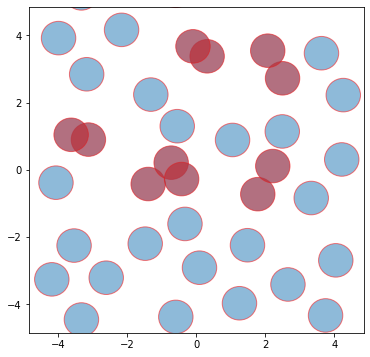

In [152]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

In [153]:
hist_bg = bg.train_both(x=Xtrain[::1],epochs=10,lr=0.0003,batch_size=batchsize)

Epoch 1/10
74/74 [==============================] - 8s 35ms/step - loss: 381.0506
Epoch 2/10
74/74 [==============================] - 3s 35ms/step - loss: 121.2883
Epoch 3/10
74/74 [==============================] - 3s 35ms/step - loss: 108.8792
Epoch 4/10
74/74 [==============================] - 3s 35ms/step - loss: 103.2071
Epoch 5/10
74/74 [==============================] - 3s 35ms/step - loss: 101.5781
Epoch 6/10
74/74 [==============================] - 3s 35ms/step - loss: 99.6478
Epoch 7/10
74/74 [==============================] - 3s 35ms/step - loss: 97.2183
Epoch 8/10
74/74 [==============================] - 3s 35ms/step - loss: 96.9629
Epoch 9/10
74/74 [==============================] - 3s 35ms/step - loss: 95.2565
Epoch 10/10
74/74 [==============================] - 3s 35ms/step - loss: 94.3162


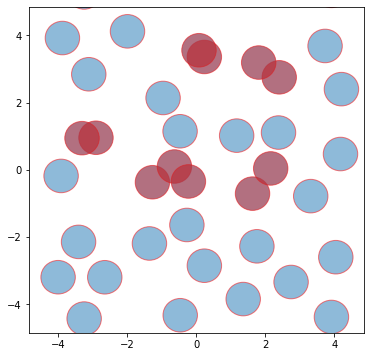

In [154]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

In [155]:
# hist_bg = bg.train_x(batches=100,epochs=30,lr=0.001,batch_size=batchsize)
# plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)

In [156]:
_, sample_x, b, overlap_x, w, logw = bg.sample(nsample=10000, temperature=1)

[150.27419    11.207051   20.589043  ...  13.332049    2.2273903
  14.20295  ]


In [157]:
np.sum(overlap_x == 0) / len(overlap_x)

0.0254

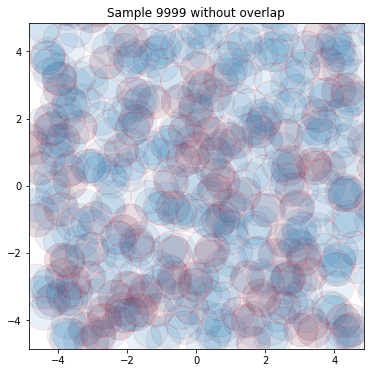

In [158]:
plotted = 0
for ii in np.linspace(0, len(sample_x)-1, num=15, dtype=int):
    if plotted == 0:
        fig, ax = plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=True,color_overlapper=True)
    else:
        plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=False, fig=fig, ax=ax,color_overlapper=True)
    plotted += 1

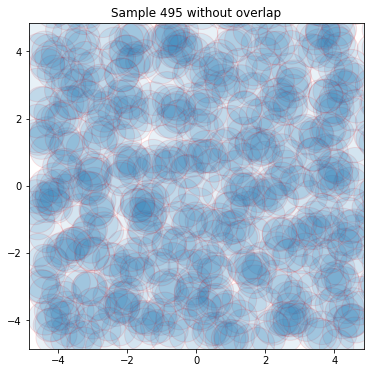

In [161]:
plot_at_most = 19
sts = (len(sample_x)//plot_at_most)
plotted = 0
zero_overlap_ones = np.where(model.smooth_overlap_tf(sample_x).numpy() == 0)[0]
for ii in zero_overlap_ones:
    if model.smooth_overlap_tf(sample_x[i:i+1]) == 0:
        if plotted == 0:
            fig, ax = plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=True,color_overlapper=True)
        else:
            plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=False, fig=fig, ax=ax,color_overlapper=True)
        plotted += 1
    if plotted > plot_at_most:
        break

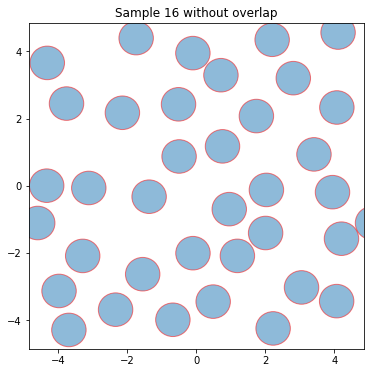

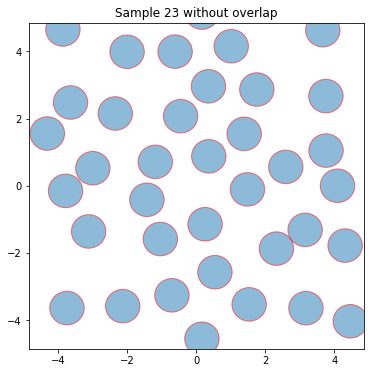

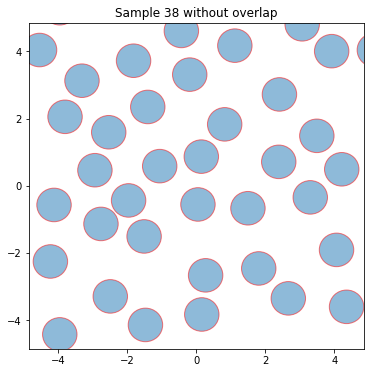

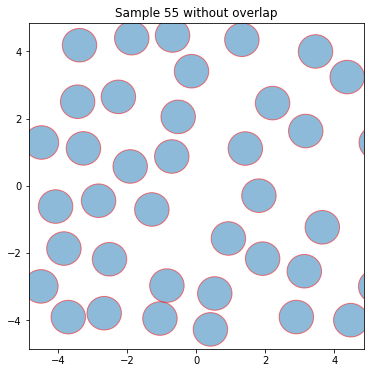

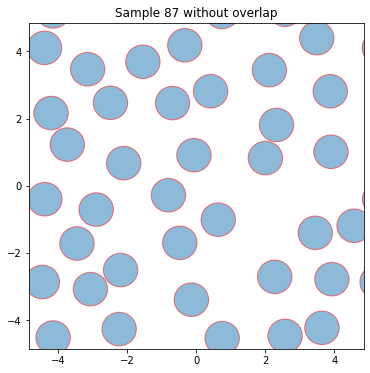

...

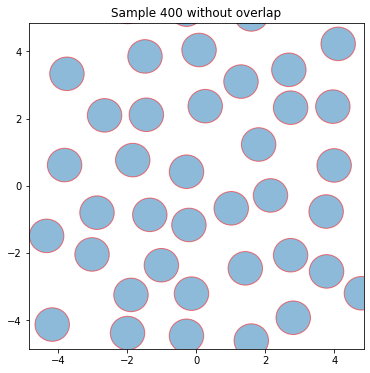

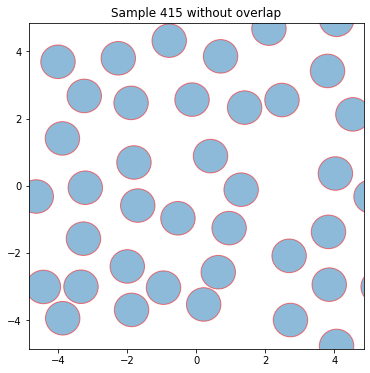

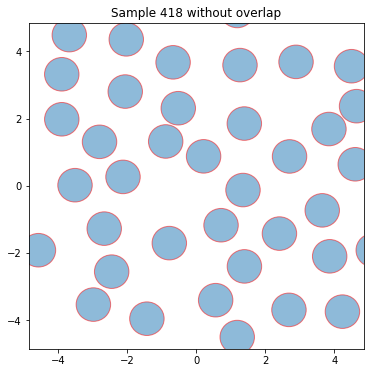

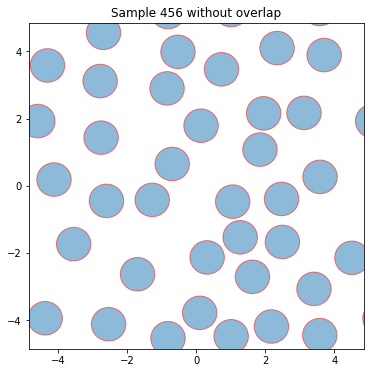

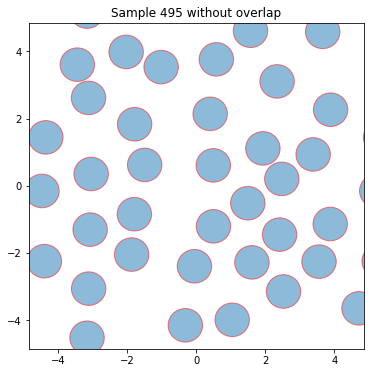

In [160]:
plot_at_most = 19
sts = (len(sample_x)//plot_at_most)
plotted = 0
zero_overlap_ones = np.where(model.smooth_overlap_tf(sample_x).numpy() == 0)[0]
for i in zero_overlap_ones:
    if model.smooth_overlap_tf(sample_x[i:i+1]) == 0:
        plot_config_wrap(model.wrap(sample_x)[i:i+1].reshape(-1,2),L=L, title=f'Sample {i} without overlap')
        plotted += 1
    if plotted > plot_at_most:
        break

### Train phi = .3, N = 36 without Hungarian mapper

In [87]:
# Xtrain = np.load('Xtrain_1024_706_10k.npy')
phi = 0.3 # packing fraction
sigma = 1
N = 36
L = (N*(np.pi*0.25*sigma**2)/phi)**0.5
a = L/np.sqrt(N)

#### Now instead of generating fake trajectories, generate real MC

In [162]:
hoomd.context.initialize('')
box = hoomd.data.boxdim(L=L,dimensions=2)
snap = hoomd.data.make_snapshot(N=N,particle_types=['A'],box=box)

snap.particles.position[:] = [(i,j,0) for i in np.arange(-L/2,L/2,a) for j in np.arange(-L/2,L/2,a)]
system = hoomd.init.read_snapshot(snap)
mc = hpmc.integrate.sphere(seed=123)
mc.shape_param.set('A',diameter=sigma)
gsd = hoomd.dump.gsd(f'trajectory_{N}_{phi:.3f}.gsd',period=10,group=hoomd.group.all(),overwrite=True)
mc.set_params(d=0.05)
hoomd.run(3000000)

notice(2): Group "all" created containing 36 particles
** starting run **
Time 00:00:10 | Step 46174 / 3000000 | TPS 4617.3 | ETA 00:10:39
Time 00:00:20 | Step 92566 / 3000000 | TPS 4639.18 | ETA 00:10:26
Time 00:00:30 | Step 139029 / 3000000 | TPS 4646.27 | ETA 00:10:15
Time 00:00:40 | Step 185455 / 3000000 | TPS 4642.59 | ETA 00:10:06
Time 00:00:50 | Step 231877 / 3000000 | TPS 4642.17 | ETA 00:09:56
Time 00:01:00 | Step 278395 / 3000000 | TPS 4651.72 | ETA 00:09:45
Time 00:01:10 | Step 325014 / 3000000 | TPS 4661.86 | ETA 00:09:33
Time 00:01:20 | Step 371715 / 3000000 | TPS 4670.01 | ETA 00:09:22
Time 00:01:30 | Step 417343 / 3000000 | TPS 4562.8 | ETA 00:09:26
Time 00:01:40 | Step 464945 / 3000000 | TPS 4760.13 | ETA 00:08:52
Time 00:01:50 | Step 512400 / 3000000 | TPS 4745.41 | ETA 00:08:44
Time 00:02:00 | Step 559831 / 3000000 | TPS 4743.07 | ETA 00:08:34
Time 00:02:10 | Step 605919 / 3000000 | TPS 4608.79 | ETA 00:08:39
Time 00:02:20 | Step 653257 / 3000000 | TPS 4733.77 | ETA 0

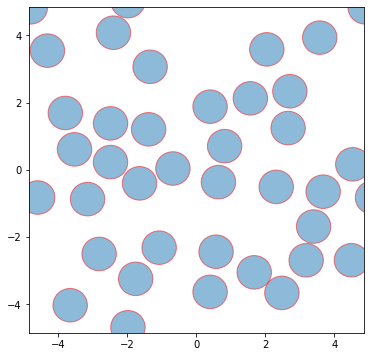

In [163]:
snap = system.take_snapshot()
pts = snap.particles.position[:]
plot_config_wrap(pts[:,:2],L=system.box.Lx)

In [259]:
import gsd.hoomd
f = gsd.hoomd.open(name=f'trajectory_{N}_{phi:.3f}.gsd', mode='rb')
# permute indistinguishable particles to minimize RMSD wrt reference structure
from deep_boltzmann.sampling.permutation import HungarianMapper
mapper = HungarianMapper(xref=f[1].particles.position[:,:2].reshape(1,-1),
                         identical_particles=np.arange(len(f[1].particles.position)))


In [260]:
Xpos = np.zeros((len(f), len(f[0].particles.position[:,:2].flatten())))
for idx, fi in enumerate(f):
    if idx % 10000 == 0:
        print(idx)
    Xpos[idx] = fi.particles.position[:,:2].flatten()
Xtrain = Xpos

0
10000
20000
30000
40000
50000
60000
70000
80000
90000
100000
110000
120000
130000
140000
150000
160000
170000
180000
190000
200000
210000
220000
230000
240000
250000
260000
270000
280000
290000


In [112]:
model = HardDisks(N=N,
                  L=L,
                  sigma=sigma,
                  eps=15)

In [113]:
# reset model
#bg = invnet(model.dim, 'LRRRRRRRRRRRR', overlap_model=model, nl_layers=4, nl_hidden=200, #100
bg = invnet(model.dim, 'LRRRRRRRRR', overlap_model=model, nl_layers=3, nl_hidden=200, #200, #100
#            nl_activation='tanh', nl_activation_t='tanh', L=L)
           nl_activation='tanh', nl_activation_t='relu', L=L)

L<RRRRRRRRR>


In [114]:
# bg = OverlapInvNet.load('test1024.model',overlap_model=model)

In [115]:
batchsize = 4096

In [116]:
# hist_bg = bg.train_z(x=Xtrain[::1],epochs=2,lr=0.00001,batch_size=batchsize)

In [117]:
_, sample_x, b, overlap_x, w, logw = bg.sample(nsample=1, temperature=0.1)

[476.58636]


In [118]:
hist_bg = bg.train_z(x=Xpos[::1],epochs=10,lr=0.0003,verbose=True)

Epoch 1/10
293/293 [==============================] - 6s 10ms/step - loss: -6.3511
Epoch 2/10
293/293 [==============================] - 3s 10ms/step - loss: -18.2968
Epoch 3/10
293/293 [==============================] - 3s 11ms/step - loss: -22.9473
Epoch 4/10
293/293 [==============================] - 3s 10ms/step - loss: -27.9073
Epoch 5/10
293/293 [==============================] - 3s 10ms/step - loss: -32.3539
Epoch 6/10
293/293 [==============================] - 3s 10ms/step - loss: -37.2509
Epoch 7/10
293/293 [==============================] - 3s 10ms/step - loss: -41.2871
Epoch 8/10
293/293 [==============================] - 3s 11ms/step - loss: -43.3450
Epoch 9/10
293/293 [==============================] - 3s 11ms/step - loss: -45.2257
Epoch 10/10
293/293 [==============================] - 3s 10ms/step - loss: -47.9498


In [119]:
hist_bg = bg.train_z(x=Xpos[::1],epochs=10,lr=0.001,verbose=True) # Use unsorted 

Epoch 1/10
293/293 [==============================] - 7s 11ms/step - loss: -45.9158
Epoch 2/10
293/293 [==============================] - 3s 10ms/step - loss: -49.6796
Epoch 3/10
293/293 [==============================] - 3s 10ms/step - loss: -52.0279
Epoch 4/10
293/293 [==============================] - 3s 11ms/step - loss: -54.2818
Epoch 5/10
293/293 [==============================] - 3s 10ms/step - loss: -55.9323
Epoch 6/10
293/293 [==============================] - 3s 10ms/step - loss: -57.0037
Epoch 7/10
293/293 [==============================] - 3s 10ms/step - loss: -59.2186
Epoch 8/10
293/293 [==============================] - 3s 10ms/step - loss: -59.6872
Epoch 9/10
293/293 [==============================] - 3s 11ms/step - loss: -61.7841
Epoch 10/10
293/293 [==============================] - 3s 11ms/step - loss: -62.7290


In [120]:
# hist_bg = bg.train_z(x=Xpos[::1],epochs=30,lr=0.001,verbose=True) # Use unsorted 

In [121]:
# hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.0001,batch_size=100,verbose=False)

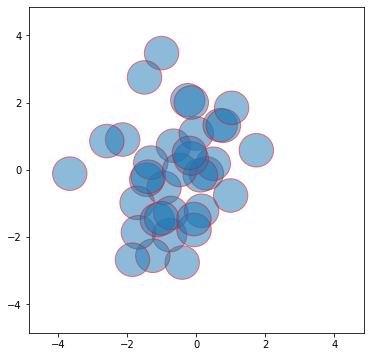

In [122]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)
# plot_config_wrap(model.wrap(np.mean(Xtrain.reshape(len(Xtrain),-1,2),axis=0)),L=L)

In [123]:
hist_bg = bg.train_x(batches=100,epochs=12,lr=0.0001,batch_size=batchsize)
hist_bg = bg.train_x(batches=100,epochs=10,lr=0.0005,batch_size=batchsize) # It dies here if using unmapped examples with lr = 0.001
hist_bg = bg.train_x(batches=100,epochs=10,lr=0.001,batch_size=batchsize)

Epoch 1/12
100/100 [==============================] - 5s 19ms/step - loss: 304.6327
Epoch 2/12
100/100 [==============================] - 2s 19ms/step - loss: 293.1294
Epoch 3/12
100/100 [==============================] - 2s 19ms/step - loss: 287.4566
Epoch 4/12
100/100 [==============================] - 2s 19ms/step - loss: 289.7555
Epoch 5/12
100/100 [==============================] - 2s 19ms/step - loss: 284.8532
Epoch 6/12
100/100 [==============================] - 2s 19ms/step - loss: 283.9103
Epoch 7/12
100/100 [==============================] - 2s 19ms/step - loss: 280.8217
Epoch 8/12
100/100 [==============================] - 2s 18ms/step - loss: 281.1240
Epoch 9/12
100/100 [==============================] - 2s 18ms/step - loss: 278.9052
Epoch 10/12
100/100 [==============================] - 2s 18ms/step - loss: 276.4887
Epoch 11/12
100/100 [==============================] - 2s 18ms/step - loss: 275.6120
Epoch 12/12
100/100 [==============================] - 2s 18ms/step - loss

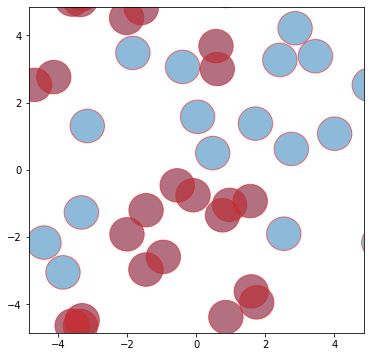

In [124]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

In [133]:
hist_bg = bg.train_both(x=Xtrain[::1],epochs=20,lr=0.0003,batch_size=batchsize)

Epoch 1/10
74/74 [==============================] - 8s 35ms/step - loss: 169.6142
Epoch 2/10
74/74 [==============================] - 3s 35ms/step - loss: 168.6170
Epoch 3/10
74/74 [==============================] - 3s 35ms/step - loss: 166.7079
Epoch 4/10
74/74 [==============================] - 3s 35ms/step - loss: 167.3078
Epoch 5/10
74/74 [==============================] - 3s 35ms/step - loss: 164.1963
Epoch 6/10
74/74 [==============================] - 3s 35ms/step - loss: 162.3792
Epoch 7/10
74/74 [==============================] - 3s 35ms/step - loss: 163.5755
Epoch 8/10
74/74 [==============================] - 3s 35ms/step - loss: 162.7304
Epoch 9/10
74/74 [==============================] - 3s 35ms/step - loss: 158.7471
Epoch 10/10
74/74 [==============================] - 3s 35ms/step - loss: 156.3096


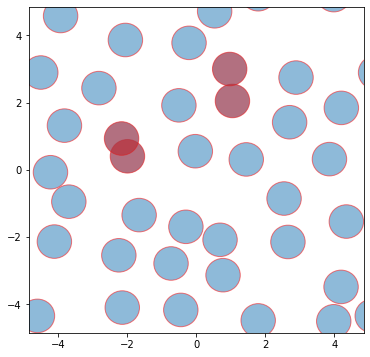

In [134]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

In [135]:
# hist_bg = bg.train_x(batches=100,epochs=30,lr=0.001,batch_size=batchsize)
# plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)

In [136]:
_, sample_x, b, overlap_x, w, logw = bg.sample(nsample=10000, temperature=1)

[240.34561  262.3937   123.0765   ... 146.92506  337.65955   15.084202]


In [137]:
np.sum(overlap_x == 0) / len(overlap_x)

0.0045

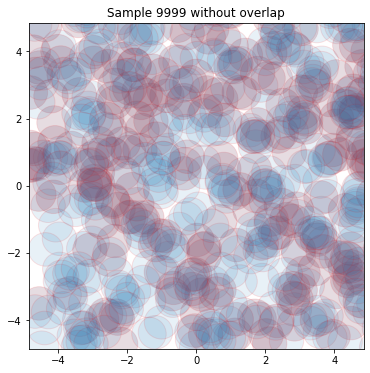

In [138]:
plotted = 0
for ii in np.linspace(0, len(sample_x)-1, num=15, dtype=int):
    if plotted == 0:
        fig, ax = plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=True,color_overlapper=True)
    else:
        plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=False, fig=fig, ax=ax,color_overlapper=True)
    plotted += 1

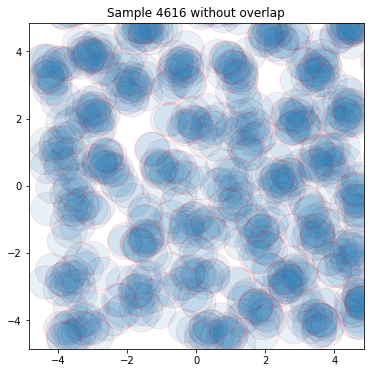

In [141]:
plot_at_most = 19
sts = (len(sample_x)//plot_at_most)
plotted = 0
zero_overlap_ones = np.where(model.smooth_overlap_tf(sample_x).numpy() == 0)[0]
for ii in zero_overlap_ones:
    if model.smooth_overlap_tf(sample_x[i:i+1]) == 0:
        if plotted == 0:
            fig, ax = plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=True,color_overlapper=True)
        else:
            plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=False, fig=fig, ax=ax,color_overlapper=True)
        plotted += 1
    if plotted > plot_at_most:
        break

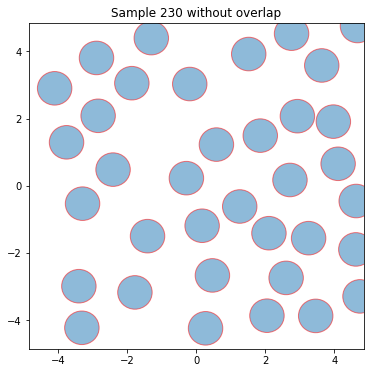

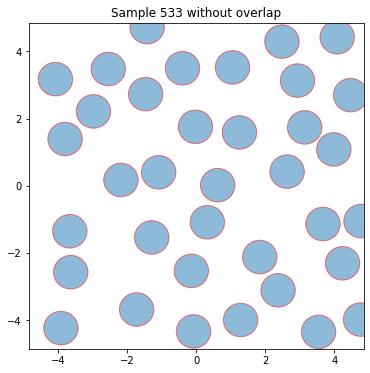

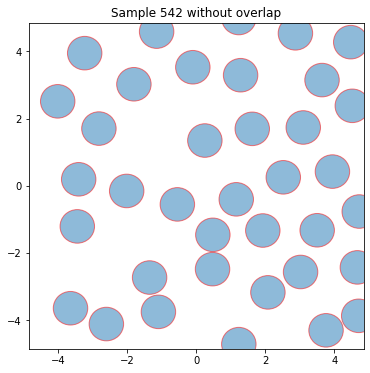

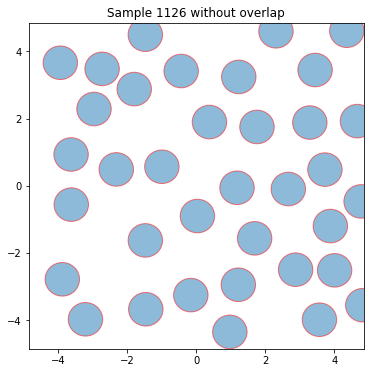

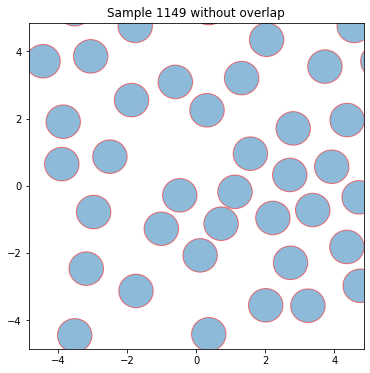

...

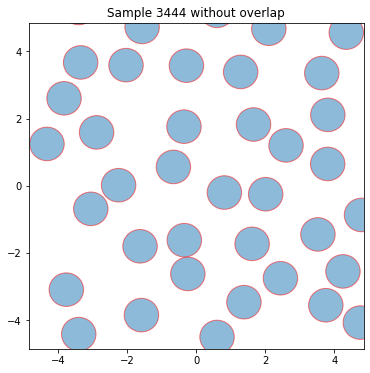

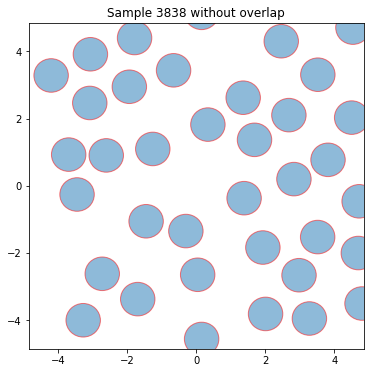

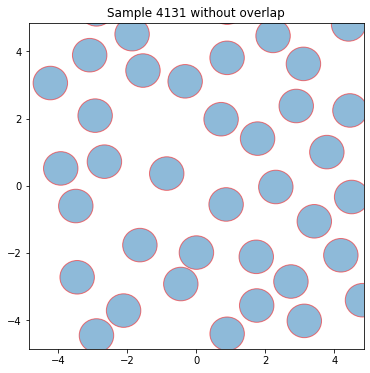

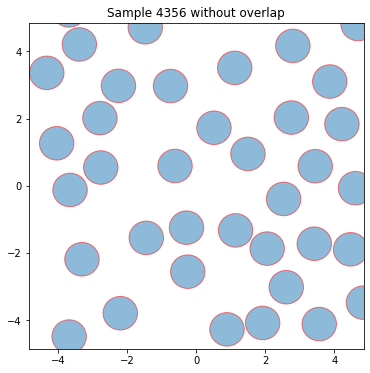

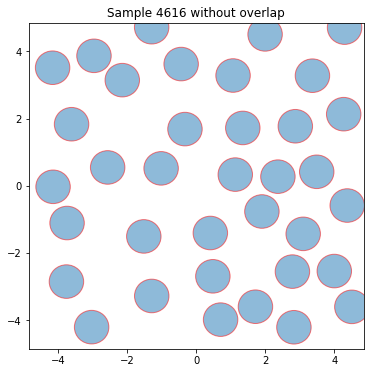

In [140]:
plot_at_most = 19
sts = (len(sample_x)//plot_at_most)
plotted = 0
zero_overlap_ones = np.where(model.smooth_overlap_tf(sample_x).numpy() == 0)[0]
for i in zero_overlap_ones:
    if model.smooth_overlap_tf(sample_x[i:i+1]) == 0:
        plot_config_wrap(model.wrap(sample_x)[i:i+1].reshape(-1,2),L=L, title=f'Sample {i} without overlap')
        plotted += 1
    if plotted > plot_at_most:
        break

### Train phi = .3, N = 36 with only train_x

In [148]:
# Xtrain = np.load('Xtrain_1024_706_10k.npy')
phi = 0.3 # packing fraction
sigma = 1
N = 36
L = (N*(np.pi*0.25*sigma**2)/phi)**0.5
a = L/np.sqrt(N)

In [149]:
# Generate fake configurations for train_z
num_frames = 4096
side = int(np.sqrt(N))
Xtrain = np.zeros((num_frames,N*2))
for h in np.arange(num_frames):
    for idx, i in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
        for idy, j in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
            Xtrain[h,idx*side*2+idy*2] = i
            Xtrain[h,idx*side*2+idy*2+1] = j
# print(Xtrain[0][:10])
# print(Xtrain[0].reshape(-1,2).shape)
# plot_config_wrap(model.wrap(Xtrain[0].reshape(-1,2)),L=L,lm=1)

In [150]:
model = HardDisks(N=N,
                  L=L,
                  sigma=sigma,
                  eps=15)

In [151]:
# reset model
#bg = invnet(model.dim, 'LRRRRRRRRRRRR', overlap_model=model, nl_layers=4, nl_hidden=200, #100
bg = invnet(model.dim, 'LRRRRRRRRR', overlap_model=model, nl_layers=3, nl_hidden=200, #200, #100
#            nl_activation='tanh', nl_activation_t='tanh', L=L)
           nl_activation='tanh', nl_activation_t='relu', L=L)

L<RRRRRRRRR>


In [152]:
# bg = OverlapInvNet.load('test1024.model',overlap_model=model)

In [153]:
batchsize = 4096

In [154]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.0001,batch_size=batchsize)

Epoch 1/50
1/1 [==============================] - 3s 3s/step - loss: 36.5086
Epoch 2/50
1/1 [==============================] - 0s 16ms/step - loss: 13.8214
Epoch 3/50
1/1 [==============================] - 0s 16ms/step - loss: 0.3760
Epoch 4/50
1/1 [==============================] - 0s 16ms/step - loss: -7.9175
Epoch 5/50
1/1 [==============================] - 0s 16ms/step - loss: -13.6183
Epoch 6/50
1/1 [==============================] - 0s 16ms/step - loss: -18.1890
Epoch 7/50
1/1 [==============================] - 0s 16ms/step - loss: -22.2328
Epoch 8/50
1/1 [==============================] - 0s 16ms/step - loss: -25.9637
Epoch 9/50
1/1 [==============================] - 0s 16ms/step - loss: -29.4435
Epoch 10/50
1/1 [==============================] - 0s 16ms/step - loss: -32.6951
Epoch 11/50
1/1 [==============================] - 0s 16ms/step - loss: -35.7773
Epoch 12/50
1/1 [==============================] - 0s 16ms/step - loss: -38.8239
Epoch 13/50
1/1 [===========================

In [155]:
_, sample_x, b, overlap_x, w, logw = bg.sample(nsample=1, temperature=0.1)

[674.85876]


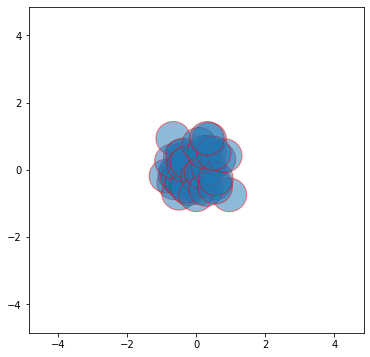

In [156]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)
# plot_config_wrap(model.wrap(np.mean(Xtrain.reshape(len(Xtrain),-1,2),axis=0)),L=L)

In [157]:
hist_bg = bg.train_x(batches=100,epochs=12,lr=0.0001,batch_size=batchsize)
hist_bg = bg.train_x(batches=100,epochs=10,lr=0.001,batch_size=batchsize)


Epoch 1/12
100/100 [==============================] - 5s 18ms/step - loss: 316.5241
Epoch 2/12
100/100 [==============================] - 2s 18ms/step - loss: 244.8193
Epoch 3/12
100/100 [==============================] - 2s 18ms/step - loss: 222.5031
Epoch 4/12
100/100 [==============================] - 2s 18ms/step - loss: 218.2534
Epoch 5/12
100/100 [==============================] - 2s 18ms/step - loss: 215.8101
Epoch 6/12
100/100 [==============================] - 2s 18ms/step - loss: 214.5234
Epoch 7/12
100/100 [==============================] - 2s 18ms/step - loss: 212.5562
Epoch 8/12
100/100 [==============================] - 2s 18ms/step - loss: 212.0977
Epoch 9/12
100/100 [==============================] - 2s 18ms/step - loss: 211.8060
Epoch 10/12
100/100 [==============================] - 2s 18ms/step - loss: 211.0046
Epoch 11/12
100/100 [==============================] - 2s 18ms/step - loss: 210.2121
Epoch 12/12
100/100 [==============================] - 2s 18ms/step - loss

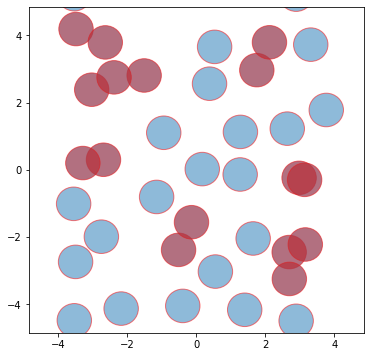

In [158]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

Epoch 1/30
100/100 [==============================] - 5s 18ms/step - loss: 226.1655
Epoch 2/30
100/100 [==============================] - 2s 18ms/step - loss: 207.3817
Epoch 3/30
100/100 [==============================] - 2s 18ms/step - loss: 206.8627
Epoch 4/30
100/100 [==============================] - 2s 18ms/step - loss: 206.5640
Epoch 5/30
100/100 [==============================] - 2s 18ms/step - loss: 206.1390
Epoch 6/30
100/100 [==============================] - 2s 18ms/step - loss: 205.9790
Epoch 7/30
100/100 [==============================] - 2s 18ms/step - loss: 205.2384
Epoch 8/30
100/100 [==============================] - 2s 18ms/step - loss: 205.0341
Epoch 9/30
100/100 [==============================] - 2s 18ms/step - loss: 204.1509
Epoch 10/30
100/100 [==============================] - 2s 18ms/step - loss: 205.1967
Epoch 11/30
100/100 [==============================] - 2s 18ms/step - loss: 204.3986
Epoch 12/30
100/100 [==============================] - 2s 18ms/step - loss

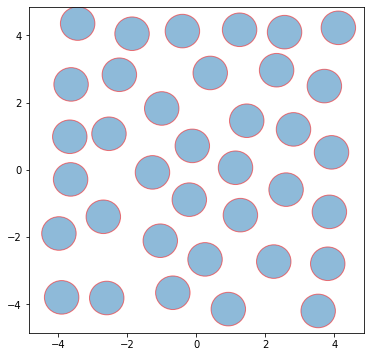

In [159]:
hist_bg = bg.train_x(batches=100,epochs=30,lr=0.001,batch_size=batchsize)
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)

In [165]:
_, sample_x, b, overlap_x, w, logw = bg.sample(nsample=10000, temperature=1)

[12.2830105  8.686005  14.5019245 ... 13.904781  17.329855   0.6295413]


In [166]:
np.sum(overlap_x == 0) / len(overlap_x)

0.0256

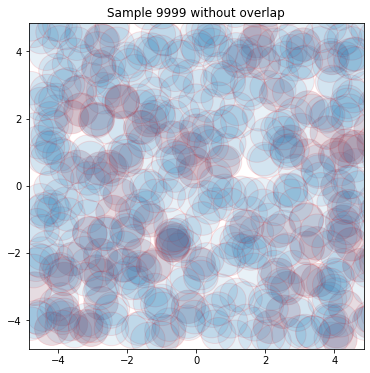

In [167]:
plotted = 0
for ii in np.linspace(0, len(sample_x)-1, num=15, dtype=int):
    if plotted == 0:
        fig, ax = plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=True,color_overlapper=True)
    else:
        plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=False, fig=fig, ax=ax,color_overlapper=True)
    plotted += 1

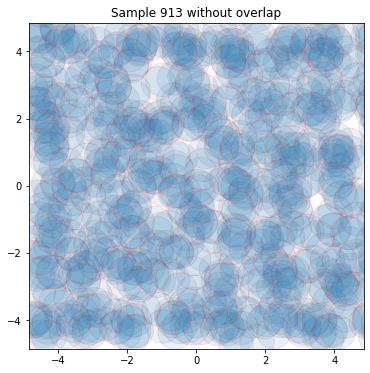

In [168]:
plot_at_most = 19
sts = (len(sample_x)//plot_at_most)
plotted = 0
zero_overlap_ones = np.where(model.smooth_overlap_tf(sample_x).numpy() == 0)[0]
for ii in zero_overlap_ones:
    if model.smooth_overlap_tf(sample_x[ii:ii+1]) == 0:
        if plotted == 0:
            fig, ax = plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=True,color_overlapper=True)
        else:
            plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=False, fig=fig, ax=ax,color_overlapper=True)
        plotted += 1
    if plotted > plot_at_most:
        break

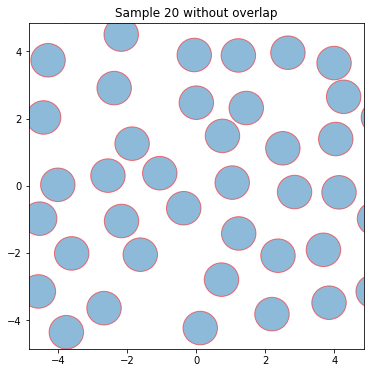

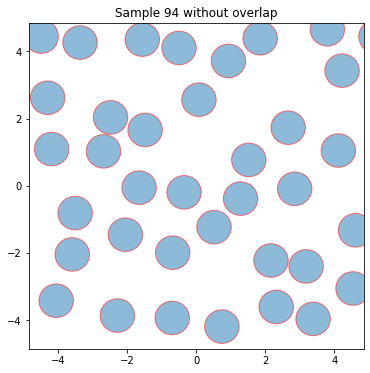

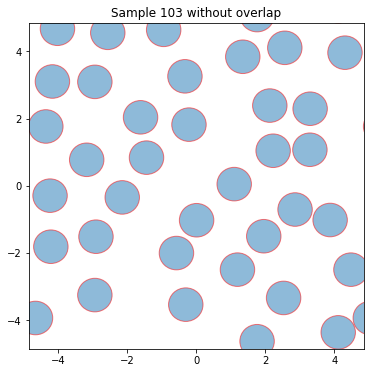

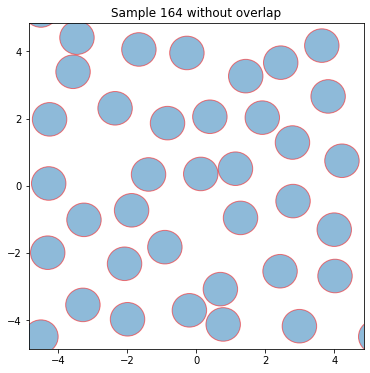

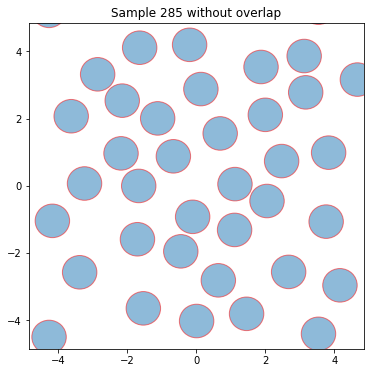

...

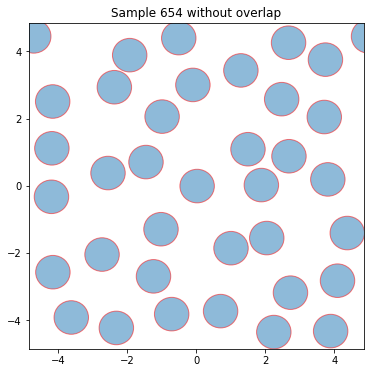

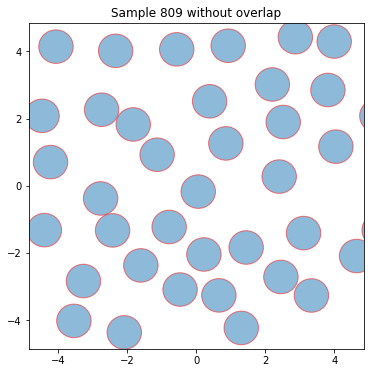

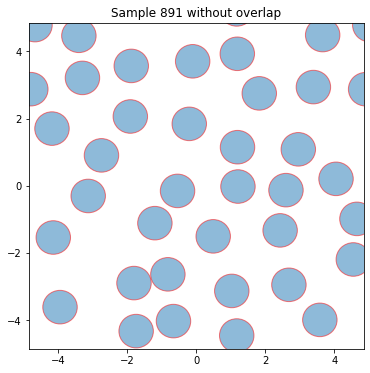

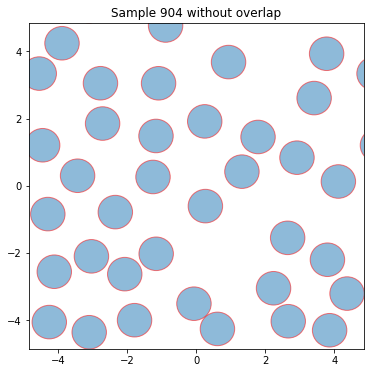

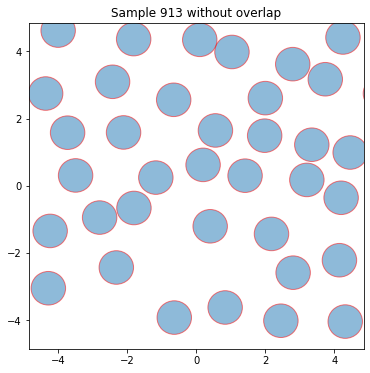

In [169]:
plot_at_most = 19
sts = (len(sample_x)//plot_at_most)
plotted = 0
zero_overlap_ones = np.where(model.smooth_overlap_tf(sample_x).numpy() == 0)[0]
for i in zero_overlap_ones:
    if model.smooth_overlap_tf(sample_x[i:i+1]) == 0:
        plot_config_wrap(model.wrap(sample_x)[i:i+1].reshape(-1,2),L=L, title=f'Sample {i} without overlap')
        plotted += 1
    if plotted > plot_at_most:
        break

### Train phi = .7, N = 36

In [192]:
# Xtrain = np.load('Xtrain_1024_706_10k.npy')
phi = 0.7 # packing fraction
sigma = 1
N = 36
L = (N*(np.pi*0.25*sigma**2)/phi)**0.5
a = L/np.sqrt(N)

#### Now instead of generating fake trajectories, generate real MC

In [193]:
hoomd.context.initialize('')
box = hoomd.data.boxdim(L=L,dimensions=2)
snap = hoomd.data.make_snapshot(N=N,particle_types=['A'],box=box)

snap.particles.position[:] = [(i,j,0) for i in np.arange(-L/2,L/2,a) for j in np.arange(-L/2,L/2,a)]
system = hoomd.init.read_snapshot(snap)
mc = hpmc.integrate.sphere(seed=123)
mc.shape_param.set('A',diameter=sigma)
gsd = hoomd.dump.gsd(f'trajectory_{N}_{phi:.3f}.gsd',period=10,group=hoomd.group.all(),overwrite=True)
mc.set_params(d=0.05)
hoomd.run(1000000)

HOOMD-blue 2.9.6 CUDA (11.0) DOUBLE HPMC_MIXED TBB SSE SSE2 SSE3 
Compiled: 03/17/2021
Copyright (c) 2009-2019 The Regents of the University of Michigan.
-----
You are using HOOMD-blue. Please cite the following:
* J A Anderson, J Glaser, and S C Glotzer. "HOOMD-blue: A Python package for
  high-performance molecular dynamics and hard particle Monte Carlo
  simulations", Computational Materials Science 173 (2020) 109363
-----
-----
You are using HPMC. Please cite the following:
* J A Anderson, M E Irrgang, and S C Glotzer. "Scalable Metropolis Monte Carlo
  for simulation of hard shapes", Computer Physics Communications 204 (2016) 21
  --30
-----
HOOMD-blue is running on the following GPU(s):
 [0]  Tesla V100-PCIE-16GB  80 SM_7.0 @ 1.38 GHz, 16160 MiB DRAM, MNG
notice(2): Setting number of TBB threads to value of OMP_NUM_THREADS=12
notice(2): Group "all" created containing 36 particles
** starting run **
Time 00:00:10 | Step 42814 / 1000000 | TPS 4281.37 | ETA 00:03:43
Time 00:00:20 | 

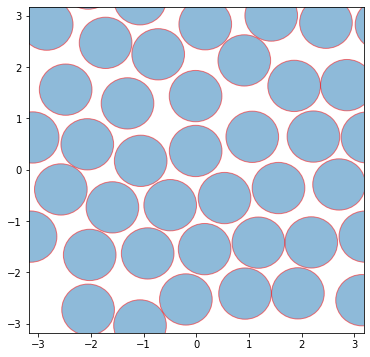

In [194]:
snap = system.take_snapshot()
pts = snap.particles.position[:]
plot_config_wrap(pts[:,:2],L=system.box.Lx)

In [195]:
import gsd.hoomd
f = gsd.hoomd.open(name=f'trajectory_{N}_{phi:.3f}.gsd', mode='rb')
# permute indistinguishable particles to minimize RMSD wrt reference structure
from deep_boltzmann.sampling.permutation import HungarianMapper
mapper = HungarianMapper(xref=f[1].particles.position[:,:2].reshape(1,-1),
                         identical_particles=np.arange(len(f[1].particles.position)))


In [196]:
Xpos = np.zeros((len(f), len(f[0].particles.position[:,:2].flatten())))
for idx, fi in enumerate(f):
    if idx % 100000 == 0:
        print(idx)
    Xpos[idx] = fi.particles.position[:,:2].flatten()

0


In [197]:
import time
Xtrain = np.zeros((len(f), len(f[0].particles.position[:,:2].flatten())))

t1 = time.time()
for i in range(0, len(f)):
    if i % 5000 == 0:
#         print(i)
        t2 = time.time()
        print(f'{i:6d} Time elapsed = {t2-t1} s')
    Xpos_this = Xpos[i]
    Xtrain[i] = mapper.map(Xpos_this)
# %timeit Xtrain[0] = mapper.map(f[0].particles.position[:,:2].flatten())

     0 Time elapsed = 8.916854858398438e-05 s
  5000 Time elapsed = 0.8131487369537354 s
 10000 Time elapsed = 1.617112398147583 s
 15000 Time elapsed = 2.4236979484558105 s
 20000 Time elapsed = 3.229574203491211 s
 25000 Time elapsed = 4.0242297649383545 s
 30000 Time elapsed = 4.830287456512451 s
 35000 Time elapsed = 5.639431715011597 s
 40000 Time elapsed = 6.441246032714844 s
 45000 Time elapsed = 7.24581503868103 s
 50000 Time elapsed = 8.051061153411865 s
 55000 Time elapsed = 8.846667528152466 s
 60000 Time elapsed = 9.66952633857727 s
 65000 Time elapsed = 10.473570585250854 s
 70000 Time elapsed = 11.279607057571411 s
 75000 Time elapsed = 12.08374571800232 s
 80000 Time elapsed = 12.890270471572876 s
 85000 Time elapsed = 13.695661067962646 s
 90000 Time elapsed = 14.532562732696533 s
 95000 Time elapsed = 15.336195707321167 s


In [198]:
import pickle
with open(f'trajectory_{N}_{phi:.3f}.pkl', mode='wb') as f:
    pickle.dump(Xtrain, f)

In [171]:
import pickle
with open(f'trajectory_{N}_{phi:.3f}.pkl', mode='rb') as f:
    Xtrain = pickle.load(f)

In [172]:
# # Generate fake configurations for train_z
# num_frames = 500
# side = int(np.sqrt(N))
# Xtrain = np.zeros((num_frames,N*2))
# for h in np.arange(num_frames):
#     for idx, i in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
#         for idy, j in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
#             Xtrain[h,idx*side*2+idy*2] = i
#             Xtrain[h,idx*side*2+idy*2+1] = j
# # print(Xtrain[0][:10])
# # print(Xtrain[0].reshape(-1,2).shape)
# # plot_config_wrap(model.wrap(Xtrain[0].reshape(-1,2)),L=L,lm=1)

In [235]:
model = HardDisks(N=N,
                  L=L,
                  sigma=sigma,
                  eps=15)

In [236]:
# reset model
#bg = invnet(model.dim, 'LRRRRRRRRRRRR', overlap_model=model, nl_layers=4, nl_hidden=200, #100
bg = invnet(model.dim, 'LRRRRRRRRR', overlap_model=model, nl_layers=3, nl_hidden=200, #200, #100
#            nl_activation='tanh', nl_activation_t='tanh', L=L)
           nl_activation='tanh', nl_activation_t='relu', L=L)

L<RRRRRRRRR>


In [237]:
# bg = OverlapInvNet.load('test1024.model',overlap_model=model)

In [238]:
batchsize = 4096

In [239]:
# hist_bg = bg.train_z(x=Xtrain[::1],epochs=2,lr=0.00001,batch_size=batchsize)

In [240]:
_, sample_x, b, overlap_x, w, logw = bg.sample(nsample=1, temperature=0.1)

[927.57666]


In [241]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=10,lr=0.0003,verbose=True)

Epoch 1/10
98/98 [==============================] - 5s 11ms/step - loss: -83.9372
Epoch 2/10
98/98 [==============================] - 1s 11ms/step - loss: -138.4790
Epoch 3/10
98/98 [==============================] - 1s 10ms/step - loss: -146.5834
Epoch 4/10
98/98 [==============================] - 1s 9ms/step - loss: -149.0746
Epoch 5/10
98/98 [==============================] - 1s 10ms/step - loss: -151.2893
Epoch 6/10
98/98 [==============================] - 1s 10ms/step - loss: -152.8488
Epoch 7/10
98/98 [==============================] - 1s 10ms/step - loss: -155.2559
Epoch 8/10
98/98 [==============================] - 1s 10ms/step - loss: -155.2320
Epoch 9/10
98/98 [==============================] - 1s 9ms/step - loss: -156.4844
Epoch 10/10
98/98 [==============================] - 1s 10ms/step - loss: -157.8771


In [242]:
# hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.0001,batch_size=100,verbose=False)

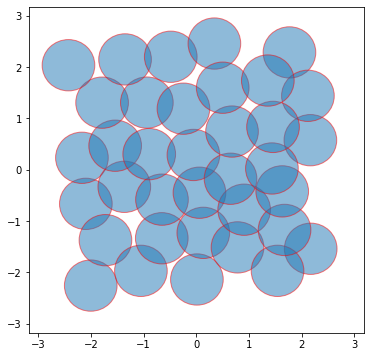

In [243]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)
# plot_config_wrap(model.wrap(np.mean(Xtrain.reshape(len(Xtrain),-1,2),axis=0)),L=L)

In [244]:
hist_bg = bg.train_x(batches=100,epochs=12,lr=0.0001,batch_size=batchsize)
hist_bg = bg.train_x(batches=100,epochs=10,lr=0.001,batch_size=batchsize)


Epoch 1/12
100/100 [==============================] - 4s 18ms/step - loss: 302.7750
Epoch 2/12
100/100 [==============================] - 2s 18ms/step - loss: 284.2508
Epoch 3/12
100/100 [==============================] - 2s 18ms/step - loss: 281.0742
Epoch 4/12
100/100 [==============================] - 2s 18ms/step - loss: 279.9088
Epoch 5/12
100/100 [==============================] - 2s 18ms/step - loss: 278.8899
Epoch 6/12
100/100 [==============================] - 2s 18ms/step - loss: 278.0102
Epoch 7/12
100/100 [==============================] - 2s 18ms/step - loss: 278.4119
Epoch 8/12
100/100 [==============================] - 2s 18ms/step - loss: 278.4138
Epoch 9/12
100/100 [==============================] - 2s 18ms/step - loss: 278.0218
Epoch 10/12
100/100 [==============================] - 2s 18ms/step - loss: 277.3276
Epoch 11/12
100/100 [==============================] - 2s 18ms/step - loss: 277.6188
Epoch 12/12
100/100 [==============================] - 2s 18ms/step - loss

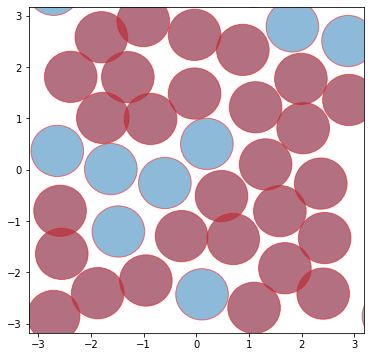

In [245]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

In [246]:
hist_bg = bg.train_both(x=Xtrain[::1],epochs=10,lr=0.0003,batch_size=batchsize)

Epoch 1/10
25/25 [==============================] - 6s 34ms/step - loss: 673.6563
Epoch 2/10
25/25 [==============================] - 1s 34ms/step - loss: 228.2000
Epoch 3/10
25/25 [==============================] - 1s 34ms/step - loss: 190.8512
Epoch 4/10
25/25 [==============================] - 1s 34ms/step - loss: 175.7870
Epoch 5/10
25/25 [==============================] - 1s 34ms/step - loss: 166.9955
Epoch 6/10
25/25 [==============================] - 1s 34ms/step - loss: 157.9617
Epoch 7/10
25/25 [==============================] - 1s 34ms/step - loss: 156.2493
Epoch 8/10
25/25 [==============================] - 1s 34ms/step - loss: 152.9101
Epoch 9/10
25/25 [==============================] - 1s 34ms/step - loss: 150.2428
Epoch 10/10
25/25 [==============================] - 1s 34ms/step - loss: 147.2032


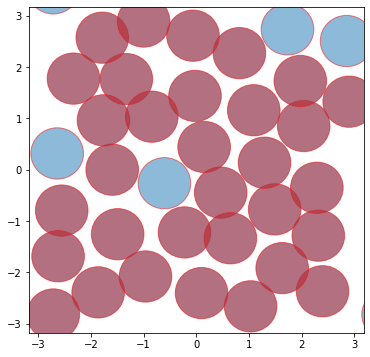

In [247]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

In [248]:
model.eps = 50
hist_bg = bg.train_both(x=Xtrain[::1],epochs=10,lr=0.0005,batch_size=batchsize)


Epoch 1/10
25/25 [==============================] - 6s 34ms/step - loss: 376.1117
Epoch 2/10
25/25 [==============================] - 1s 34ms/step - loss: 194.5627
Epoch 3/10
25/25 [==============================] - 1s 34ms/step - loss: 175.5782
Epoch 4/10
25/25 [==============================] - 1s 34ms/step - loss: 172.1643
Epoch 5/10
25/25 [==============================] - 1s 34ms/step - loss: 170.2182
Epoch 6/10
25/25 [==============================] - 1s 34ms/step - loss: 167.9448
Epoch 7/10
25/25 [==============================] - 1s 34ms/step - loss: 168.4335
Epoch 8/10
25/25 [==============================] - 1s 34ms/step - loss: 167.4433
Epoch 9/10
25/25 [==============================] - 1s 34ms/step - loss: 164.3135
Epoch 10/10
25/25 [==============================] - 1s 34ms/step - loss: 163.9580


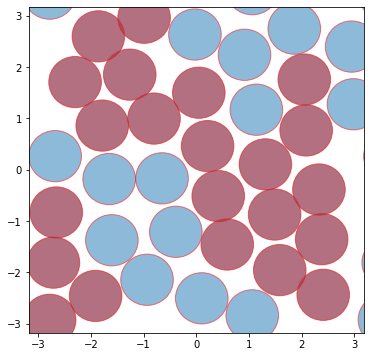

In [249]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

In [250]:
# hist_bg = bg.train_x(batches=100,epochs=30,lr=0.001,batch_size=batchsize)
# plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)

In [251]:
_, sample_x, b, overlap_x, w, logw = bg.sample(nsample=10000, temperature=1)

[25.821417  23.575287  25.007635  ...  6.7819777 14.832998   8.245296 ]


In [252]:
np.sum(overlap_x == 0) / len(overlap_x)

0.0006

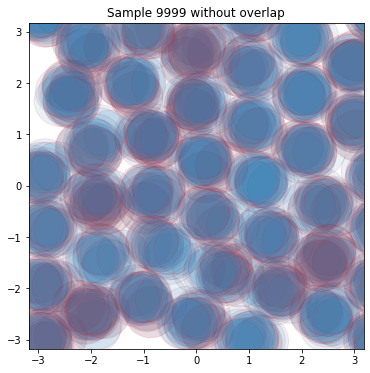

In [253]:
plotted = 0
for ii in np.linspace(0, len(sample_x)-1, num=15, dtype=int):
    if plotted == 0:
        fig, ax = plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=True,color_overlapper=True)
    else:
        plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=False, fig=fig, ax=ax,color_overlapper=True)
    plotted += 1

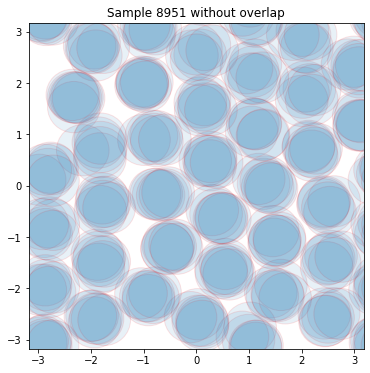

In [256]:
plot_at_most = 19
sts = (len(sample_x)//plot_at_most)
plotted = 0
zero_overlap_ones = np.where(model.smooth_overlap_tf(sample_x).numpy() == 0)[0]
for ii in zero_overlap_ones:
    if model.smooth_overlap_tf(sample_x[i:i+1]) == 0:
        if plotted == 0:
            fig, ax = plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=True,color_overlapper=True)
        else:
            plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=False, fig=fig, ax=ax,color_overlapper=True)
        plotted += 1
    if plotted > plot_at_most:
        break

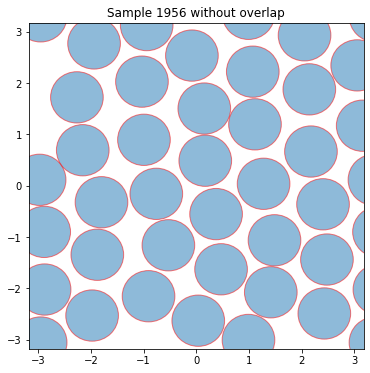

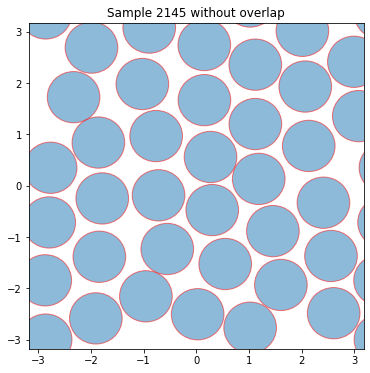

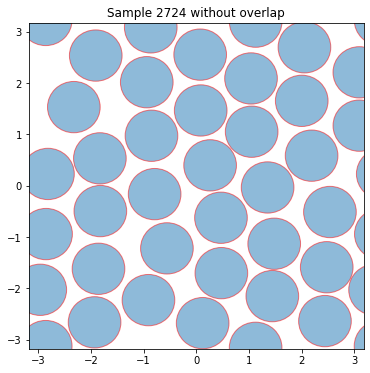

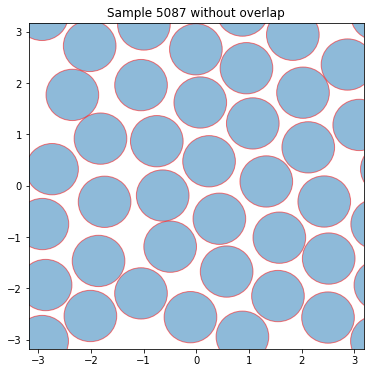

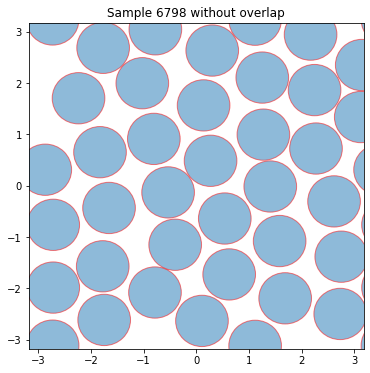

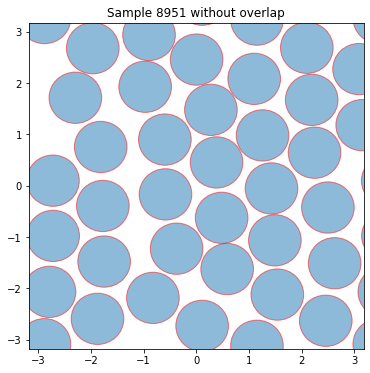

In [255]:
plot_at_most = 19
sts = (len(sample_x)//plot_at_most)
plotted = 0
zero_overlap_ones = np.where(model.smooth_overlap_tf(sample_x).numpy() == 0)[0]
for i in zero_overlap_ones:
    if model.smooth_overlap_tf(sample_x[i:i+1]) == 0:
        plot_config_wrap(model.wrap(sample_x)[i:i+1].reshape(-1,2),L=L, title=f'Sample {i} without overlap')
        plotted += 1
    if plotted > plot_at_most:
        break

### Train phi = .605, N = 1024

In [257]:
# Xtrain = np.load('Xtrain_1024_706_10k.npy')
phi = 0.605 # packing fraction
sigma = 1
N = 1024
L = (N*(np.pi*0.25*sigma**2)/phi)**0.5
a = L/np.sqrt(N)

#### Now instead of generating fake trajectories, generate real MC

In [267]:
hoomd.context.initialize('')
box = hoomd.data.boxdim(L=L,dimensions=2)
snap = hoomd.data.make_snapshot(N=N,particle_types=['A'],box=box)

snap.particles.position[:] = [(i,j,0) for i in np.arange(-L/2,L/2,a) for j in np.arange(-L/2,L/2,a)]
system = hoomd.init.read_snapshot(snap)
mc = hpmc.integrate.sphere(seed=123)
mc.shape_param.set('A',diameter=sigma)
gsd = hoomd.dump.gsd(f'trajectory_{N}_{phi:.3f}.gsd',period=10,group=hoomd.group.all(),overwrite=True)
mc.set_params(d=0.05)
hoomd.run(300000)

notice(2): Group "all" created containing 1024 particles
** starting run **
Time 00:00:10 | Step 39898 / 300000 | TPS 3989.8 | ETA 00:01:05
Time 00:00:20 | Step 80026 / 300000 | TPS 4012.78 | ETA 00:00:54
Time 00:00:30 | Step 119417 / 300000 | TPS 3939.04 | ETA 00:00:45
Time 00:00:40 | Step 159711 / 300000 | TPS 4029.26 | ETA 00:00:34
Time 00:00:50 | Step 200022 / 300000 | TPS 4031.08 | ETA 00:00:24
Time 00:01:00 | Step 239885 / 300000 | TPS 3986.25 | ETA 00:00:15
Time 00:01:10 | Step 279661 / 300000 | TPS 3977.5 | ETA 00:00:05
Time 00:01:15 | Step 300000 / 300000 | TPS 4003.1 | ETA 00:00:00
Average TPS: 3995.61
---------
notice(2): -- HPMC stats:
notice(2): Average translate acceptance: 0.764214
notice(2): Trial moves per second:        1.5756e+07
notice(2): Overlap checks per second:     1.13389e+08
notice(2): Overlap checks per trial move: 7.19655
notice(2): Number of overlap errors:      0
-- Cell list stats:
Dimension: 36, 36, 1
n_min    : 0 / n_max: 2 / n_avg: 0.790123
** run com

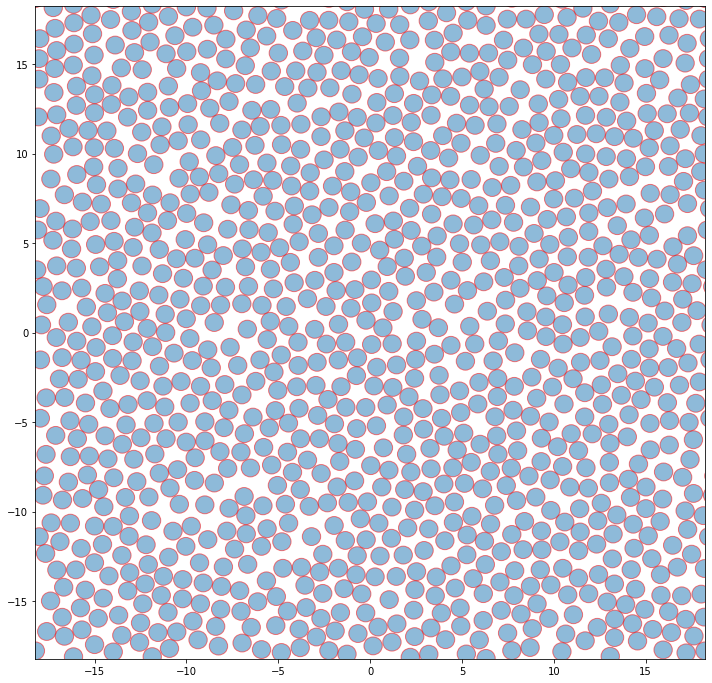

In [268]:
snap = system.take_snapshot()
pts = snap.particles.position[:]
plot_config_wrap(pts[:,:2],L=system.box.Lx)

In [17]:
import gsd.hoomd
f = gsd.hoomd.open(name=f'trajectory_{N}_{phi:.3f}.gsd', mode='rb')
# permute indistinguishable particles to minimize RMSD wrt reference structure
from deep_boltzmann.sampling.permutation import HungarianMapper
mapper = HungarianMapper(xref=f[1].particles.position[:,:2].reshape(1,-1),
                         identical_particles=np.arange(len(f[1].particles.position)))


In [18]:
Xpos = np.zeros((len(f), len(f[0].particles.position[:,:2].flatten())))
for idx, fi in enumerate(f):
    if idx % 10000 == 0:
        print(idx)
    Xpos[idx] = fi.particles.position[:,:2].flatten()

0
10000
20000


In [19]:
import time
import multiprocessing as mp
# Xtrain = np.zeros((len(f), len(f[0].particles.position[:,:2].flatten())))
pool = mp.Pool(processes=16)
t1 = time.time()
lr = pool.map(mapper.map, (Xpos[i] for i in range(0, len(f))))
pool.close()
pool.join()
# for i in range(0, len(f)):
#     if i % 50 == 0:
# #         print(i)
t2 = time.time()

#         print(f'{i:6d} Time elapsed = {t2-t1} s')
#     Xpos_this = Xpos[i]
#     Xtrain[i] = mapper.map(Xpos_this)
# %timeit Xtrain[0] = mapper.map(f[0].particles.position[:,:2].flatten())
Xtrain = np.array(lr).squeeze()
print(f'Elapsed: {(t2 - t1):.3f} s')

Elapsed: 242430.307 s


In [53]:
import pickle
with open(f'trajectory_{N}_{phi:.3f}.pkl', mode='wb') as f:
    pickle.dump(Xtrain, f)

In [228]:
import pickle
with open(f'trajectory_{N}_{phi:.3f}.pkl', mode='rb') as f:
    Xtrain = pickle.load(f)

In [229]:
# # Generate fake configurations for train_z
# num_frames = 500
# side = int(np.sqrt(N))
# Xtrain = np.zeros((num_frames,N*2))
# for h in np.arange(num_frames):
#     for idx, i in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
#         for idy, j in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
#             Xtrain[h,idx*side*2+idy*2] = i
#             Xtrain[h,idx*side*2+idy*2+1] = j
# # print(Xtrain[0][:10])
# # print(Xtrain[0].reshape(-1,2).shape)
# # plot_config_wrap(model.wrap(Xtrain[0].reshape(-1,2)),L=L,lm=1)

In [69]:
model = HardDisks(N=N,
                  L=L,
                  sigma=sigma,
                  eps=15)

In [76]:
# reset model
#bg = invnet(model.dim, 'LRRRRRRRRRRRR', overlap_model=model, nl_layers=4, nl_hidden=200, #100
bg = invnet(model.dim, 'LRRRRRRRRR', overlap_model=model, nl_layers=3, nl_hidden=200, #200, #100
#            nl_activation='tanh', nl_activation_t='tanh', L=L)
           nl_activation='tanh', nl_activation_t='relu', L=L)

L<RRRRRRRRR>


In [77]:
# bg = OverlapInvNet.load('test1024.model',overlap_model=model)

In [79]:
batchsize = 128

In [80]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=12,lr=0.0003,batch_size=128,verbose=True)

Epoch 1/12
235/235 [==============================] - 5s 10ms/step - loss: -4670.1584
Epoch 2/12
235/235 [==============================] - 2s 10ms/step - loss: -6523.2373
Epoch 3/12
235/235 [==============================] - 2s 10ms/step - loss: -6630.4563
Epoch 4/12
235/235 [==============================] - 2s 10ms/step - loss: -6713.1090
Epoch 5/12
235/235 [==============================] - 2s 10ms/step - loss: -6762.7789
Epoch 6/12
235/235 [==============================] - 2s 10ms/step - loss: -6813.1744
Epoch 7/12
235/235 [==============================] - 2s 10ms/step - loss: -6389.0051
Epoch 8/12
235/235 [==============================] - 2s 10ms/step - loss: -6872.4784
Epoch 9/12
235/235 [==============================] - 2s 10ms/step - loss: -6902.0274
Epoch 10/12
235/235 [==============================] - 2s 10ms/step - loss: -6920.7902
Epoch 11/12
235/235 [==============================] - 2s 10ms/step - loss: -6939.7528
Epoch 12/12
235/235 [==============================]

In [81]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=12,lr=0.0003,batch_size=128,verbose=True)

Epoch 1/12
235/235 [==============================] - 5s 10ms/step - loss: -5921.4770
Epoch 2/12
235/235 [==============================] - 2s 10ms/step - loss: -6954.7407
Epoch 3/12
235/235 [==============================] - 2s 10ms/step - loss: -7004.1473
Epoch 4/12
235/235 [==============================] - 2s 10ms/step - loss: -7022.0443
Epoch 5/12
235/235 [==============================] - 2s 10ms/step - loss: -7033.7750
Epoch 6/12
235/235 [==============================] - 2s 10ms/step - loss: -7049.5406
Epoch 7/12
235/235 [==============================] - 2s 10ms/step - loss: -7059.0810
Epoch 8/12
235/235 [==============================] - 2s 10ms/step - loss: -7076.6588
Epoch 9/12
235/235 [==============================] - 2s 10ms/step - loss: -7082.5637
Epoch 10/12
235/235 [==============================] - 2s 10ms/step - loss: -4987.3859
Epoch 11/12
235/235 [==============================] - 2s 10ms/step - loss: -6732.4498
Epoch 12/12
235/235 [==============================]

[8018.9756]


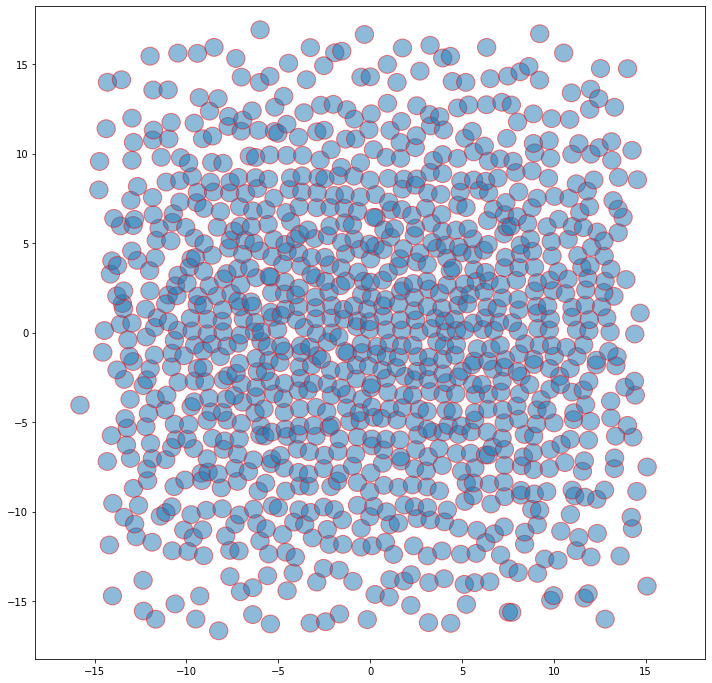

In [82]:
_, sample_x, b, overlap_x, w, logw = bg.sample(nsample=1, temperature=0.1)
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)
# plot_config_wrap(model.wrap(np.mean(Xtrain.reshape(len(Xtrain),-1,2),axis=0)),L=L)

In [75]:
# hist_bg = bg.train_x(batches=100,epochs=12,lr=0.0001,batch_size=batchsize)
hist_bg = bg.train_x(batches=100,epochs=10,lr=0.0003,batch_size=128)


Epoch 1/10
 30/100 [========>.....................] - ETA: 4s - loss: nan

KeyboardInterrupt: 

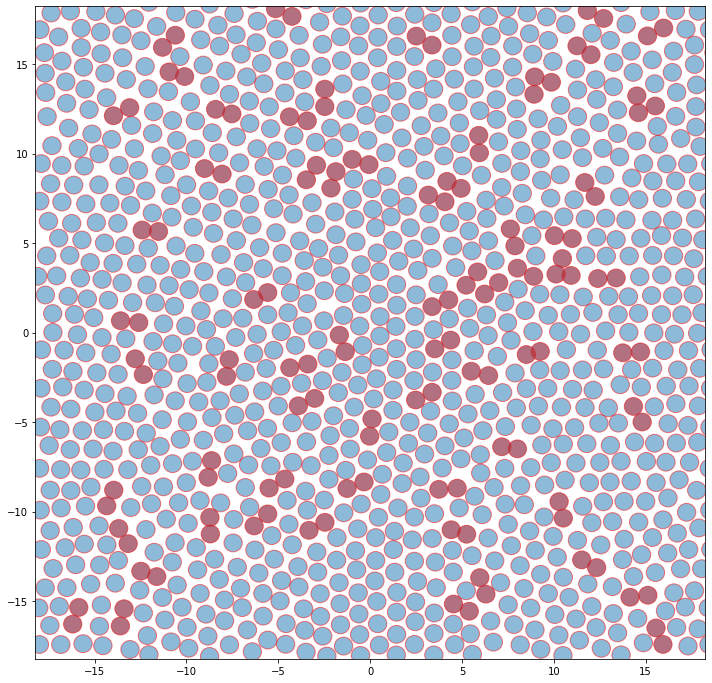

In [65]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

In [88]:
hist_bg = bg.train_x(batches=100,epochs=30,lr=0.001,batch_size=batchsize)
# plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)

Epoch 1/30
100/100 [==============================] - 19s 153ms/step - loss: 51658.8698
Epoch 2/30
100/100 [==============================] - 15s 153ms/step - loss: 21084.3774
Epoch 3/30
100/100 [==============================] - 15s 153ms/step - loss: 17130.0497
Epoch 4/30
100/100 [==============================] - 15s 153ms/step - loss: 14504.8894
Epoch 5/30
100/100 [==============================] - 15s 154ms/step - loss: 12370.4176
Epoch 6/30
100/100 [==============================] - 15s 153ms/step - loss: 15526.7957
Epoch 7/30
100/100 [==============================] - 15s 153ms/step - loss: 14597.2798
Epoch 8/30
100/100 [==============================] - 15s 153ms/step - loss: 12092.1740
Epoch 9/30
100/100 [==============================] - 15s 154ms/step - loss: 12051.2536
Epoch 10/30
100/100 [==============================] - 15s 154ms/step - loss: 12038.7223
Epoch 11/30
100/100 [==============================] - 15s 154ms/step - loss: 12032.8235
Epoch 12/30
100/100 [=========

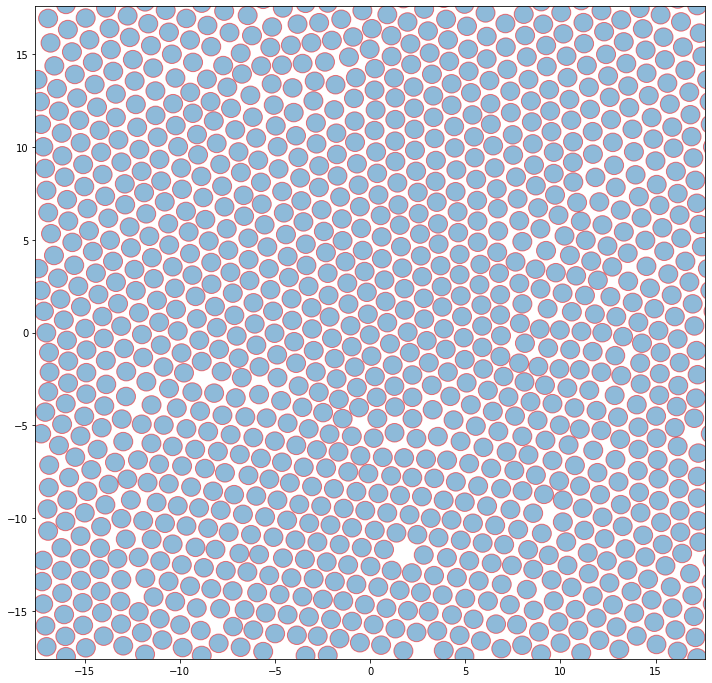

In [89]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

In [66]:
a, sample_x, b, overlap_x, w, logw = bg.sample(nsample=100, temperature=1)

[ 970.1567   941.8314  1013.8348   979.1796   777.3688  1020.14636
 1004.4756   946.2403   931.50793  902.66046  864.86536  897.2342
 1097.3184   945.1986   857.76     950.74207 1051.3276   972.91406
 1008.1095   767.3574   946.6966   990.98096  957.9584   996.072
 1049.4208   924.5169   947.6283   990.98083 1138.1353  1015.48376
 1057.5319   827.02246 1018.7278   987.3194   956.19403  973.6577
  872.85406  939.91675  869.6172   897.49756 1056.4624   923.6425
 1022.0172   853.50354  869.90326  888.11523  894.5032  1000.39484
  936.3287  1017.0614   952.4459  1073.7864   997.0345   989.3133
  918.38025 1023.3876   765.5116   726.64246  838.814    891.7765
  948.45807  949.9822   865.08     789.2682  1052.7333   877.63464
  954.4131   974.0477   862.3836   958.67676  943.7035  1029.1943
  916.81995  967.4472   977.9151  1081.001    935.2563   983.8454
  775.78284  867.8824  1111.3125   904.81836  953.82336  978.2746
  948.43005 1115.4355   854.68097 1083.332    980.03925  742.9456
 1134.

0.0


(array([ 1.,  2.,  6.,  6., 17., 19., 23., 12.,  9.,  5.]),
 array([ 671.2768 ,  717.96265,  764.6485 ,  811.33435,  858.0202 ,
         904.70605,  951.39185,  998.0777 , 1044.7635 , 1091.4495 ,
        1138.1353 ], dtype=float32),
 <BarContainer object of 10 artists>)

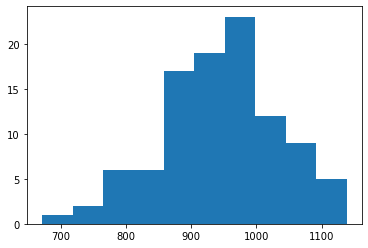

In [67]:
print(np.sum(overlap_x == 0) / len(overlap_x))
plt.hist(overlap_x)

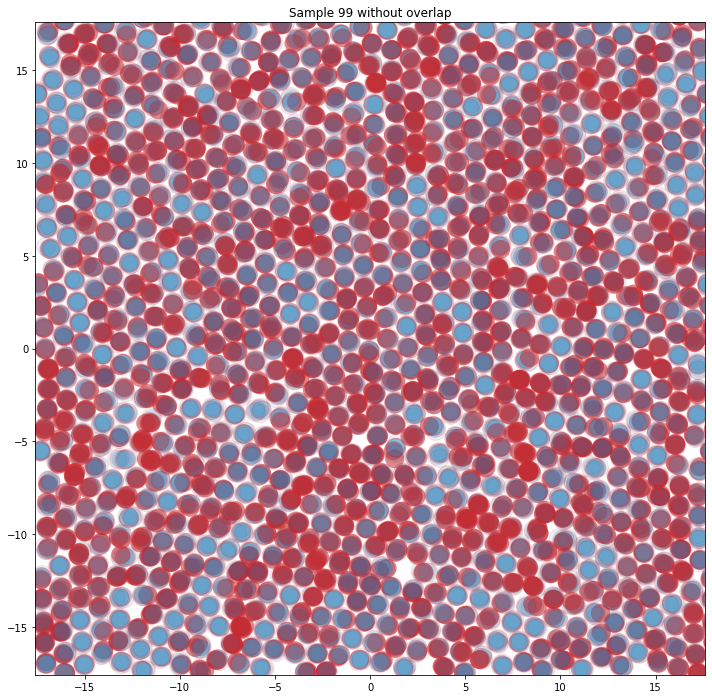

In [93]:
plotted = 0
for ii in np.linspace(0, len(sample_x)-1, num=10, dtype=int):
    if plotted == 0:
        fig, ax = plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=True,color_overlapper=True)
    else:
        plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=False, fig=fig, ax=ax,color_overlapper=True)
    plotted += 1

### Train phi = .650, N = 1024

In [76]:
# Xtrain = np.load('Xtrain_1024_706_10k.npy')
phi = 0.650 # packing fraction
sigma = 1
N = 1024
L = (N*(np.pi*0.25*sigma**2)/phi)**0.5

model = HardDisks(N=N,
                  L=L,
                  sigma=sigma,
                  eps=50)

In [77]:
# reset model
#bg = invnet(model.dim, 'LRRRRRRRRRRRR', overlap_model=model, nl_layers=4, nl_hidden=200, #100
bg = invnet(model.dim, 'LRRRRRRRRR', overlap_model=model, nl_layers=3, nl_hidden=200, #200, #100
#            nl_activation='tanh', nl_activation_t='tanh', L=L)
           nl_activation='tanh', nl_activation_t='relu', L=L)

L<RRRRRRRRR>


In [78]:
# bg = OverlapInvNet.load('test1024.model',overlap_model=model)

In [79]:
batchsize = 300

In [80]:
# hist_bg = bg.train_z(x=Xtrain[::1],epochs=2,lr=0.00001,batch_size=batchsize)

In [81]:
a, sample_x, b, overlap_x, w, logw = bg.sample(nsample=1, temperature=0.1)

[58616.062]


In [82]:
# Generate fake configurations for train_z
num_frames = 500
side = int(np.sqrt(N))
Xtrain = np.zeros((num_frames,N*2))
for h in np.arange(num_frames):
    for idx, i in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
        for idy, j in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
            Xtrain[h,idx*side*2+idy*2] = i
            Xtrain[h,idx*side*2+idy*2+1] = j
# print(Xtrain[0][:10])
# print(Xtrain[0].reshape(-1,2).shape)
# plot_config_wrap(model.wrap(Xtrain[0].reshape(-1,2)),L=L,lm=1)

In [83]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.0003,batch_size=100,verbose=False)

In [84]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.0001,batch_size=100,verbose=False)

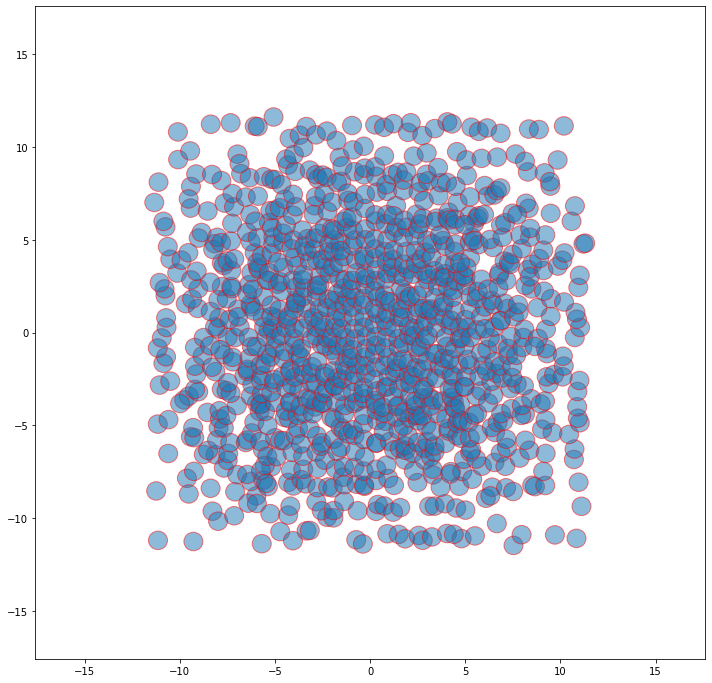

In [85]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)
# plot_config_wrap(model.wrap(np.mean(Xtrain.reshape(len(Xtrain),-1,2),axis=0)),L=L)

In [86]:
# hist_bg = bg.train_x(batches=100,epochs=12,lr=0.0001,batch_size=batchsize)
hist_bg = bg.train_x(batches=100,epochs=10,lr=0.0001,batch_size=batchsize)


Epoch 1/10
100/100 [==============================] - 20s 154ms/step - loss: 21686.2848
Epoch 2/10
100/100 [==============================] - 15s 154ms/step - loss: 13067.2769
Epoch 3/10
100/100 [==============================] - 15s 154ms/step - loss: 12569.5697
Epoch 4/10
100/100 [==============================] - 15s 154ms/step - loss: 12456.7182
Epoch 5/10
100/100 [==============================] - 15s 153ms/step - loss: 13984.7510
Epoch 6/10
100/100 [==============================] - 15s 154ms/step - loss: 12442.0469
Epoch 7/10
100/100 [==============================] - 15s 154ms/step - loss: 12336.8826
Epoch 8/10
100/100 [==============================] - 15s 153ms/step - loss: 12304.3042
Epoch 9/10
100/100 [==============================] - 15s 153ms/step - loss: 12282.9062
Epoch 10/10
100/100 [==============================] - 15s 154ms/step - loss: 12265.0691


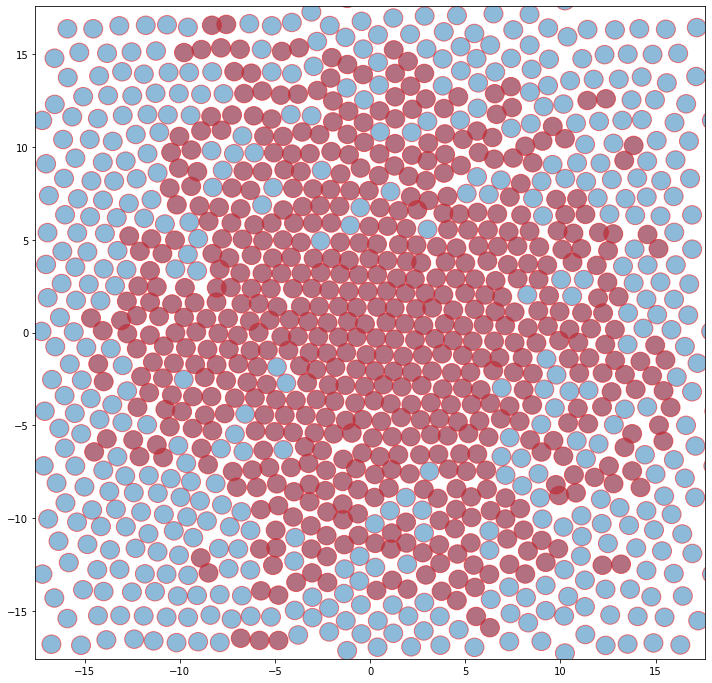

In [87]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

In [88]:
hist_bg = bg.train_x(batches=100,epochs=30,lr=0.001,batch_size=batchsize)
# plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)

Epoch 1/30
100/100 [==============================] - 19s 153ms/step - loss: 51658.8698
Epoch 2/30
100/100 [==============================] - 15s 153ms/step - loss: 21084.3774
Epoch 3/30
100/100 [==============================] - 15s 153ms/step - loss: 17130.0497
Epoch 4/30
100/100 [==============================] - 15s 153ms/step - loss: 14504.8894
Epoch 5/30
100/100 [==============================] - 15s 154ms/step - loss: 12370.4176
Epoch 6/30
100/100 [==============================] - 15s 153ms/step - loss: 15526.7957
Epoch 7/30
100/100 [==============================] - 15s 153ms/step - loss: 14597.2798
Epoch 8/30
100/100 [==============================] - 15s 153ms/step - loss: 12092.1740
Epoch 9/30
100/100 [==============================] - 15s 154ms/step - loss: 12051.2536
Epoch 10/30
100/100 [==============================] - 15s 154ms/step - loss: 12038.7223
Epoch 11/30
100/100 [==============================] - 15s 154ms/step - loss: 12032.8235
Epoch 12/30
100/100 [=========

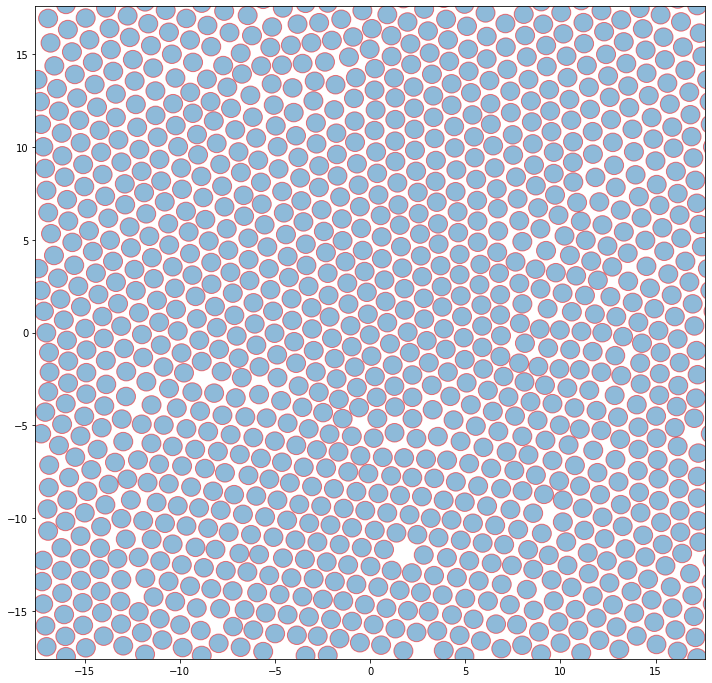

In [89]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

In [90]:
a, sample_x, b, overlap_x, w, logw = bg.sample(nsample=100, temperature=1)

[453.23212 433.194   502.61932 564.7437  487.6891  546.5214  493.50623
 655.0824  444.36362 455.50726 359.6971  508.8002  473.86493 520.5377
 360.03128 527.80945 683.4719  432.57077 458.7183  505.13907 446.61908
 408.73822 374.36264 472.24786 449.02948 474.70306 455.6459  417.78265
 390.8292  473.48322 369.92532 413.86588 539.997   654.9535  528.93567
 335.45724 478.60736 518.86456 526.85065 584.22327 490.11914 426.1423
 558.8611  513.0753  339.0351  382.05804 335.3007  464.60745 500.07184
 464.34894 512.53925 490.7351  545.14264 442.15094 425.49686 351.16113
 643.8407  476.9346  466.0318  459.35342 328.65033 293.2219  574.9671
 421.699   507.01532 377.649   493.03467 452.98492 391.90143 466.46173
 396.19632 402.84323 545.4604  506.25763 341.62234 462.48215 371.40796
 523.98566 361.42413 323.2618  398.96564 427.8808  466.73663 494.93057
 560.10345 661.9621  357.28836 412.70157 402.8411  349.8523  451.46506
 423.29596 596.8124  465.9376  493.70776 374.13806 364.10468 450.6696
 531.2189 

0.0


(array([ 3., 13., 12., 14., 22., 18., 10.,  3.,  1.,  4.]),
 array([293.2219 , 332.2469 , 371.2719 , 410.2969 , 449.3219 , 488.34692,
        527.3719 , 566.3969 , 605.42194, 644.4469 , 683.4719 ],
       dtype=float32),
 <BarContainer object of 10 artists>)

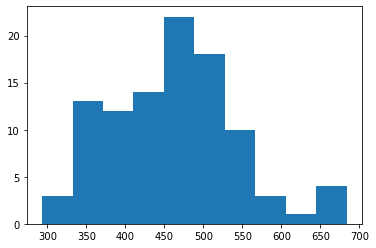

In [92]:
print(np.sum(overlap_x == 0) / len(overlap_x))
plt.hist(overlap_x)

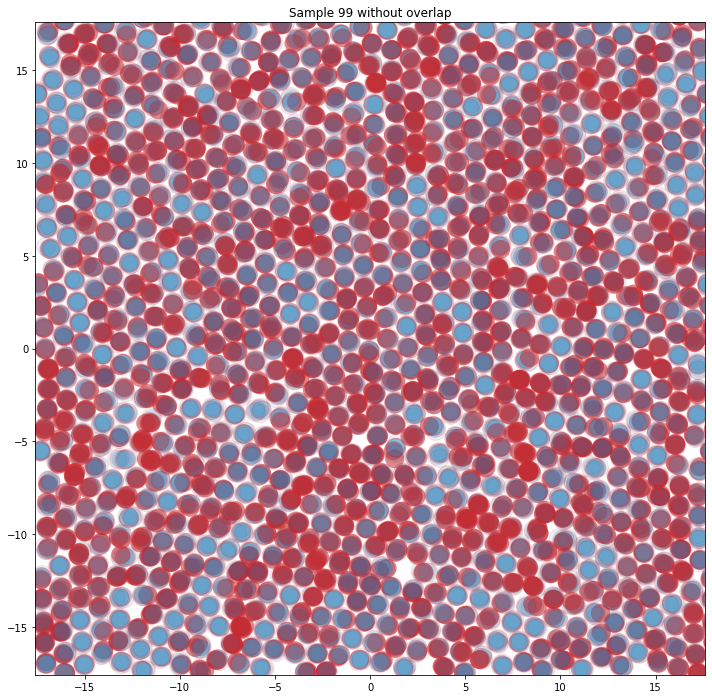

In [93]:
plotted = 0
for ii in np.linspace(0, len(sample_x)-1, num=10, dtype=int):
    if plotted == 0:
        fig, ax = plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=True,color_overlapper=True)
    else:
        plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=False, fig=fig, ax=ax,color_overlapper=True)
    plotted += 1

### Train phi = .706, N = 1024

In [144]:
# Xtrain = np.load('Xtrain_1024_706_10k.npy')
phi = 0.706 # packing fraction
sigma = 1
N = 1024
L = (N*(np.pi*0.25*sigma**2)/phi)**0.5
model = HardDisks(N=N,
                  L=L,
                  sigma=sigma,
                  eps=50)

In [145]:
# reset model
#bg = invnet(model.dim, 'LRRRRRRRRRRRR', overlap_model=model, nl_layers=4, nl_hidden=200, #100
bg = invnet(model.dim, 'LRRRRRRRRR', overlap_model=model, nl_layers=3, nl_hidden=200, #200, #100
#            nl_activation='tanh', nl_activation_t='tanh', L=L)
           nl_activation='tanh', nl_activation_t='relu', L=L)

L<RRRRRRRRR>


In [146]:
# bg = OverlapInvNet.load('test1024.model',overlap_model=model)

In [147]:
batchsize = 300

In [148]:
# hist_bg = bg.train_z(x=Xtrain[::1],epochs=2,lr=0.00001,batch_size=batchsize)

In [149]:
a, sample_x, b, overlap_x, w, logw = bg.sample(nsample=1, temperature=0.1)

[62912.9]


In [150]:
# Generate fake configurations for train_z
num_frames = 500
side = int(np.sqrt(N))
Xtrain = np.zeros((num_frames,N*2))
for h in np.arange(num_frames):
    for idx, i in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
        for idy, j in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
            Xtrain[h,idx*side*2+idy*2] = i
            Xtrain[h,idx*side*2+idy*2+1] = j
# print(Xtrain[0][:10])
# print(Xtrain[0].reshape(-1,2).shape)
# plot_config_wrap(model.wrap(Xtrain[0].reshape(-1,2)),L=L,lm=1)

In [151]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.0003,batch_size=100,verbose=False)

In [152]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.0001,batch_size=100,verbose=False)

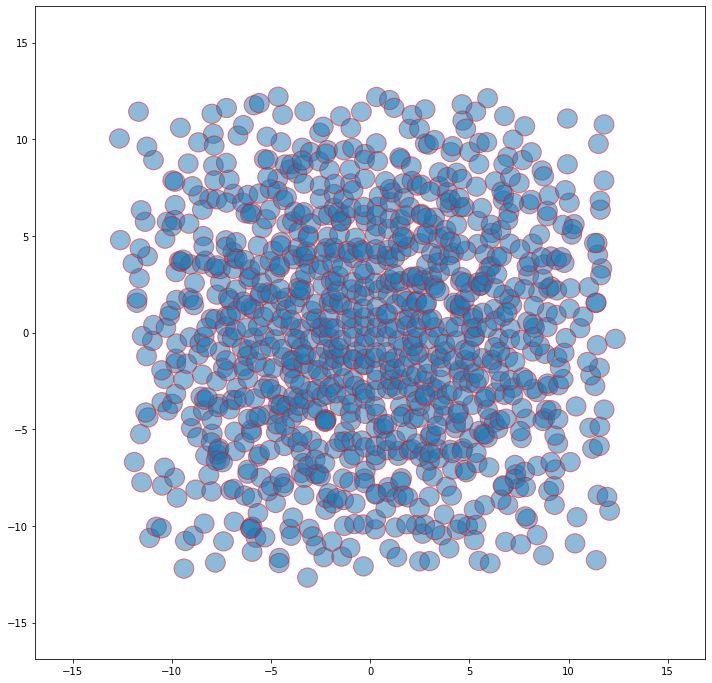

In [153]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)
# plot_config_wrap(model.wrap(np.mean(Xtrain.reshape(len(Xtrain),-1,2),axis=0)),L=L)

In [154]:
# hist_bg = bg.train_x(batches=100,epochs=12,lr=0.0001,batch_size=batchsize)
hist_bg = bg.train_x(batches=100,epochs=10,lr=0.0001,batch_size=batchsize)


Epoch 1/10
100/100 [==============================] - 22s 155ms/step - loss: 23659.0290
Epoch 2/10
100/100 [==============================] - 15s 155ms/step - loss: 13776.0150
Epoch 3/10
100/100 [==============================] - 15s 155ms/step - loss: 13378.4837
Epoch 4/10
100/100 [==============================] - 15s 155ms/step - loss: 13181.8598
Epoch 5/10
100/100 [==============================] - 15s 155ms/step - loss: 13095.7966
Epoch 6/10
100/100 [==============================] - 15s 155ms/step - loss: 13879.3543
Epoch 7/10
100/100 [==============================] - 15s 155ms/step - loss: 12889.4002
Epoch 8/10
100/100 [==============================] - 15s 155ms/step - loss: 12888.4209
Epoch 9/10
100/100 [==============================] - 16s 155ms/step - loss: 15196.6734
Epoch 10/10
100/100 [==============================] - 16s 155ms/step - loss: 12813.4372


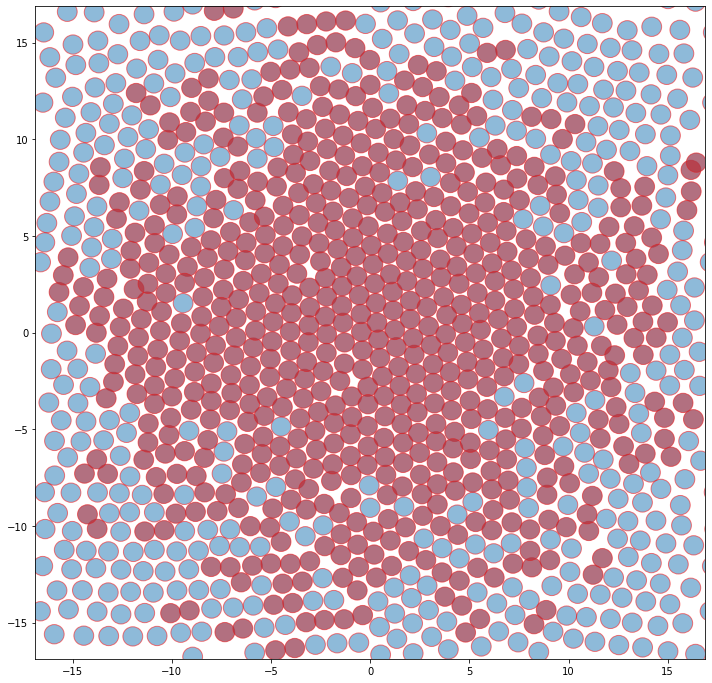

In [155]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

In [156]:
hist_bg = bg.train_x(batches=100,epochs=30,lr=0.001,batch_size=batchsize)
# plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)

Epoch 1/30
100/100 [==============================] - 20s 153ms/step - loss: 118203.0210
Epoch 2/30
100/100 [==============================] - 15s 153ms/step - loss: 23608.6372
Epoch 3/30
100/100 [==============================] - 15s 153ms/step - loss: 19669.3112
Epoch 4/30
100/100 [==============================] - 15s 153ms/step - loss: 17435.2426
Epoch 5/30
100/100 [==============================] - 15s 153ms/step - loss: 15836.3773
Epoch 6/30
100/100 [==============================] - 15s 153ms/step - loss: 14633.2769
Epoch 7/30
100/100 [==============================] - 15s 153ms/step - loss: 13495.7001
Epoch 8/30
100/100 [==============================] - 15s 153ms/step - loss: 15562.4619
Epoch 9/30
100/100 [==============================] - 15s 153ms/step - loss: 14280.2732
Epoch 10/30
100/100 [==============================] - 15s 153ms/step - loss: 12629.3536
Epoch 11/30
100/100 [==============================] - 15s 153ms/step - loss: 12602.4199
Epoch 12/30
100/100 [========

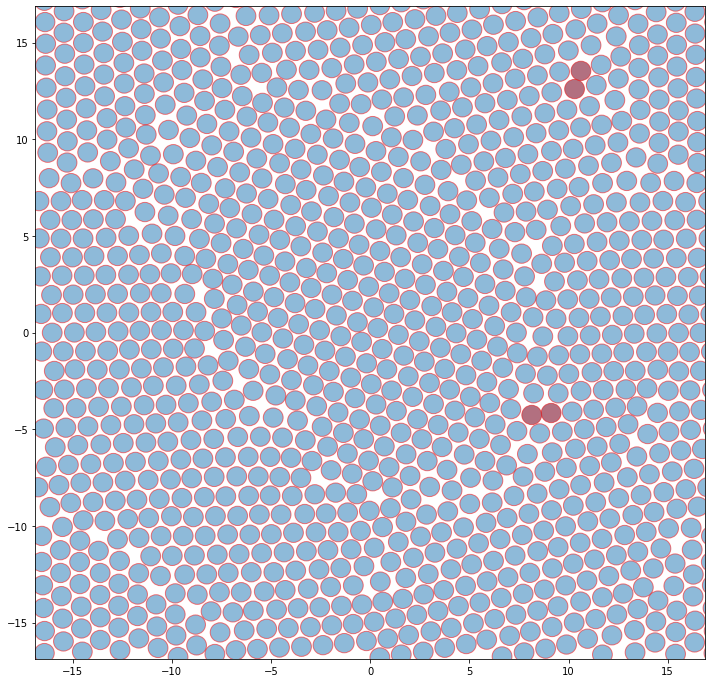

In [157]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

In [164]:
a, sample_x, b, overlap_x, w, logw = bg.sample(nsample=100, temperature=1)

[391.10455 455.6294  459.1266  307.33173 454.71915 370.4056  522.20685
 378.72256 564.0121  548.2622  537.07086 510.89465 529.3903  537.2943
 574.66437 554.7865  445.964   411.94745 355.52826 554.3475  471.08936
 501.23102 521.3285  413.04993 455.8146  404.54156 658.06036 604.83984
 609.1831  601.328   703.4827  614.61304 499.19754 439.437   667.9633
 384.58838 324.7161  507.02124 475.2682  595.39764 431.68784 503.15524
 513.76434 433.75037 388.86566 531.1878  498.58014 496.96332 434.3545
 596.3559  437.33353 556.52954 495.82092 657.8967  344.8797  561.0488
 426.78384 435.53967 674.12726 578.2318  515.2184  430.99423 522.486
 576.03906 343.9364  572.19214 436.94775 452.5604  602.6615  526.0339
 585.5368  578.6229  401.24857 495.77634 562.2339  351.92538 454.61847
 397.38477 543.9691  374.63046 467.6809  347.56125 576.01746 443.72937
 576.9617  424.53827 462.41696 503.8988  374.70264 464.78177 445.14777
 601.766   367.51508 463.60114 474.32468 524.2188  483.23944 651.6324
 423.27173 517

0.0


(array([ 6., 14., 16., 20., 20., 11.,  4.,  3.,  5.,  1.]),
 array([300.01514, 352.5365 , 405.0579 , 457.57925, 510.10065, 562.622  ,
        615.1434 , 667.66473, 720.18616, 772.7075 , 825.2289 ],
       dtype=float32),
 <BarContainer object of 10 artists>)

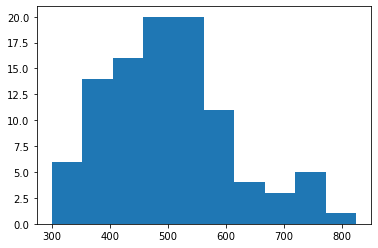

In [159]:
print(np.sum(overlap_x == 0) / len(overlap_x))
plt.hist(overlap_x)

In [170]:
np.random.randint(0,len(sample_x))

79

In [166]:
plot_config_wrap(model.wrap(sample_x[].reshape(-1,2)),L=L,color_overlapper=True)

TypeError: No loop matching the specified signature and casting was found for ufunc floor

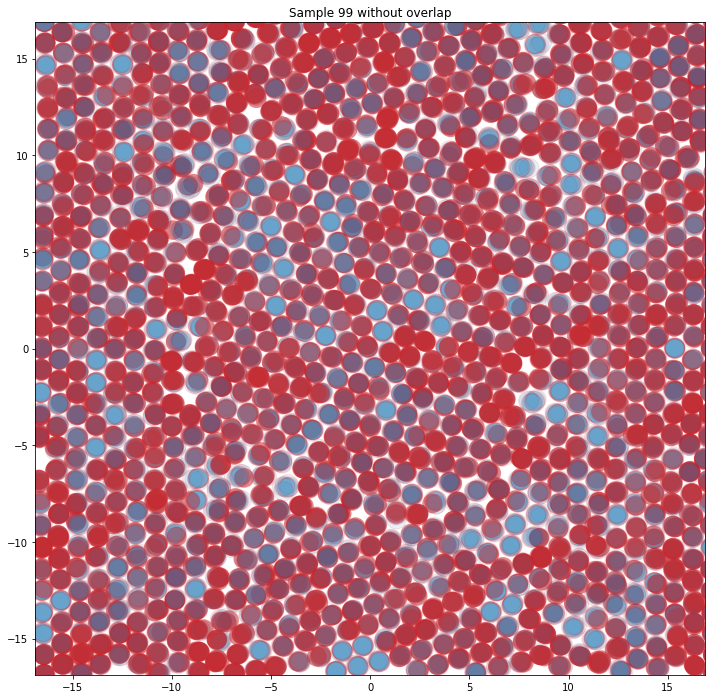

In [139]:
plotted = 0
for ii in np.linspace(0, len(sample_x)-1, num=10, dtype=int):
    if plotted == 0:
        fig, ax = plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=True,color_overlapper=True)
    else:
        plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {ii} without overlap', first=False, fig=fig, ax=ax,color_overlapper=True)
    plotted += 1

In [142]:
model.eps = 250
hist_bg = bg.train_x(batches=100,epochs=10,lr=0.001,batch_size=batchsize)
# plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)

Epoch 1/10
100/100 [==============================] - 21s 155ms/step - loss: 23237.5210
Epoch 2/10
100/100 [==============================] - 15s 155ms/step - loss: 13182.2878
Epoch 3/10
100/100 [==============================] - 15s 155ms/step - loss: 12561.0514
Epoch 4/10
100/100 [==============================] - 15s 155ms/step - loss: 14345.1382
Epoch 5/10
100/100 [==============================] - 16s 155ms/step - loss: 12440.4279
Epoch 6/10
100/100 [==============================] - 16s 155ms/step - loss: 12469.2051
Epoch 7/10
100/100 [==============================] - 16s 155ms/step - loss: 15303.5391
Epoch 8/10
100/100 [==============================] - 16s 155ms/step - loss: nan
Epoch 9/10
100/100 [==============================] - 16s 156ms/step - loss: nan
Epoch 10/10
100/100 [==============================] - 16s 155ms/step - loss: nan


In [143]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True)

<ipython-input-13-d941b1596c25>:100: RuntimeWarning: invalid value encountered in floor_divide
  xcomp -= ((xcomp+0.5*self.L)//self.L)*self.L
<ipython-input-13-d941b1596c25>:101: RuntimeWarning: invalid value encountered in floor_divide
  ycomp -= ((ycomp+0.5*self.L)//self.L)*self.L


ValueError: need at least one array to concatenate

<Figure size 864x864 with 1 Axes>

### Try to calculate pressure!

In [104]:
coords = model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2))

In [77]:
a, sample_x, b, overlap_x, w, logw = bg.sample(nsample=100, temperature=1)

[499.00586 536.5235  362.57123 461.52075 485.6574  711.9321  580.1271
 512.59656 481.8577  613.713   398.82092 363.4902  391.5603  499.26508
 559.2156  523.6199  469.22125 573.534   247.77457 613.4262  424.42963
 476.63962 545.0639  301.39972 575.3211  453.33075 317.2431  376.6278
 449.87643 675.9541  563.2365  359.46426 420.54144 633.87646 371.71732
 845.20013 327.73218 520.5812  476.5879  392.50806 511.9174  457.98816
 593.83734 532.6861  383.1598  495.184   337.53558 464.05212 374.19363
 471.93106 395.2816  571.2761  441.2868  339.00446 484.90558 370.0646
 428.82867 353.65228 590.3868  610.2536  276.28656 331.3616  469.41583
 621.42755 456.59906 395.2774  516.3065  425.2433  539.0815  538.5918
 462.98056 423.91583 698.2175  557.9236  572.64325 356.9376  496.7312
 551.26746 395.22342 500.45105 370.5665  475.30872 416.04333 351.6237
 325.09573 727.8046  408.52814 375.682   516.74774 430.34137 350.55585
 398.4037  406.46832 458.2597  380.91077 649.82837 574.91846 569.3835
 458.25177 53

In [78]:
coords_list = sample_x.reshape((100,-1,2))

In [79]:
# model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(100,-1,2))

In [80]:
import hoomd
from hoomd import hpmc, md
import math
def extrapolate(s, dx, xmax, degree=5):
  # determine the number of values to fit
  n_fit = int(math.ceil(xmax/dx));
  s_fit = s[0:n_fit];
  # construct the x coordinates
  x_fit = np.arange(0,xmax,dx)
  x_fit += dx/2;
  # perform the fit and extrapolation
  p = np.polyfit(x_fit, s_fit, degree);
  return p, np.polyval(p, 0.0);


In [81]:
hoomd.context.initialize('')
box = hoomd.data.boxdim(L=L,dimensions=2)
snap = hoomd.data.make_snapshot(N=N,particle_types=['A'],box=box)

snap.particles.position[:] = [(i[0],i[1],0) for i in coords_list[0]]
system = hoomd.init.read_snapshot(snap)
mc = hpmc.integrate.sphere(seed=123)
gsd = hoomd.dump.gsd('trajectory.gsd',period=1,group=hoomd.group.all(),overwrite=True)
mc.shape_param.set('A',diameter=sigma)

mc.set_params(d=0.00001)
hpmc.analyze.sdf(mc=mc, filename='sdf.dat', xmax=0.02, dx=1e-4, navg=10, period=10,overwrite=True)

for coords in coords_list:
    snap.particles.position[:] = [(i[0],i[1],0) for i in coords]
    system.restore_snapshot(snap)
    hoomd.run(100)

# hoomd.run(1000)

notice(2): Group "all" created containing 1024 particles
** starting run **
Time 00:00:00 | Step 100 / 100 | TPS 767.566 | ETA 00:00:00
Average TPS: 764.742
---------
notice(2): -- HPMC stats:
notice(2): Average translate acceptance: 0.774689
notice(2): Trial moves per second:        2.86491e+06
notice(2): Overlap checks per second:     2.58496e+07
notice(2): Overlap checks per trial move: 9.02282
notice(2): Number of overlap errors:      0
-- Cell list stats:
Dimension: 32, 32, 1
n_min    : 0 / n_max: 2 / n_avg: 1
** run complete **
** starting run **
Time 00:00:00 | Step 200 / 200 | TPS 1584.28 | ETA 00:00:00
Average TPS: 1573.69
---------
notice(2): -- HPMC stats:
notice(2): Average translate acceptance: 0.747151
notice(2): Trial moves per second:        5.88389e+06
notice(2): Overlap checks per second:     5.30891e+07
notice(2): Overlap checks per trial move: 9.02279
notice(2): Number of overlap errors:      0
-- Cell list stats:
Dimension: 32, 32, 1
n_min    : 0 / n_max: 3 / n_avg

In [82]:
P = []
sdf = np.loadtxt('sdf.dat')[:,1:].mean(0)
# print(sdf.shape)
p, a = extrapolate(sdf, 1e-4, 0.02)
P.append(phi * (1 + a / 2 / 2))

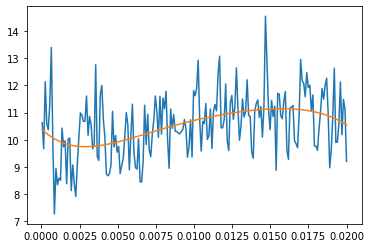

In [76]:
import matplotlib.pyplot as plt
x = np.linspace(1e-4/2, 0.02, len(sdf))
plt.plot(x, sdf)
plt.plot(x, np.polyval(p, x))

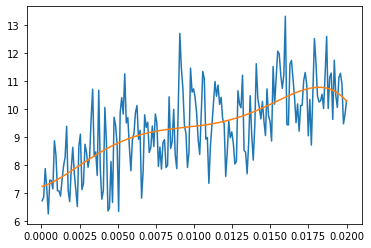

In [83]:
import matplotlib.pyplot as plt
x = np.linspace(1e-4/2, 0.02, len(sdf))
plt.plot(x, sdf)
plt.plot(x, np.polyval(p, x))

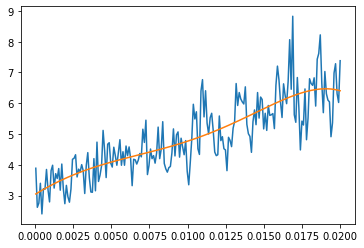

In [69]:
import matplotlib.pyplot as plt
x = np.linspace(1e-4/2, 0.02, len(sdf))
plt.plot(x, sdf)
plt.plot(x, np.polyval(p, x))

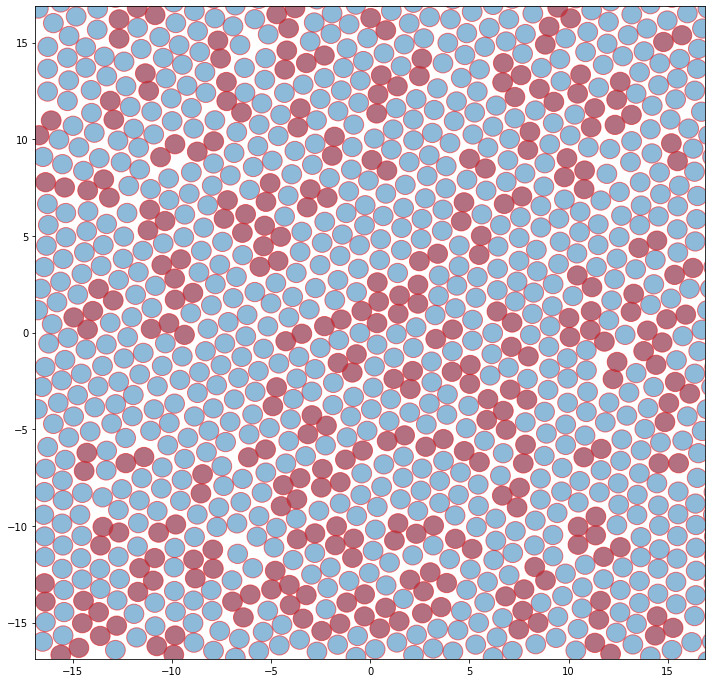

In [84]:
snap = system.take_snapshot()
pts = snap.particles.position[:,:2]
plot_config_wrap(pts,L=system.box.Lx, color_overlapper=True)

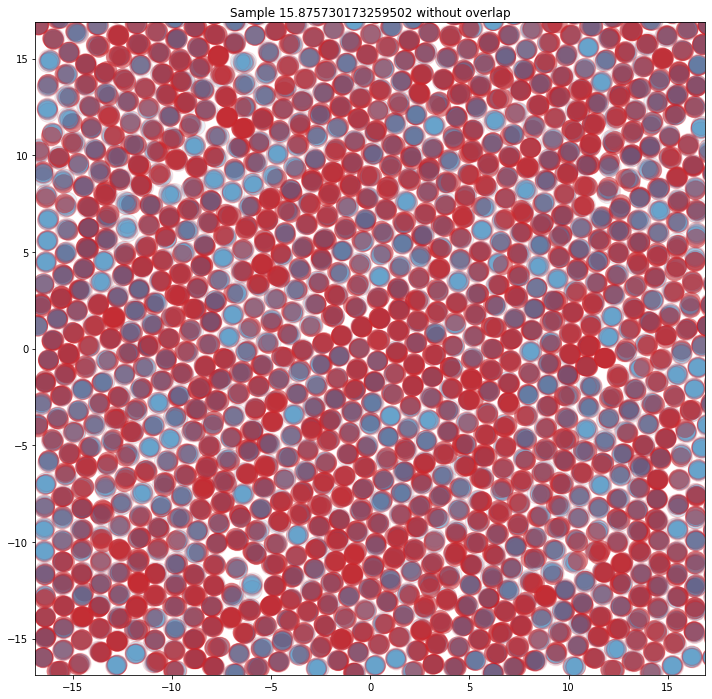

In [94]:
plotted = 0
for ii in np.linspace(0, len(sample_x)-1, num=10, dtype=int):
    if plotted == 0:
        fig, ax = plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {i} without overlap', first=True,color_overlapper=True)
    else:
        plot_config_wrap_multiple(model.wrap(sample_x[ii:ii+1]).reshape(-1,2),L=L, title=f'Sample {i} without overlap', first=False, fig=fig, ax=ax,color_overlapper=True)
    plotted += 1

### Resolve overlap

In [95]:
hoomd.context.initialize('')
box = hoomd.data.boxdim(L=L,dimensions=2)
snap = hoomd.data.make_snapshot(N=N,particle_types=['A'],box=box)

snap.particles.position[:] = [(i[0],i[1],0) for i in coords_list[0]]
system = hoomd.init.read_snapshot(snap)
mc = hpmc.integrate.sphere(seed=123)
gsd = hoomd.dump.gsd('trajectory.gsd',period=100,group=hoomd.group.all(),overwrite=True)
mc.shape_param.set('A',diameter=sigma)

mc.set_params(d=0.005)
hpmc.analyze.sdf(mc=mc, filename='sdf.dat', xmax=0.02, dx=1e-4, navg=10, period=10,overwrite=True)

hoomd.run(1000000)

# hoomd.run(1000)

notice(2): Group "all" created containing 1024 particles
** starting run **
Time 00:00:10 | Step 15373 / 1000000 | TPS 1537.23 | ETA 00:10:40
Time 00:00:20 | Step 31670 / 1000000 | TPS 1629.69 | ETA 00:09:54
Time 00:00:30 | Step 47829 / 1000000 | TPS 1615.81 | ETA 00:09:49
Time 00:00:40 | Step 63985 / 1000000 | TPS 1615.6 | ETA 00:09:39
Time 00:00:50 | Step 79584 / 1000000 | TPS 1559.85 | ETA 00:09:50
Time 00:01:00 | Step 95770 / 1000000 | TPS 1618.59 | ETA 00:09:18
Time 00:01:10 | Step 111940 / 1000000 | TPS 1616.97 | ETA 00:09:09
Time 00:01:20 | Step 128361 / 1000000 | TPS 1642.04 | ETA 00:08:50
Time 00:01:30 | Step 144249 / 1000000 | TPS 1588.75 | ETA 00:08:58
Time 00:01:40 | Step 160445 / 1000000 | TPS 1619.57 | ETA 00:08:38
Time 00:01:50 | Step 176644 / 1000000 | TPS 1619.89 | ETA 00:08:28
Time 00:02:00 | Step 192399 / 1000000 | TPS 1575.06 | ETA 00:08:32
Time 00:02:10 | Step 208412 / 1000000 | TPS 1601.27 | ETA 00:08:14
Time 00:02:20 | Step 224591 / 1000000 | TPS 1617.84 | ETA 00

## Train phi = .706, N = 4096

In [53]:
# Xtrain = np.load('Xtrain_1024_706_10k.npy')
phi = 0.706 # packing fraction
sigma = 1
N = 4096
L = (N*(np.pi*0.25*sigma**2)/phi)**0.5
model = HardDisks(N=N,
                  L=L,
                  sigma=sigma,
                  eps=50)
side = int(np.sqrt(N))

In [54]:
# Generate fake configurations for train_z
num_frames = 500
side = int(np.sqrt(N))
Xtrain = np.zeros((num_frames,N*2))
for h in np.arange(num_frames):
    for idx, i in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
        for idy, j in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
            Xtrain[h,idx*side*2+idy*2] = i
            Xtrain[h,idx*side*2+idy*2+1] = j
# print(Xtrain[0][:10])
# print(Xtrain[0].reshape(-1,2).shape)
# plot_config_wrap(model.wrap(Xtrain[0].reshape(-1,2)),L=L,lm=1)

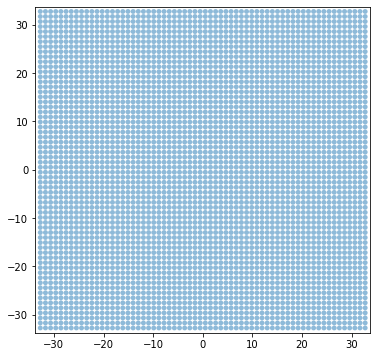

In [55]:
plot_config_wrap(model.wrap(Xtrain[0].reshape(-1,2)),L=L,lm=1)

In [176]:
print(Xtrain[0][:10])

[-32.75146035 -32.75146035 -32.75146035 -31.71173145 -32.75146035
 -30.67200255 -32.75146035 -29.63227365 -32.75146035 -28.59254475]


In [56]:
# reset model
#bg = invnet(model.dim, 'LRRRRRRRRRRRR', overlap_model=model, nl_layers=4, nl_hidden=200, #100
bg = invnet(model.dim, 'LRRRRRRRRR', overlap_model=model, nl_layers=3, nl_hidden=200, #200, #100
#            nl_activation='tanh', nl_activation_t='tanh', L=L)
           nl_activation='tanh', nl_activation_t='relu', L=L)

L<RRRRRRRRR>


In [57]:
batchsize = 300

In [58]:
a, sample_x, b, overlap_x, w, logw = bg.sample(nsample=1, temperature=0.1)

[456468.78]


In [59]:
sample_x[0:1]

array([[ 10.818993 ,  -3.508063 ,  -2.7027545, ..., -14.977865 ,
          9.825538 ,   1.5842657]], dtype=float32)

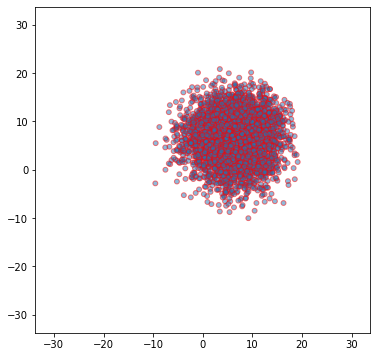

In [181]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.2).reshape(-1,2)),L=L,lm=1)

In [60]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.0003,batch_size=100)

Epoch 1/50
5/5 [==============================] - 3s 17ms/step - loss: -2556.1071
Epoch 2/50
5/5 [==============================] - 0s 16ms/step - loss: -12226.2158
Epoch 3/50
5/5 [==============================] - 0s 16ms/step - loss: -9034.0230
Epoch 4/50
5/5 [==============================] - 0s 16ms/step - loss: -15065.6587
Epoch 5/50
5/5 [==============================] - 0s 16ms/step - loss: -17593.2158
Epoch 6/50
5/5 [==============================] - 0s 16ms/step - loss: -20864.5007
Epoch 7/50
5/5 [==============================] - 0s 16ms/step - loss: -18542.2096
Epoch 8/50
5/5 [==============================] - 0s 16ms/step - loss: -12906.0042
Epoch 9/50
5/5 [==============================] - 0s 16ms/step - loss: -13894.1061
Epoch 10/50
5/5 [==============================] - 0s 16ms/step - loss: -16977.0490
Epoch 11/50
5/5 [==============================] - 0s 16ms/step - loss: -20968.8708
Epoch 12/50
5/5 [==============================] - 0s 16ms/step - loss: -22308.5983
Epo

In [61]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=100,lr=0.0001,batch_size=100)

Epoch 1/100
5/5 [==============================] - 2s 16ms/step - loss: -22505.1904
Epoch 2/100
5/5 [==============================] - 0s 16ms/step - loss: -24884.2516
Epoch 3/100
5/5 [==============================] - 0s 16ms/step - loss: -27634.4844
Epoch 4/100
5/5 [==============================] - 0s 16ms/step - loss: -31068.8350
Epoch 5/100
5/5 [==============================] - 0s 16ms/step - loss: -33420.4980
Epoch 6/100
5/5 [==============================] - 0s 16ms/step - loss: -33574.1133
Epoch 7/100
5/5 [==============================] - 0s 16ms/step - loss: -34676.5352
Epoch 8/100
5/5 [==============================] - 0s 16ms/step - loss: -37194.0859
Epoch 9/100
5/5 [==============================] - 0s 16ms/step - loss: -35967.1868
Epoch 10/100
5/5 [==============================] - 0s 16ms/step - loss: -34032.7773
Epoch 11/100
5/5 [==============================] - 0s 16ms/step - loss: -35712.9603
Epoch 12/100
5/5 [==============================] - 0s 16ms/step - loss: -

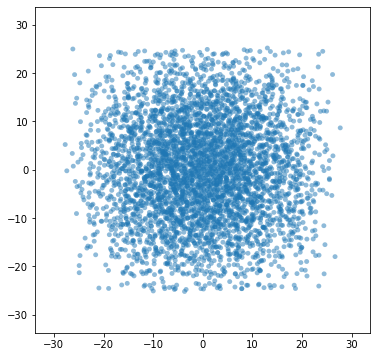

In [62]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,lm=1)
# plot_config_wrap(model.wrap(np.mean(Xtrain.reshape(len(Xtrain),-1,2),axis=0)),L=L)

In [63]:
hist_bg = bg.train_x(batches=100,epochs=15,lr=0.00005,batch_size=10)

Epoch 1/15
100/100 [==============================] - 12s 88ms/step - loss: 141340.9989
Epoch 2/15
100/100 [==============================] - 9s 88ms/step - loss: 69201.2568
Epoch 3/15
100/100 [==============================] - 9s 89ms/step - loss: 62285.3739
Epoch 4/15
100/100 [==============================] - 9s 89ms/step - loss: 60895.7425
Epoch 5/15
100/100 [==============================] - 9s 88ms/step - loss: 60170.6795
Epoch 6/15
100/100 [==============================] - 9s 89ms/step - loss: 60124.8411
Epoch 7/15
100/100 [==============================] - 9s 89ms/step - loss: 59889.7691
Epoch 8/15
100/100 [==============================] - 9s 88ms/step - loss: 59980.7861
Epoch 9/15
100/100 [==============================] - 9s 89ms/step - loss: 59692.1281
Epoch 10/15
100/100 [==============================] - 9s 89ms/step - loss: 59855.0244
Epoch 11/15
100/100 [==============================] - 9s 88ms/step - loss: 59501.3888
Epoch 12/15
100/100 [=============================

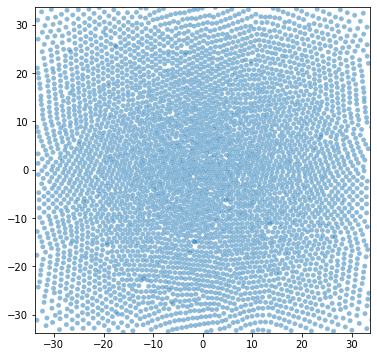

In [64]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,lm=1)

In [67]:
hist_bg = bg.train_x(batches=100,epochs=10,lr=0.0003,batch_size=10)

Epoch 1/10
100/100 [==============================] - 12s 88ms/step - loss: 152838.9938
Epoch 2/10
100/100 [==============================] - 9s 88ms/step - loss: 82021.7896
Epoch 3/10
100/100 [==============================] - 9s 88ms/step - loss: 78714.7090
Epoch 4/10
100/100 [==============================] - 9s 89ms/step - loss: 75314.4800
Epoch 5/10
100/100 [==============================] - 9s 88ms/step - loss: 74191.7083
Epoch 6/10
100/100 [==============================] - 9s 88ms/step - loss: 72049.9695
Epoch 7/10
100/100 [==============================] - 9s 88ms/step - loss: 71307.4158
Epoch 8/10
100/100 [==============================] - 9s 88ms/step - loss: 70485.2298
Epoch 9/10
100/100 [==============================] - 9s 88ms/step - loss: 69071.5850
Epoch 10/10
100/100 [==============================] - 9s 89ms/step - loss: 68305.8853


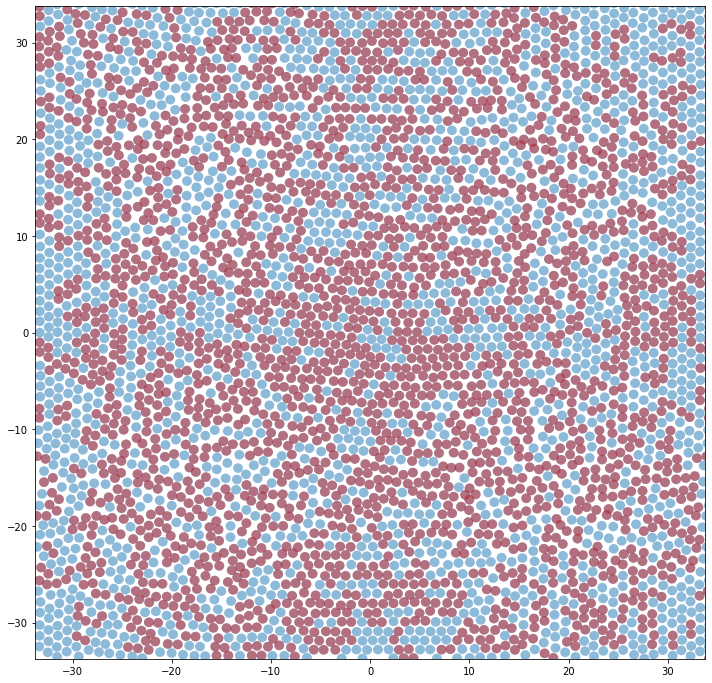

In [68]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True, lm=2)

In [69]:
hist_bg = bg.train_x(batches=100,epochs=10,lr=0.0001,batch_size=10)

Epoch 1/10
100/100 [==============================] - 12s 88ms/step - loss: 80068.5507
Epoch 2/10
100/100 [==============================] - 9s 88ms/step - loss: 58877.1258
Epoch 3/10
100/100 [==============================] - 9s 88ms/step - loss: 58768.4838
Epoch 4/10
100/100 [==============================] - 9s 88ms/step - loss: 58714.4023
Epoch 5/10
100/100 [==============================] - 9s 88ms/step - loss: 58698.4347
Epoch 6/10
100/100 [==============================] - 9s 88ms/step - loss: 58608.9821
Epoch 7/10
100/100 [==============================] - 9s 88ms/step - loss: 58407.6028
Epoch 8/10
100/100 [==============================] - 9s 88ms/step - loss: 58236.0198
Epoch 9/10
100/100 [==============================] - 9s 88ms/step - loss: 58193.3540
Epoch 10/10
100/100 [==============================] - 9s 88ms/step - loss: 58096.2895


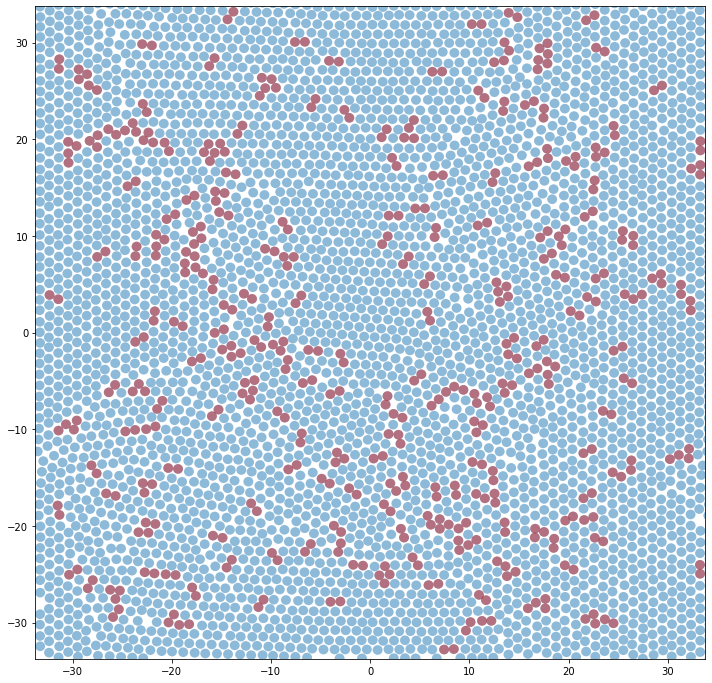

In [70]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True, lm=2)

## Train phi = .706, N = 16384

In [15]:
# Xtrain = np.load('Xtrain_1024_706_10k.npy')
phi = 0.706 # packing fraction
sigma = 1
N = 16384
L = (N*(np.pi*0.25*sigma**2)/phi)**0.5
model = HardDisks(N=N,
                  L=L,
                  sigma=sigma,
                  eps=50)
side = int(np.sqrt(N))

In [16]:
# Generate fake configurations for train_z
num_frames = 500
side = int(np.sqrt(N))
Xtrain = np.zeros((num_frames,N*2))
for h in np.arange(num_frames):
    for idx, i in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
        for idy, j in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
            Xtrain[h,idx*side*2+idy*2] = i
            Xtrain[h,idx*side*2+idy*2+1] = j
# print(Xtrain[0][:10])
# print(Xtrain[0].reshape(-1,2).shape)
# plot_config_wrap(model.wrap(Xtrain[0].reshape(-1,2)),L=L,lm=1)

In [ ]:
plot_config_wrap(model.wrap(Xtrain[0].reshape(-1,2)),L=L,lm=1.5)

In [17]:
print(Xtrain[0][:10])

[-66.50292069 -66.50292069 -66.50292069 -65.4556306  -66.50292069
 -64.40834051 -66.50292069 -63.36105042 -66.50292069 -62.31376033]


In [18]:
# reset model
#bg = invnet(model.dim, 'LRRRRRRRRRRRR', overlap_model=model, nl_layers=4, nl_hidden=200, #100
bg = invnet(model.dim, 'LRRRRRRRRR', overlap_model=model, nl_layers=3, nl_hidden=200, #200, #100
#            nl_activation='tanh', nl_activation_t='tanh', L=L)
           nl_activation='tanh', nl_activation_t='relu', L=L)

L<RRRRRRRRR>


In [19]:
batchsize = 300

In [20]:
a, sample_x, b, overlap_x, w, logw = bg.sample(nsample=1, temperature=0.1)

[2469927.5]


In [21]:
sample_x[0:1]

array([[  9.815912 ,  -1.3822427, -26.861187 , ...,  21.61519  ,
         39.970547 , -18.68992  ]], dtype=float32)

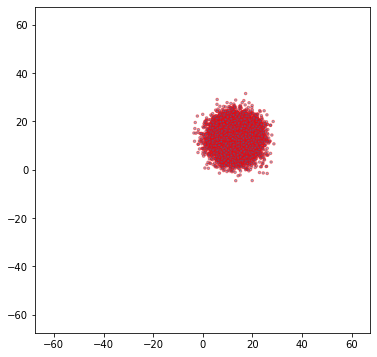

In [22]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.2).reshape(-1,2)),L=L,lm=1)

In [23]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.0003,batch_size=100)

Epoch 1/50
5/5 [==============================] - 3s 47ms/step - loss: -14301.5160
Epoch 2/50
5/5 [==============================] - 0s 44ms/step - loss: -36851.3574
Epoch 3/50
5/5 [==============================] - 0s 44ms/step - loss: -49034.9792
Epoch 4/50
5/5 [==============================] - 0s 44ms/step - loss: -58736.3880
Epoch 5/50
5/5 [==============================] - 0s 44ms/step - loss: -71032.9297
Epoch 6/50
5/5 [==============================] - 0s 44ms/step - loss: -61755.1829
Epoch 7/50
5/5 [==============================] - 0s 44ms/step - loss: -30604.0221
Epoch 8/50
5/5 [==============================] - 0s 44ms/step - loss: -42017.0625
Epoch 9/50
5/5 [==============================] - 0s 44ms/step - loss: -53086.9590
Epoch 10/50
5/5 [==============================] - 0s 44ms/step - loss: -66803.8073
Epoch 11/50
5/5 [==============================] - 0s 44ms/step - loss: -73752.4232
Epoch 12/50
5/5 [==============================] - 0s 44ms/step - loss: -83091.7383
E

In [24]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.00005,batch_size=100)

Epoch 1/50
5/5 [==============================] - 3s 45ms/step - loss: -97753.2656
Epoch 2/50
5/5 [==============================] - 0s 44ms/step - loss: -119402.2760
Epoch 3/50
5/5 [==============================] - 0s 44ms/step - loss: -128544.3685
Epoch 4/50
5/5 [==============================] - 0s 44ms/step - loss: -136072.3438
Epoch 5/50
5/5 [==============================] - 0s 44ms/step - loss: -142911.0625
Epoch 6/50
5/5 [==============================] - 0s 44ms/step - loss: -148319.0391
Epoch 7/50
5/5 [==============================] - 0s 44ms/step - loss: -154943.1146
Epoch 8/50
5/5 [==============================] - 0s 44ms/step - loss: -149063.7214
Epoch 9/50
5/5 [==============================] - 0s 44ms/step - loss: -144644.4089
Epoch 10/50
5/5 [==============================] - 0s 44ms/step - loss: -156563.4948
Epoch 11/50
5/5 [==============================] - 0s 44ms/step - loss: -164357.8333
Epoch 12/50
5/5 [==============================] - 0s 45ms/step - loss: -16

In [25]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.00001,batch_size=100)

Epoch 1/50
5/5 [==============================] - 3s 44ms/step - loss: -105933.1445
Epoch 2/50
5/5 [==============================] - 0s 44ms/step - loss: -114739.7279
Epoch 3/50
5/5 [==============================] - 0s 43ms/step - loss: -117996.9505
Epoch 4/50
5/5 [==============================] - 0s 44ms/step - loss: -120995.4102
Epoch 5/50
5/5 [==============================] - 0s 44ms/step - loss: -123742.2721
Epoch 6/50
5/5 [==============================] - 0s 44ms/step - loss: -126751.5273
Epoch 7/50
5/5 [==============================] - 0s 44ms/step - loss: -129823.0612
Epoch 8/50
5/5 [==============================] - 0s 44ms/step - loss: -132531.3073
Epoch 9/50
5/5 [==============================] - 0s 44ms/step - loss: -135159.7812
Epoch 10/50
5/5 [==============================] - 0s 44ms/step - loss: -138144.3802
Epoch 11/50
5/5 [==============================] - 0s 44ms/step - loss: -140571.7057
Epoch 12/50
5/5 [==============================] - 0s 44ms/step - loss: -1

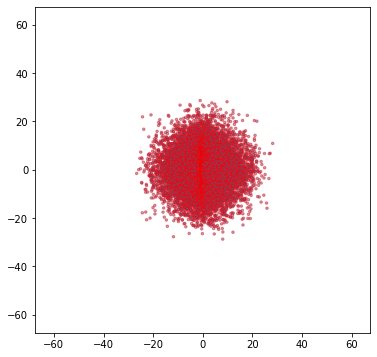

In [26]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,lm=1)
# plot_config_wrap(model.wrap(np.mean(Xtrain.reshape(len(Xtrain),-1,2),axis=0)),L=L)

In [27]:
hist_bg = bg.train_x(batches=100,epochs=30,lr=0.00001,batch_size=1)

Epoch 1/30
100/100 [==============================] - 17s 138ms/step - loss: 5569395.1807
Epoch 2/30
100/100 [==============================] - 14s 138ms/step - loss: 1088553.0811
Epoch 3/30
100/100 [==============================] - 14s 138ms/step - loss: 864648.3113
Epoch 4/30
100/100 [==============================] - 14s 138ms/step - loss: 802396.5408
Epoch 5/30
100/100 [==============================] - 14s 138ms/step - loss: 778460.8682
Epoch 6/30
100/100 [==============================] - 14s 138ms/step - loss: 751531.1275
Epoch 7/30
100/100 [==============================] - 14s 137ms/step - loss: 730841.3787
Epoch 8/30
100/100 [==============================] - 14s 137ms/step - loss: 708746.1368
Epoch 9/30
100/100 [==============================] - 14s 138ms/step - loss: 685868.0421
Epoch 10/30
100/100 [==============================] - 14s 137ms/step - loss: 663679.2079
Epoch 11/30
100/100 [==============================] - 14s 137ms/step - loss: 644783.8750
Epoch 12/30
100/1

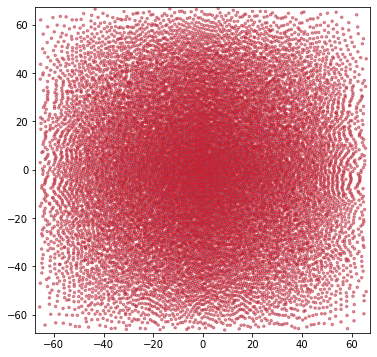

In [28]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,lm=1)

In [29]:
hist_bg = bg.train_x(batches=100,epochs=30,lr=0.00003,batch_size=1)

Epoch 1/30
100/100 [==============================] - 17s 138ms/step - loss: 669693.0347
Epoch 2/30
100/100 [==============================] - 14s 137ms/step - loss: 803284.4901
Epoch 3/30
100/100 [==============================] - 14s 137ms/step - loss: 621534.4765
Epoch 4/30
100/100 [==============================] - 14s 137ms/step - loss: 504981.2967
Epoch 5/30
100/100 [==============================] - 14s 138ms/step - loss: 461512.0118
Epoch 6/30
100/100 [==============================] - 14s 137ms/step - loss: 444581.1788
Epoch 7/30
100/100 [==============================] - 14s 137ms/step - loss: 428930.5637
Epoch 8/30
100/100 [==============================] - 14s 138ms/step - loss: 419463.7871
Epoch 9/30
100/100 [==============================] - 14s 137ms/step - loss: 414569.7287
Epoch 10/30
100/100 [==============================] - 14s 138ms/step - loss: 405036.1897
Epoch 11/30
100/100 [==============================] - 14s 139ms/step - loss: 398612.2649
Epoch 12/30
100/100

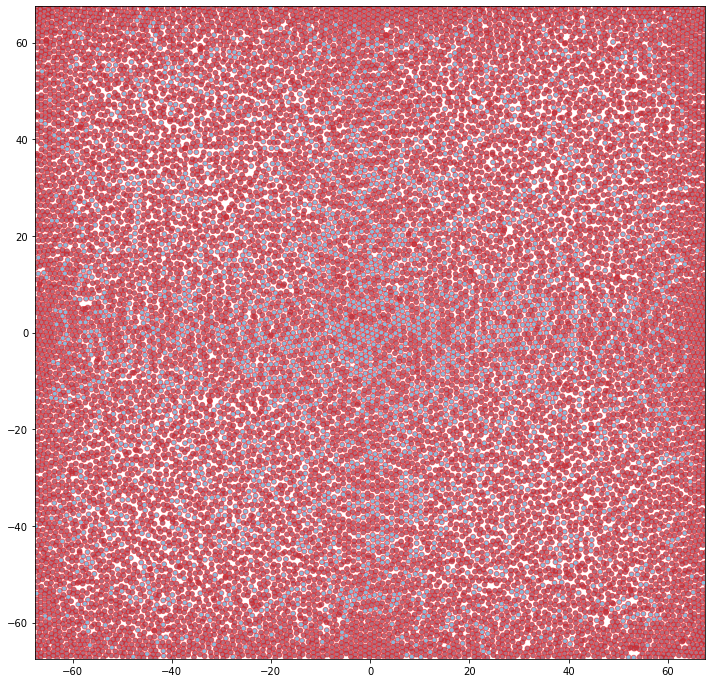

In [30]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True, lm=2)

In [31]:
hist_bg = bg.train_x(batches=100,epochs=30,lr=0.00005,batch_size=1)

Epoch 1/30
100/100 [==============================] - 17s 137ms/step - loss: 532828.6355
Epoch 2/30
100/100 [==============================] - 14s 138ms/step - loss: 453551.2423
Epoch 3/30
100/100 [==============================] - 14s 138ms/step - loss: 436179.6467
Epoch 4/30
100/100 [==============================] - 14s 138ms/step - loss: 404651.7478
Epoch 5/30
100/100 [==============================] - 14s 137ms/step - loss: 401326.3490
Epoch 6/30
100/100 [==============================] - 14s 138ms/step - loss: 395396.8131
Epoch 7/30
100/100 [==============================] - 14s 138ms/step - loss: 393836.9446
Epoch 8/30
100/100 [==============================] - 14s 138ms/step - loss: 392172.4725
Epoch 9/30
100/100 [==============================] - 14s 138ms/step - loss: 391189.3605
Epoch 10/30
100/100 [==============================] - 14s 138ms/step - loss: 388763.9573
Epoch 11/30
100/100 [==============================] - 14s 137ms/step - loss: 388383.7129
Epoch 12/30
100/100

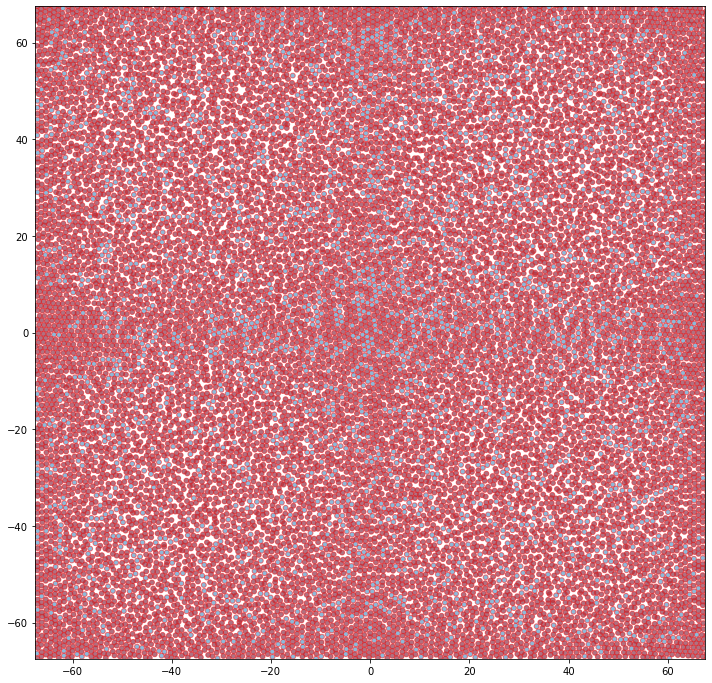

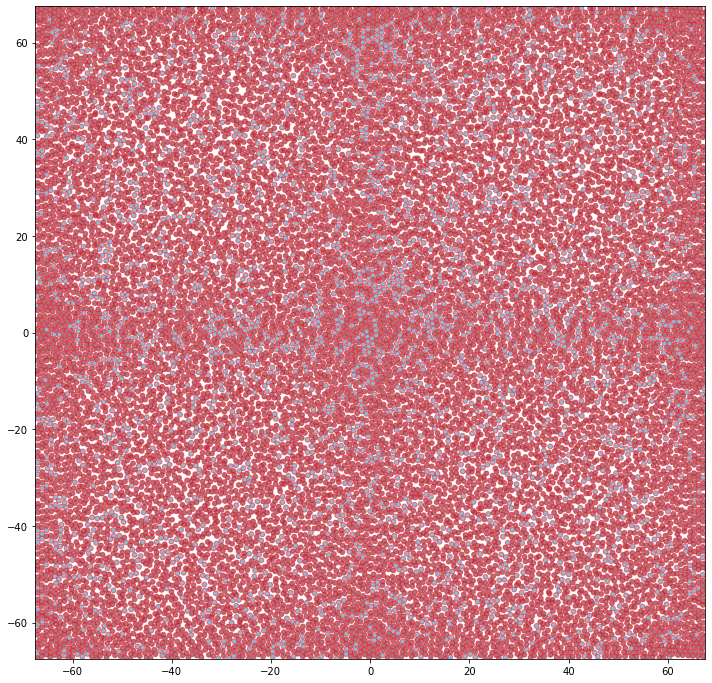

In [32]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True, lm=2)
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.2).reshape(-1,2)),L=L,color_overlapper=True, lm=2)

In [39]:
hist_bg = bg.train_x(batches=500,epochs=30,lr=0.00001,batch_size=1)

Epoch 1/30
500/500 [==============================] - 72s 138ms/step - loss: 267207.1085
Epoch 2/30
500/500 [==============================] - 69s 137ms/step - loss: 261972.6417
Epoch 3/30
500/500 [==============================] - 69s 138ms/step - loss: 262011.5580
Epoch 4/30
500/500 [==============================] - 69s 138ms/step - loss: 261701.0730
Epoch 5/30
500/500 [==============================] - 70s 139ms/step - loss: 261509.9197
Epoch 6/30
500/500 [==============================] - 69s 139ms/step - loss: 261431.8923
Epoch 7/30
500/500 [==============================] - 69s 138ms/step - loss: 261212.2501
Epoch 8/30
500/500 [==============================] - 70s 139ms/step - loss: 261119.7183
Epoch 9/30
500/500 [==============================] - 69s 138ms/step - loss: 261055.1677
Epoch 10/30
500/500 [==============================] - 69s 137ms/step - loss: 260960.8639
Epoch 11/30
500/500 [==============================] - 69s 137ms/step - loss: 260676.2181
Epoch 12/30
500/500

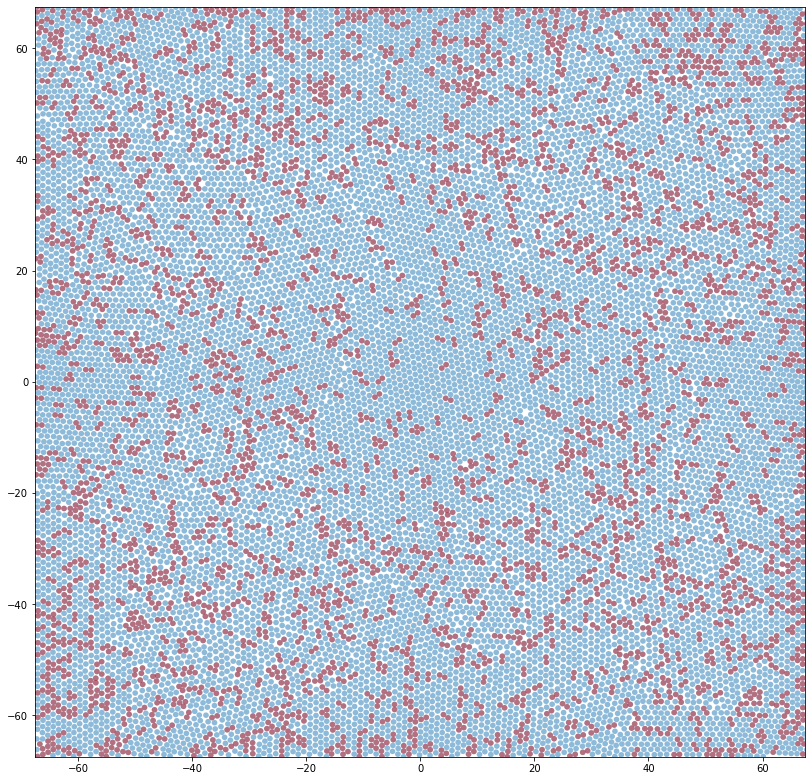

In [38]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True, lm=2.3)

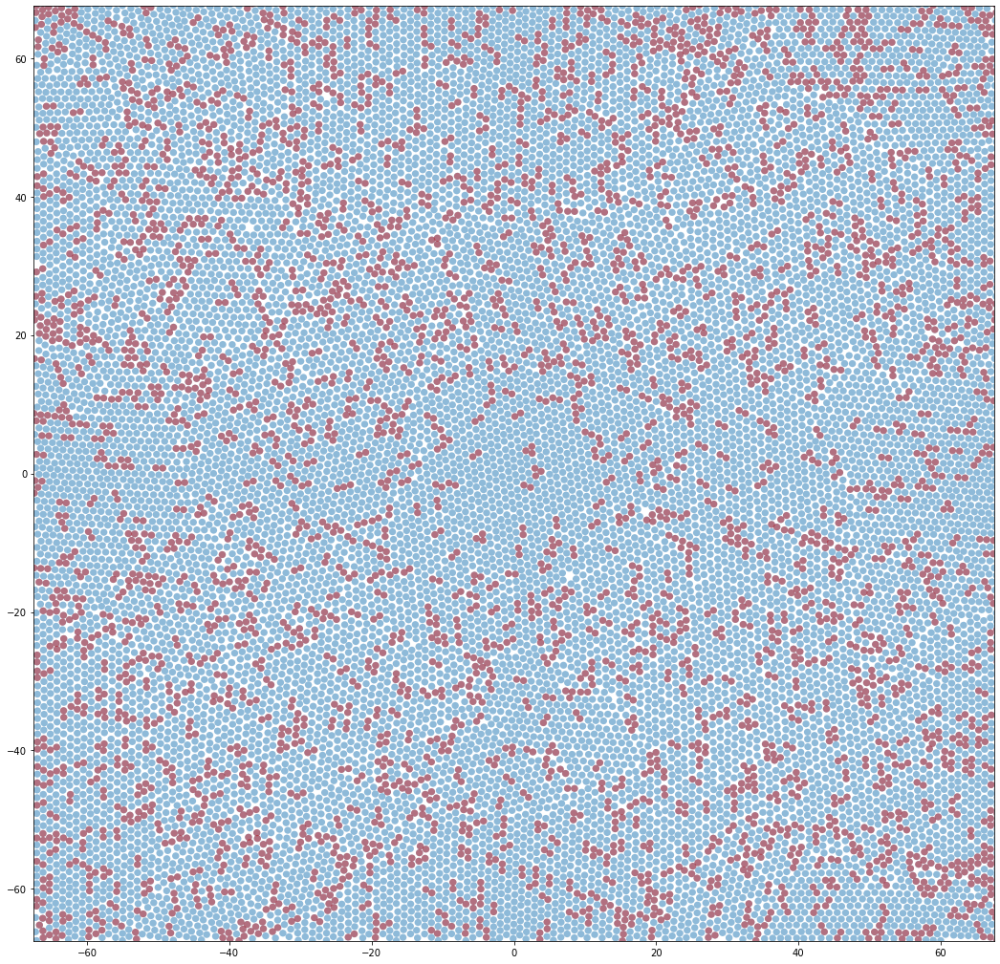

In [41]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True, lm=3)

## Train phi = .706, N = 65536

In [15]:
# Xtrain = np.load('Xtrain_1024_706_10k.npy')
phi = 0.706 # packing fraction
sigma = 1
N = 65536
L = (N*(np.pi*0.25*sigma**2)/phi)**0.5
model = HardDisks(N=N,
                  L=L,
                  sigma=sigma,
                  eps=50)
side = int(np.sqrt(N))

In [16]:
# Generate fake configurations for train_z
num_frames = 500
side = int(np.sqrt(N))
Xtrain = np.zeros((num_frames,N*2))
for h in np.arange(num_frames):
    for idx, i in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
        for idy, j in enumerate(np.linspace(-L/2+sigma,L/2-sigma,side)):
            Xtrain[h,idx*side*2+idy*2] = i
            Xtrain[h,idx*side*2+idy*2+1] = j
# print(Xtrain[0][:10])
# print(Xtrain[0].reshape(-1,2).shape)
# plot_config_wrap(model.wrap(Xtrain[0].reshape(-1,2)),L=L,lm=1)

In [ ]:
plot_config_wrap(model.wrap(Xtrain[0].reshape(-1,2)),L=L,lm=1.5)

In [17]:
print(Xtrain[0][:10])

[-134.00584139 -134.00584139 -134.00584139 -132.95481518 -134.00584139
 -131.90378897 -134.00584139 -130.85276277 -134.00584139 -129.80173656]


In [ ]:
# reset model
#bg = invnet(model.dim, 'LRRRRRRRRRRRR', overlap_model=model, nl_layers=4, nl_hidden=200, #100
bg = invnet(model.dim, 'LRRRRRRRRR', overlap_model=model, nl_layers=3, nl_hidden=200, #200, #100
#            nl_activation='tanh', nl_activation_t='tanh', L=L)
           nl_activation='tanh', nl_activation_t='relu', L=L)

L<RRRRRRRRR>


In [ ]:
batchsize = 300

In [ ]:
a, sample_x, b, overlap_x, w, logw = bg.sample(nsample=1, temperature=0.1)

In [ ]:
sample_x[0:1]

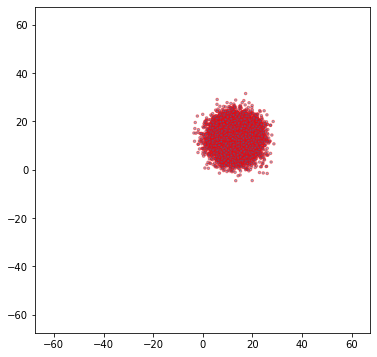

In [22]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.2).reshape(-1,2)),L=L,lm=1)

In [23]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.0003,batch_size=100)

Epoch 1/50
5/5 [==============================] - 3s 47ms/step - loss: -14301.5160
Epoch 2/50
5/5 [==============================] - 0s 44ms/step - loss: -36851.3574
Epoch 3/50
5/5 [==============================] - 0s 44ms/step - loss: -49034.9792
Epoch 4/50
5/5 [==============================] - 0s 44ms/step - loss: -58736.3880
Epoch 5/50
5/5 [==============================] - 0s 44ms/step - loss: -71032.9297
Epoch 6/50
5/5 [==============================] - 0s 44ms/step - loss: -61755.1829
Epoch 7/50
5/5 [==============================] - 0s 44ms/step - loss: -30604.0221
Epoch 8/50
5/5 [==============================] - 0s 44ms/step - loss: -42017.0625
Epoch 9/50
5/5 [==============================] - 0s 44ms/step - loss: -53086.9590
Epoch 10/50
5/5 [==============================] - 0s 44ms/step - loss: -66803.8073
Epoch 11/50
5/5 [==============================] - 0s 44ms/step - loss: -73752.4232
Epoch 12/50
5/5 [==============================] - 0s 44ms/step - loss: -83091.7383
E

In [24]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.00005,batch_size=100)

Epoch 1/50
5/5 [==============================] - 3s 45ms/step - loss: -97753.2656
Epoch 2/50
5/5 [==============================] - 0s 44ms/step - loss: -119402.2760
Epoch 3/50
5/5 [==============================] - 0s 44ms/step - loss: -128544.3685
Epoch 4/50
5/5 [==============================] - 0s 44ms/step - loss: -136072.3438
Epoch 5/50
5/5 [==============================] - 0s 44ms/step - loss: -142911.0625
Epoch 6/50
5/5 [==============================] - 0s 44ms/step - loss: -148319.0391
Epoch 7/50
5/5 [==============================] - 0s 44ms/step - loss: -154943.1146
Epoch 8/50
5/5 [==============================] - 0s 44ms/step - loss: -149063.7214
Epoch 9/50
5/5 [==============================] - 0s 44ms/step - loss: -144644.4089
Epoch 10/50
5/5 [==============================] - 0s 44ms/step - loss: -156563.4948
Epoch 11/50
5/5 [==============================] - 0s 44ms/step - loss: -164357.8333
Epoch 12/50
5/5 [==============================] - 0s 45ms/step - loss: -16

In [25]:
hist_bg = bg.train_z(x=Xtrain[::1],epochs=50,lr=0.00001,batch_size=100)

Epoch 1/50
5/5 [==============================] - 3s 44ms/step - loss: -105933.1445
Epoch 2/50
5/5 [==============================] - 0s 44ms/step - loss: -114739.7279
Epoch 3/50
5/5 [==============================] - 0s 43ms/step - loss: -117996.9505
Epoch 4/50
5/5 [==============================] - 0s 44ms/step - loss: -120995.4102
Epoch 5/50
5/5 [==============================] - 0s 44ms/step - loss: -123742.2721
Epoch 6/50
5/5 [==============================] - 0s 44ms/step - loss: -126751.5273
Epoch 7/50
5/5 [==============================] - 0s 44ms/step - loss: -129823.0612
Epoch 8/50
5/5 [==============================] - 0s 44ms/step - loss: -132531.3073
Epoch 9/50
5/5 [==============================] - 0s 44ms/step - loss: -135159.7812
Epoch 10/50
5/5 [==============================] - 0s 44ms/step - loss: -138144.3802
Epoch 11/50
5/5 [==============================] - 0s 44ms/step - loss: -140571.7057
Epoch 12/50
5/5 [==============================] - 0s 44ms/step - loss: -1

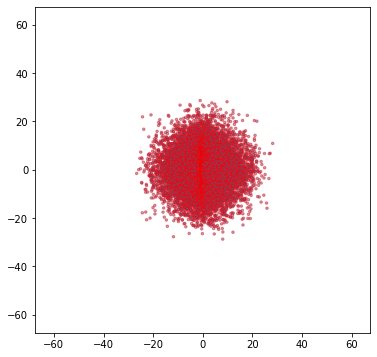

In [26]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,lm=1)
# plot_config_wrap(model.wrap(np.mean(Xtrain.reshape(len(Xtrain),-1,2),axis=0)),L=L)

In [27]:
hist_bg = bg.train_x(batches=100,epochs=30,lr=0.00001,batch_size=1)

Epoch 1/30
100/100 [==============================] - 17s 138ms/step - loss: 5569395.1807
Epoch 2/30
100/100 [==============================] - 14s 138ms/step - loss: 1088553.0811
Epoch 3/30
100/100 [==============================] - 14s 138ms/step - loss: 864648.3113
Epoch 4/30
100/100 [==============================] - 14s 138ms/step - loss: 802396.5408
Epoch 5/30
100/100 [==============================] - 14s 138ms/step - loss: 778460.8682
Epoch 6/30
100/100 [==============================] - 14s 138ms/step - loss: 751531.1275
Epoch 7/30
100/100 [==============================] - 14s 137ms/step - loss: 730841.3787
Epoch 8/30
100/100 [==============================] - 14s 137ms/step - loss: 708746.1368
Epoch 9/30
100/100 [==============================] - 14s 138ms/step - loss: 685868.0421
Epoch 10/30
100/100 [==============================] - 14s 137ms/step - loss: 663679.2079
Epoch 11/30
100/100 [==============================] - 14s 137ms/step - loss: 644783.8750
Epoch 12/30
100/1

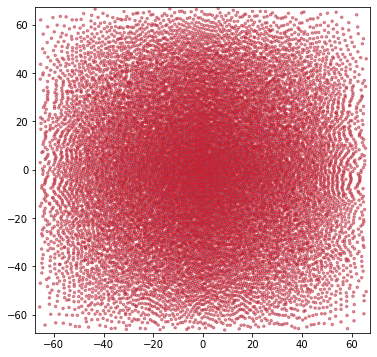

In [28]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,lm=1)

In [29]:
hist_bg = bg.train_x(batches=100,epochs=30,lr=0.00003,batch_size=1)

Epoch 1/30
100/100 [==============================] - 17s 138ms/step - loss: 669693.0347
Epoch 2/30
100/100 [==============================] - 14s 137ms/step - loss: 803284.4901
Epoch 3/30
100/100 [==============================] - 14s 137ms/step - loss: 621534.4765
Epoch 4/30
100/100 [==============================] - 14s 137ms/step - loss: 504981.2967
Epoch 5/30
100/100 [==============================] - 14s 138ms/step - loss: 461512.0118
Epoch 6/30
100/100 [==============================] - 14s 137ms/step - loss: 444581.1788
Epoch 7/30
100/100 [==============================] - 14s 137ms/step - loss: 428930.5637
Epoch 8/30
100/100 [==============================] - 14s 138ms/step - loss: 419463.7871
Epoch 9/30
100/100 [==============================] - 14s 137ms/step - loss: 414569.7287
Epoch 10/30
100/100 [==============================] - 14s 138ms/step - loss: 405036.1897
Epoch 11/30
100/100 [==============================] - 14s 139ms/step - loss: 398612.2649
Epoch 12/30
100/100

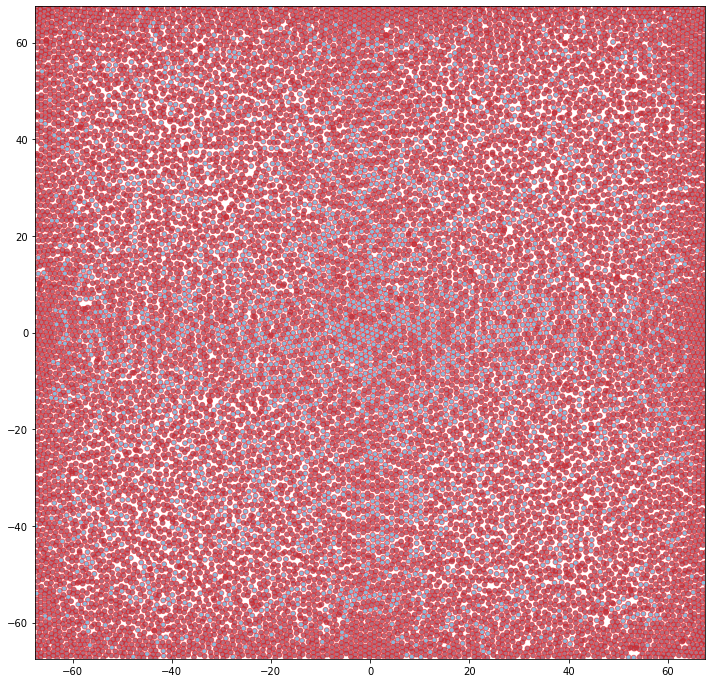

In [30]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True, lm=2)

In [31]:
hist_bg = bg.train_x(batches=100,epochs=30,lr=0.00005,batch_size=1)

Epoch 1/30
100/100 [==============================] - 17s 137ms/step - loss: 532828.6355
Epoch 2/30
100/100 [==============================] - 14s 138ms/step - loss: 453551.2423
Epoch 3/30
100/100 [==============================] - 14s 138ms/step - loss: 436179.6467
Epoch 4/30
100/100 [==============================] - 14s 138ms/step - loss: 404651.7478
Epoch 5/30
100/100 [==============================] - 14s 137ms/step - loss: 401326.3490
Epoch 6/30
100/100 [==============================] - 14s 138ms/step - loss: 395396.8131
Epoch 7/30
100/100 [==============================] - 14s 138ms/step - loss: 393836.9446
Epoch 8/30
100/100 [==============================] - 14s 138ms/step - loss: 392172.4725
Epoch 9/30
100/100 [==============================] - 14s 138ms/step - loss: 391189.3605
Epoch 10/30
100/100 [==============================] - 14s 138ms/step - loss: 388763.9573
Epoch 11/30
100/100 [==============================] - 14s 137ms/step - loss: 388383.7129
Epoch 12/30
100/100

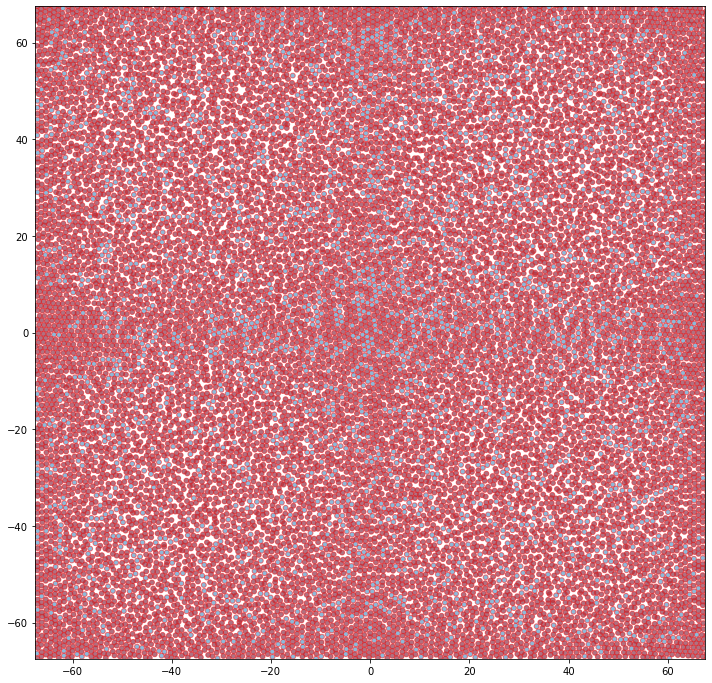

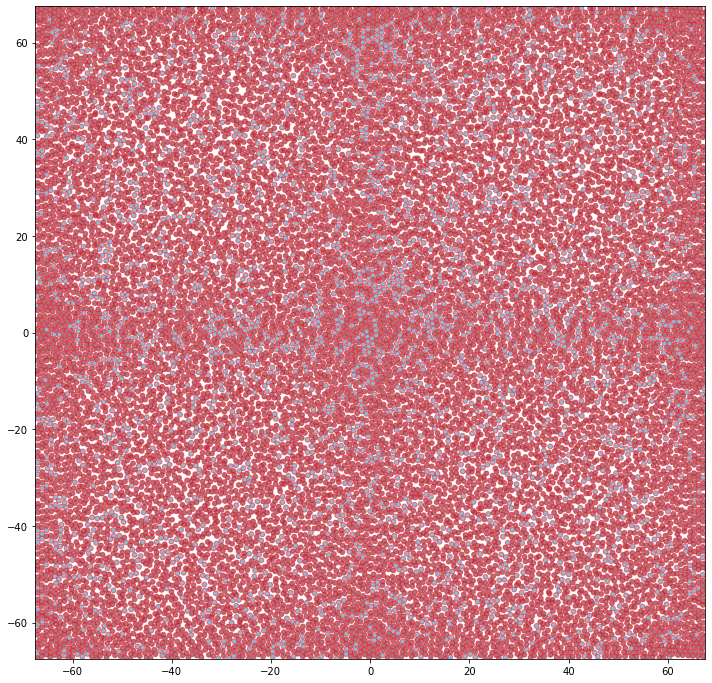

In [32]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True, lm=2)
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.2).reshape(-1,2)),L=L,color_overlapper=True, lm=2)

In [39]:
hist_bg = bg.train_x(batches=500,epochs=30,lr=0.00001,batch_size=1)

Epoch 1/30
500/500 [==============================] - 72s 138ms/step - loss: 267207.1085
Epoch 2/30
500/500 [==============================] - 69s 137ms/step - loss: 261972.6417
Epoch 3/30
500/500 [==============================] - 69s 138ms/step - loss: 262011.5580
Epoch 4/30
500/500 [==============================] - 69s 138ms/step - loss: 261701.0730
Epoch 5/30
500/500 [==============================] - 70s 139ms/step - loss: 261509.9197
Epoch 6/30
500/500 [==============================] - 69s 139ms/step - loss: 261431.8923
Epoch 7/30
500/500 [==============================] - 69s 138ms/step - loss: 261212.2501
Epoch 8/30
500/500 [==============================] - 70s 139ms/step - loss: 261119.7183
Epoch 9/30
500/500 [==============================] - 69s 138ms/step - loss: 261055.1677
Epoch 10/30
500/500 [==============================] - 69s 137ms/step - loss: 260960.8639
Epoch 11/30
500/500 [==============================] - 69s 137ms/step - loss: 260676.2181
Epoch 12/30
500/500

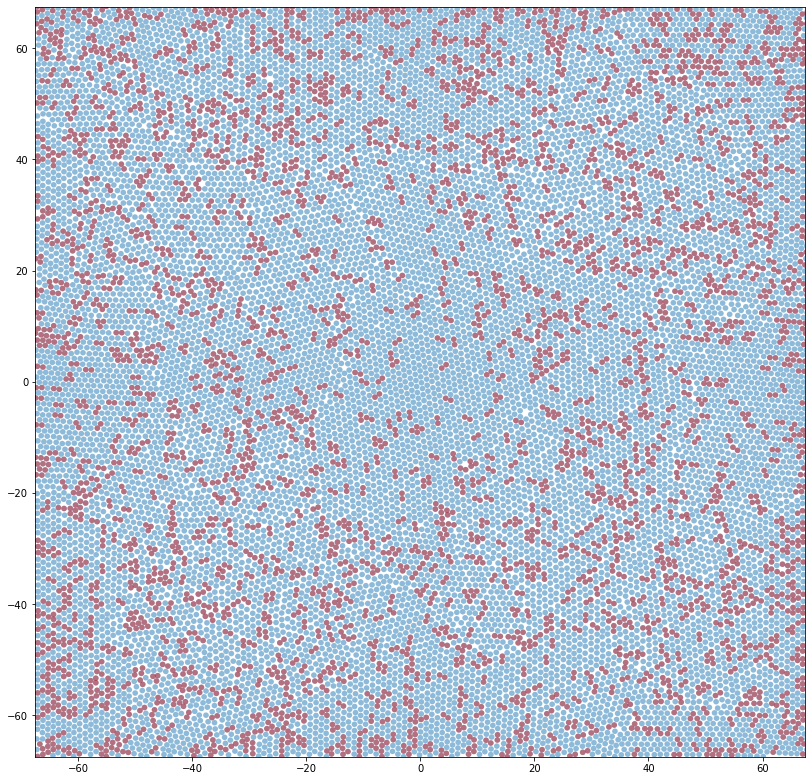

In [38]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True, lm=2.3)

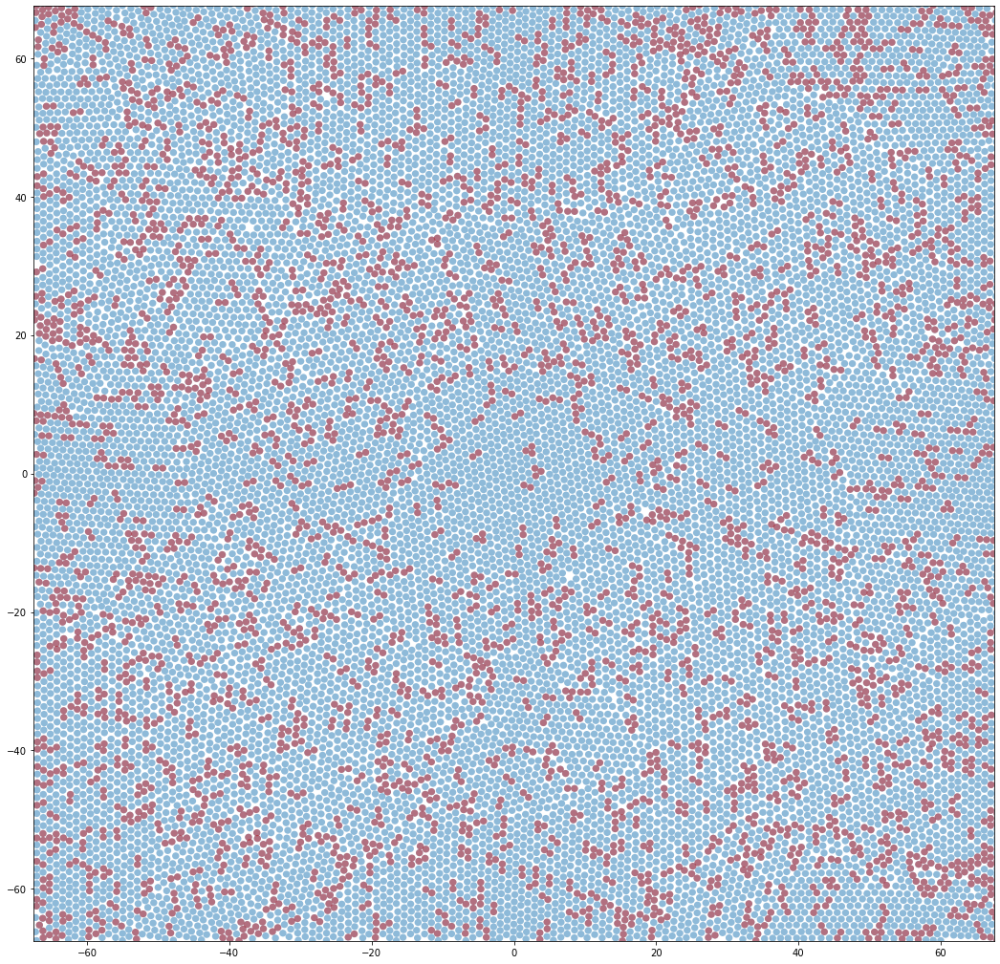

In [41]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L,color_overlapper=True, lm=3)

In [ ]:
model.smooth_overlap_tf(sample_x).numpy()

In [94]:
a, sample_x, b, overlap_x, w, logw = bg.sample(nsample=100, temperature=0.3)

[ 503.4486   750.79504  505.23865  213.41513  536.73816  599.3284
  452.2646  1012.3357   387.39456  536.59717  566.0545   738.32825
  357.75232  898.6919   678.9737  1078.5994   344.98715  492.40698
  605.4177   287.90237  242.038    497.90594  636.0626   610.1661
  663.693    668.182    457.42715  606.52344  571.8976   771.4343
  684.43146  430.51352  332.15152  369.70963 1044.6874   462.84225
  672.4124  1041.8418   673.3078   650.184    600.1568   512.4421
  684.9402   475.41473 1010.1366   545.97375  427.16296  440.97852
  757.6998   492.5841   630.1659   501.85236  560.8127   527.4517
  411.23047  817.9803   683.7757   241.68958  377.81314  438.1275
  592.2527   379.6352   584.28     277.33444  633.44025  738.80505
  957.04034  513.3448   813.47687  640.0536   262.69733  535.7825
  934.8185   414.44922  889.3385   339.47253  524.2893   410.69913
  468.84003  494.5033   501.26108  509.60138  672.681    944.3733
  253.70325  478.17413  681.9273   553.5253   749.05786  648.23627
  7

In [32]:
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.).reshape(-1,2)),L=L)

<ipython-input-11-d941b1596c25>:100: RuntimeWarning: invalid value encountered in floor_divide
  xcomp -= ((xcomp+0.5*self.L)//self.L)*self.L
<ipython-input-11-d941b1596c25>:101: RuntimeWarning: invalid value encountered in floor_divide
  ycomp -= ((ycomp+0.5*self.L)//self.L)*self.L


ValueError: need at least one array to concatenate

<Figure size 1296x1296 with 1 Axes>

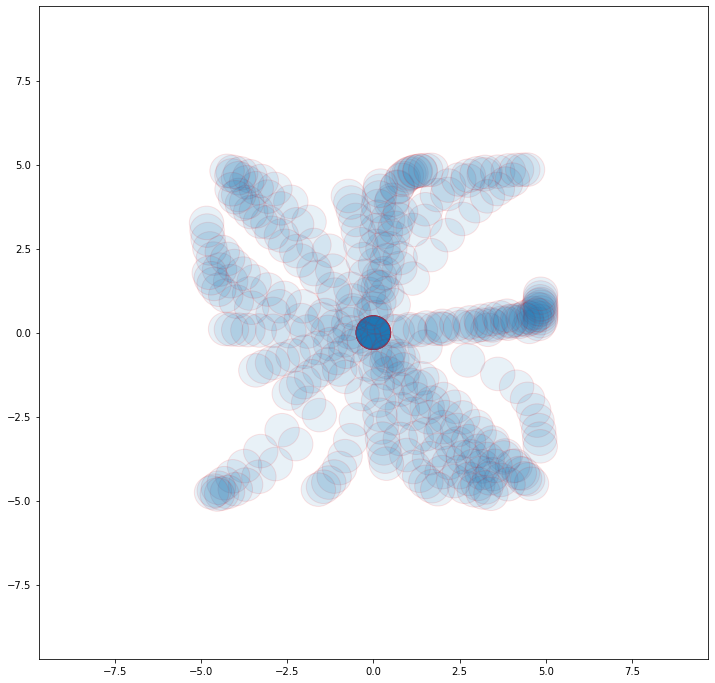

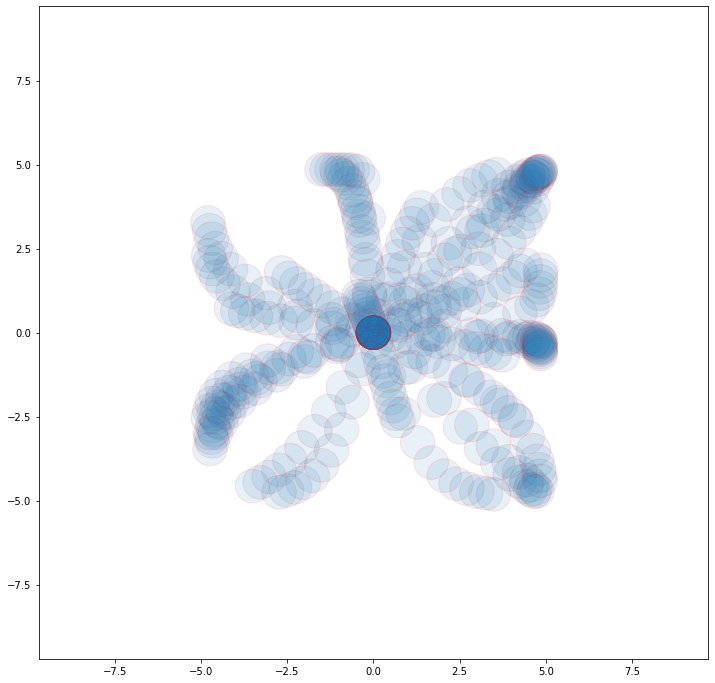

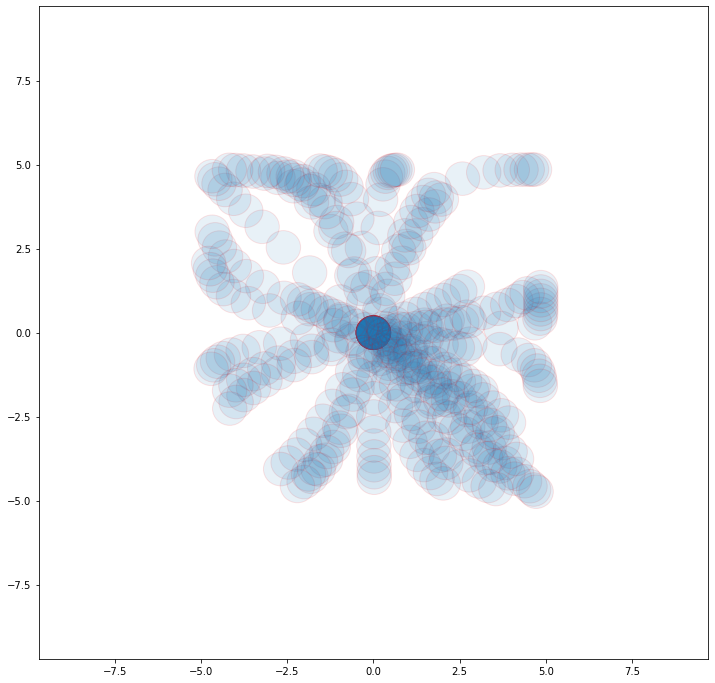

In [108]:
zeroes = np.zeros_like(sample_x[0:1])
# print(zeroes)
for i in range(0, 11):
    zeroes[0][0] = i
    if i == 0:
        fig, ax = plot_config_wrap_multiple(bg.Tzx.predict(zeroes).reshape(-1,2),L=L*2, first=True)
    else:
        plot_config_wrap_multiple(bg.Tzx.predict(zeroes).reshape(-1,2),L=L*2, first=False, fig=fig, ax=ax)
zeroes = np.zeros_like(sample_x[0:1])
# print(zeroes)
for i in range(0, 11):
    zeroes[0][1] = i
    if i == 0:
        fig, ax = plot_config_wrap_multiple(bg.Tzx.predict(zeroes).reshape(-1,2),L=L*2, first=True)
    else:
        plot_config_wrap_multiple(bg.Tzx.predict(zeroes).reshape(-1,2),L=L*2, first=False, fig=fig, ax=ax)
zeroes = np.zeros_like(sample_x[0:1])
# print(zeroes)
for i in range(0, 11):
    zeroes[0][2] = i
    if i == 0:
        fig, ax = plot_config_wrap_multiple(bg.Tzx.predict(zeroes).reshape(-1,2),L=L*2, first=True)
    else:
        plot_config_wrap_multiple(bg.Tzx.predict(zeroes).reshape(-1,2),L=L*2, first=False, fig=fig, ax=ax)

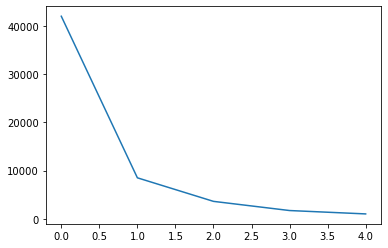

In [37]:
fig, ax = plt.subplots()
ax.plot(hist_bg.history['loss'])

In [111]:
print(tf.__version__)

2.4.1


In [29]:
np.mean(overlap_x)

52.524384

In [99]:
# np.zeros_like(sample_x[0:1])+0.2

In [100]:
# np.linalg.norm(a,axis=1)

In [101]:
# a[0]

In [603]:
# np.array([np.linalg.norm(a,axis=1),b]).T

array([[8.46199682e+00, 2.82544659e-16],
       [8.93540573e+00, 4.59879313e-18],
       [7.38280747e+00, 1.45950608e-12],
       [9.25789848e+00, 2.44678442e-19],
       [9.47650869e+00, 3.15690892e-20],
       [8.51270122e+00, 1.83734287e-16],
       [8.26341027e+00, 1.48706108e-15],
       [8.88630304e+00, 7.12308409e-18],
       [8.27129682e+00, 1.39319661e-15],
       [8.71533774e+00, 3.20717556e-17],
       [8.84716154e+00, 1.00784353e-17],
       [8.55810795e+00, 1.24701870e-16],
       [8.43262211e+00, 3.62119335e-16],
       [7.72598885e+00, 1.09215665e-13],
       [8.61404036e+00, 7.71449395e-17],
       [7.96473304e+00, 1.67817195e-14],
       [8.89756549e+00, 6.44429890e-18],
       [8.52382102e+00, 1.67129554e-16],
       [9.26625593e+00, 2.26453017e-19],
       [8.14351570e+00, 3.97630280e-15],
       [8.00222016e+00, 1.24411890e-14],
       [9.97902172e+00, 2.37841615e-22],
       [7.21056043e+00, 5.12910011e-12],
       [8.75973880e+00, 2.17588330e-17],
       [7.538664

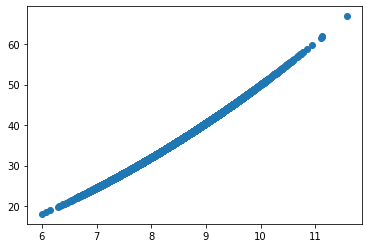

In [138]:
plt.scatter(np.linalg.norm(a,axis=1),b)

(array([3.630e+02, 4.304e+03, 3.872e+03, 2.960e+02, 4.000e+00, 1.000e+00,
        5.000e+00, 9.100e+01, 2.080e+02, 1.760e+02, 1.310e+02, 8.600e+01,
        6.200e+01, 5.200e+01, 5.000e+01, 3.400e+01, 2.800e+01, 2.600e+01,
        3.000e+01, 1.700e+01, 1.600e+01, 1.300e+01, 1.800e+01, 1.800e+01,
        1.100e+01, 6.000e+00, 6.000e+00, 6.000e+00, 6.000e+00, 8.000e+00,
        6.000e+00, 4.000e+00, 5.000e+00, 3.000e+00, 0.000e+00, 3.000e+00,
        2.000e+00, 2.000e+00, 1.000e+00, 2.000e+00, 2.000e+00, 4.000e+00,
        3.000e+00, 1.000e+00, 0.000e+00, 2.000e+00, 1.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 4.000e+00, 1.000e+00, 1.000e+00,
        1.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00,
        1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 2.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+0

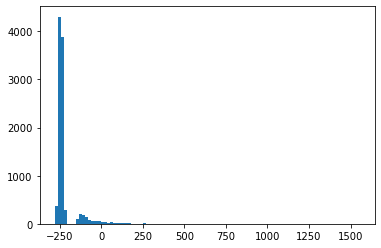

In [198]:
plt.hist(logw,bins=100)

tf.Tensor([28.54371], shape=(1,), dtype=float32)


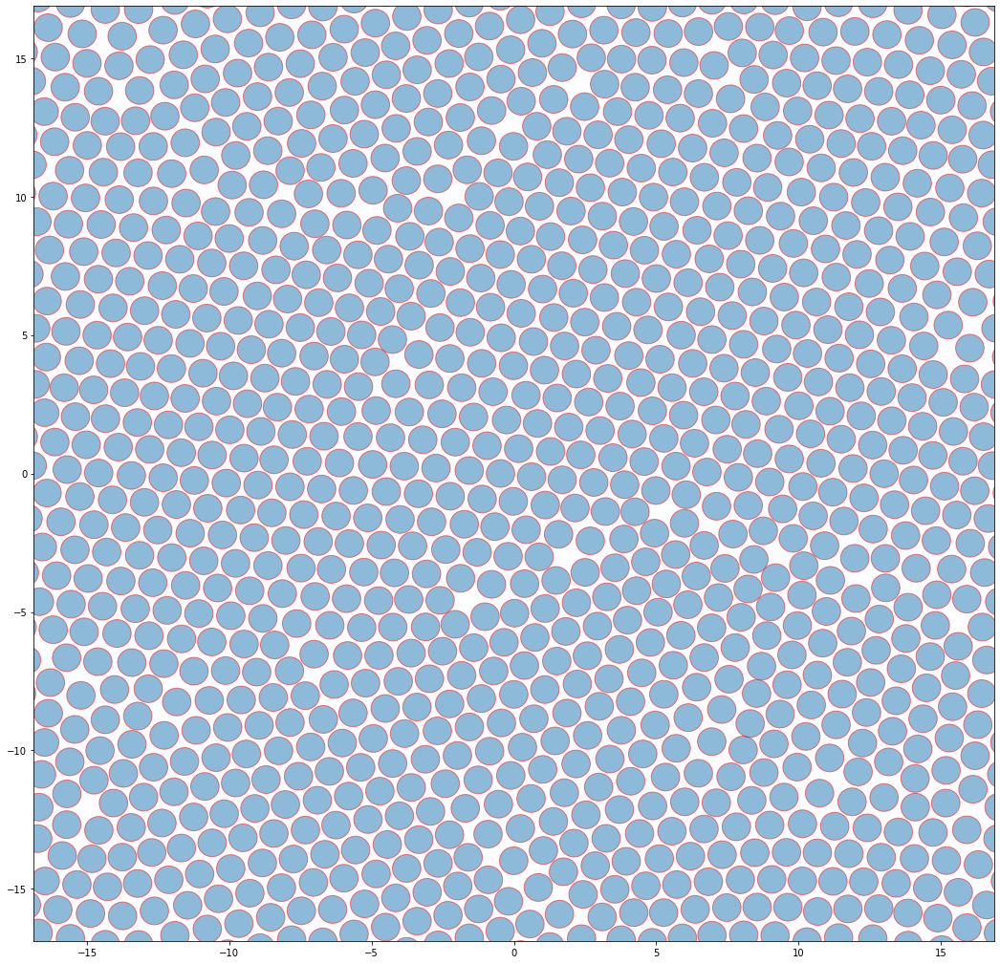

In [101]:
print(model.smooth_overlap_tf(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])))))
plot_config_wrap(model.wrap(bg.Tzx.predict(np.zeros_like(sample_x[0:1])+0.)).reshape(-1,2),L=L,color_overlapper=True)

In [98]:
model.smooth_overlap_tf(model.wrap(bg.Tzx.predict(sample_x[0:1])))

<tf.Tensor: shape=(1,), dtype=float32, numpy=array([34511790.], dtype=float32)>

In [24]:
sidx = 84
print(model.smooth_overlap_hoomd_tf(model.wrap(sample_x[sidx:sidx+1])))
print(model.smooth_overlap_tf(model.wrap(sample_x[sidx:sidx+1])))

AttributeError: module 'hoomd.data' has no attribute 'snapshot'

In [45]:
L

101.254381039557

In [46]:
N*sigma*sigma/4*np.pi/(L*L)

0.706

In [47]:
sample_x.min(),sample_x.max()

(-45.60818, 44.889355)

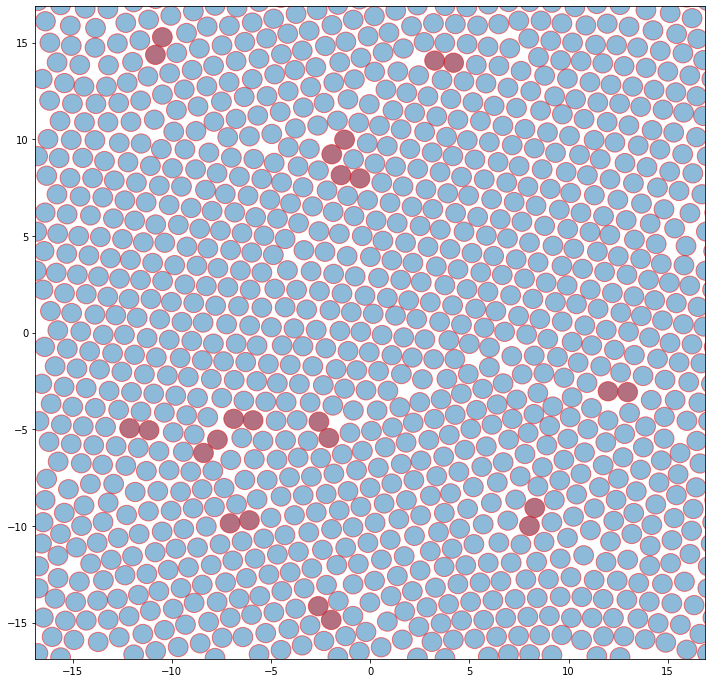

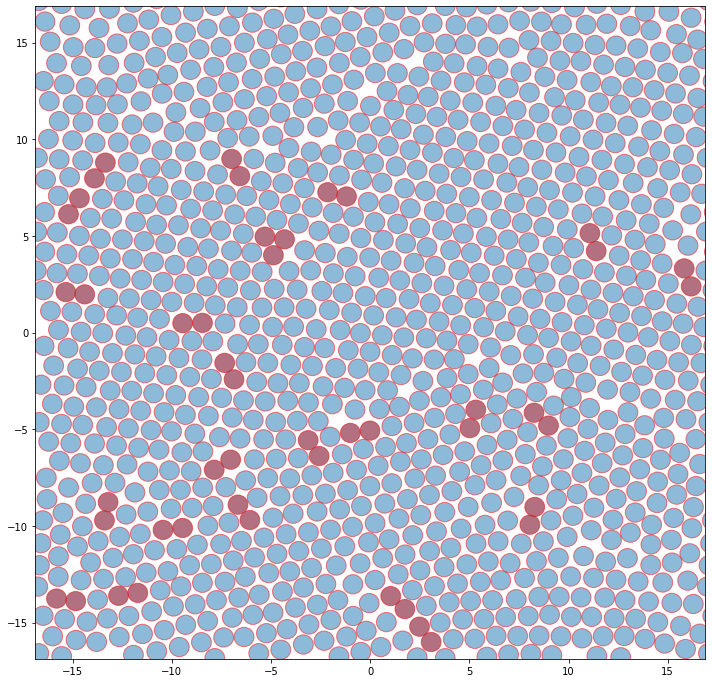

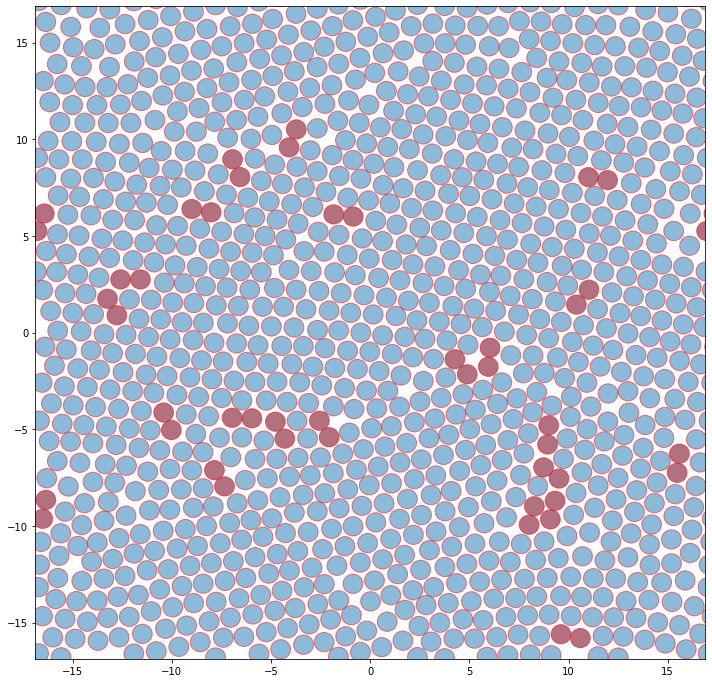

In [187]:
for i in range(3):
    plot_config_wrap(model.wrap(sample_x)[i:i+1].reshape(-1,2),L=L,color_overlapper=True,lm=2)

/opt/anaconda3/envs/BG/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


KeyboardInterrupt: 

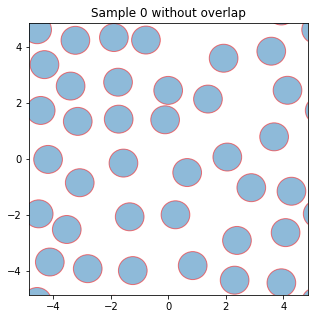

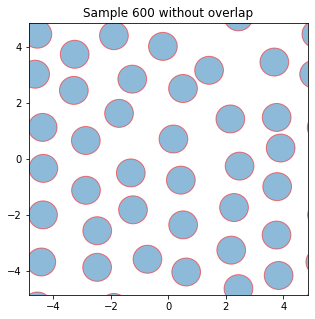

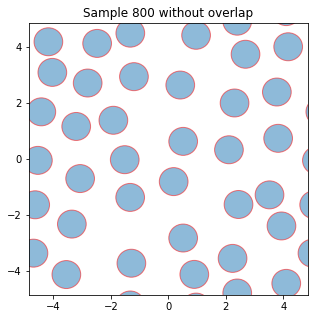

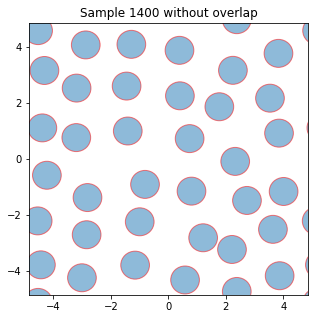

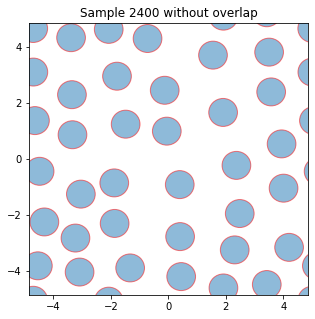

...

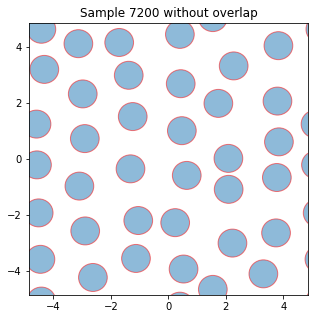

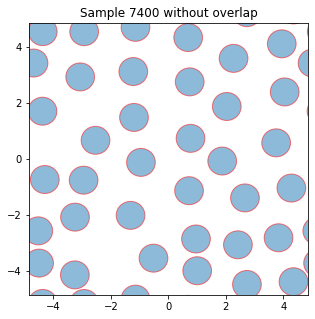

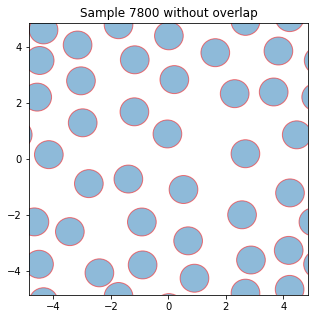

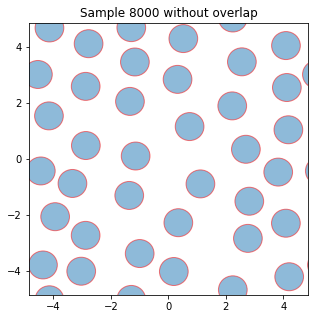

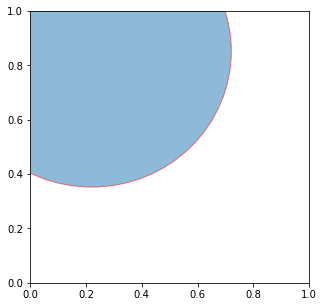

In [119]:
# plot_at_most = 50
# sts = (len(sample_x)//plot_at_most)
# for i in range(plot_at_most):
#     if model.smooth_overlap_tf(sample_x[i*sts:i*sts+1]) == 0:
#         plot_config_wrap(model.wrap(sample_x)[i*sts:i*sts+1].reshape(-1,2),L=L, title=f'Sample {i*sts} without overlap')

In [51]:
a, sample_x, b, overlap_x, w, logw = bg.sample(nsample=10000, temperature=1)

[471.8671   0.       0.     ...   0.       0.       0.    ]


In [53]:
sum(model.smooth_overlap_tf(sample_x).numpy() == 0) / len(sample_x)

0.9314

In [54]:
model.eps

1500

lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1
lm is 1


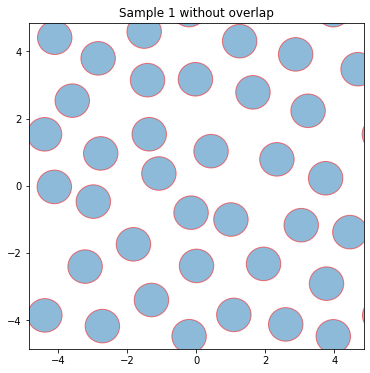

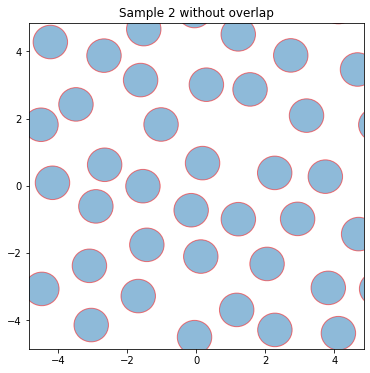

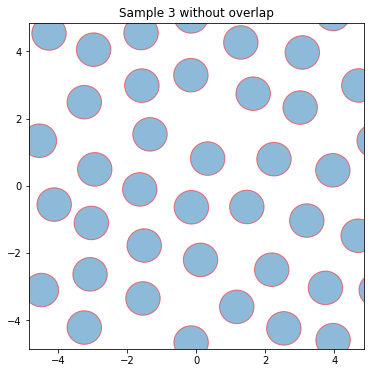

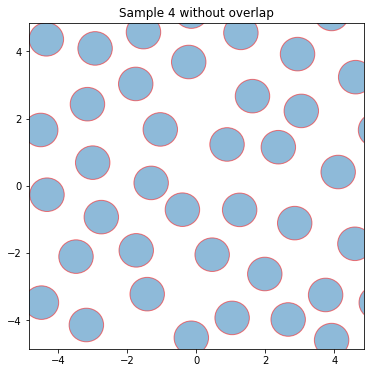

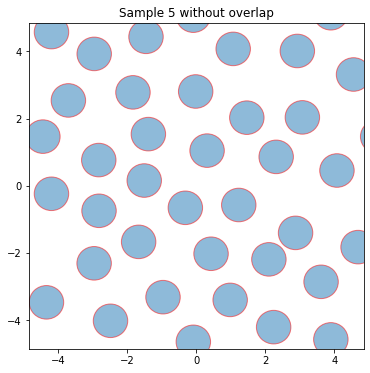

...

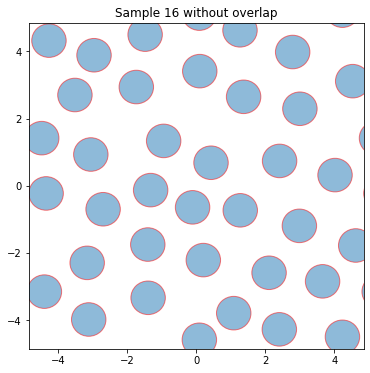

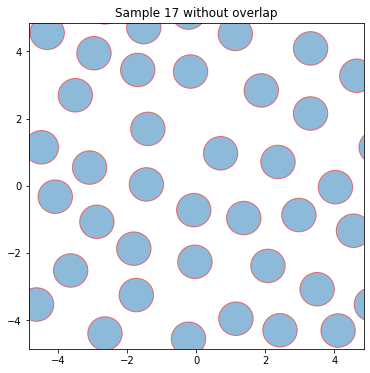

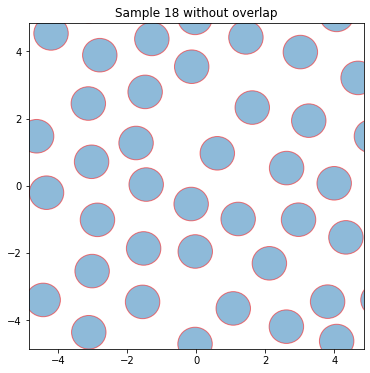

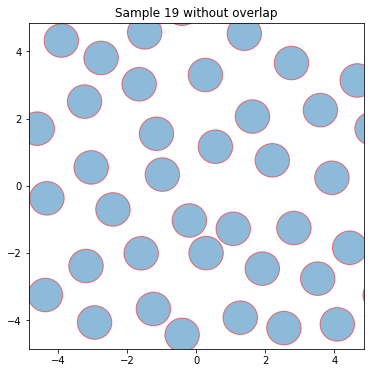

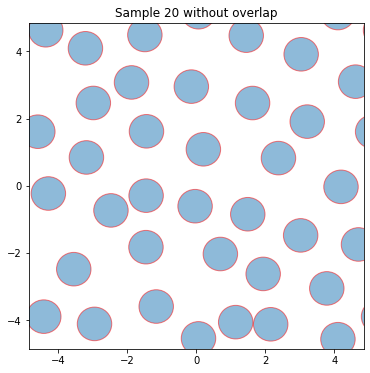

In [55]:
plot_at_most = 19
sts = (len(sample_x)//plot_at_most)
plotted = 0
zero_overlap_ones = np.where(model.smooth_overlap_tf(sample_x).numpy() == 0)[0]
for i in zero_overlap_ones:
    if model.smooth_overlap_tf(sample_x[i:i+1]) == 0:
        plot_config_wrap(model.wrap(sample_x)[i:i+1].reshape(-1,2),L=L, title=f'Sample {i} without overlap')
        plotted += 1
    if plotted > plot_at_most:
        break

In [27]:
plot_at_most = 8
plotted = 0
zero_overlap_ones = np.where(model.smooth_overlap_tf(sample_x).numpy() == 0)[0]
for i in zero_overlap_ones:
    if model.smooth_overlap_tf(sample_x[i:i+1]) == 0:
        if plotted == 0:
            fig, ax = plot_config_wrap_multiple(model.wrap(sample_x)[i:i+1].reshape(-1,2),L=L, title=f'Sample {i} without overlap', first=True)
        else:
            plot_config_wrap_multiple(model.wrap(sample_x)[i:i+1].reshape(-1,2),L=L, title=f'Sample {i} without overlap', first=False, fig=fig, ax=ax)
        plotted += 1
    if plotted > plot_at_most:
        break

<ipython-input-11-d941b1596c25>:100: RuntimeWarning: invalid value encountered in floor_divide
  xcomp -= ((xcomp+0.5*self.L)//self.L)*self.L
<ipython-input-11-d941b1596c25>:101: RuntimeWarning: invalid value encountered in floor_divide
  ycomp -= ((ycomp+0.5*self.L)//self.L)*self.L


ValueError: need at least one array to concatenate

<Figure size 864x864 with 1 Axes>

In [190]:
plot_at_most = 40


for i in range(plot_at_most):

    if i == 0:
        fig, ax = plot_config_wrap_multiple(model.wrap(sample_x)[i:i+1].reshape(-1,2),L=L, title=f'Sample {i} without overlap', first=True)
    else:
        plot_config_wrap_multiple(model.wrap(sample_x)[i:i+1].reshape(-1,2),L=L, title=f'Sample {i} without overlap', first=False, fig=fig, ax=ax)


KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7f81e06fdf80> (for post_execute):


KeyboardInterrupt: 

In [108]:
bg.save('test4096.model')

(array([6.06e+03, 2.14e+02, 1.82e+02, 1.89e+02, 1.86e+02, 2.03e+02,
        1.50e+02, 1.70e+02, 1.39e+02, 1.51e+02, 1.44e+02, 1.39e+02,
        1.34e+02, 1.26e+02, 1.44e+02, 1.01e+02, 1.33e+02, 9.90e+01,
        1.03e+02, 8.40e+01, 7.20e+01, 7.70e+01, 6.00e+01, 6.00e+01,
        6.20e+01, 6.40e+01, 6.70e+01, 5.10e+01, 4.00e+01, 3.90e+01,
        3.70e+01, 3.80e+01, 3.30e+01, 2.10e+01, 2.80e+01, 2.40e+01,
        2.80e+01, 2.80e+01, 2.20e+01, 2.40e+01, 1.90e+01, 1.80e+01,
        1.50e+01, 1.40e+01, 2.20e+01, 1.30e+01, 1.50e+01, 1.50e+01,
        7.00e+00, 9.00e+00, 8.00e+00, 4.00e+00, 5.00e+00, 5.00e+00,
        1.00e+01, 5.00e+00, 1.30e+01, 7.00e+00, 6.00e+00, 5.00e+00,
        5.00e+00, 5.00e+00, 4.00e+00, 2.00e+00, 3.00e+00, 5.00e+00,
        1.00e+00, 3.00e+00, 1.00e+00, 1.00e+00, 2.00e+00, 5.00e+00,
        0.00e+00, 1.00e+00, 0.00e+00, 3.00e+00, 0.00e+00, 0.00e+00,
        0.00e+00, 1.00e+00, 2.00e+00, 1.00e+00, 1.00e+00, 0.00e+00,
        0.00e+00, 1.00e+00, 1.00e+00, 0.00e+00, 

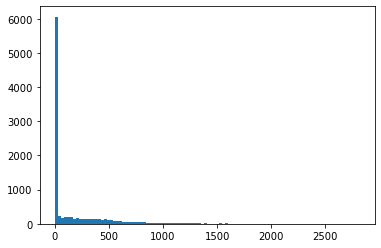

In [187]:
fig, ax = plt.subplots()
ax.hist(model.smooth_overlap_tf(sample_x).numpy(), bins=100)

/opt/anaconda3/envs/BG/lib/python3.7/site-packages/matplotlib/axes/_axes.py:6623: RuntimeWarning: All-NaN slice encountered
  xmin = min(xmin, np.nanmin(xi))
/opt/anaconda3/envs/BG/lib/python3.7/site-packages/matplotlib/axes/_axes.py:6624: RuntimeWarning: All-NaN slice encountered
  xmax = max(xmax, np.nanmax(xi))


ValueError: autodetected range of [nan, nan] is not finite

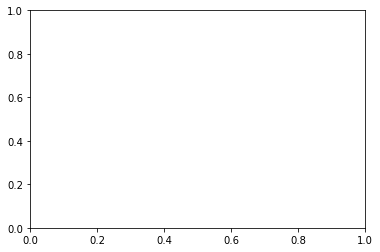

In [107]:
fig, ax = plt.subplots()
ax.hist(tf.keras.backend.eval(model.smooth_overlap_tf(sample_x)*w/tf.reduce_mean(w)),bins=20)
x = np.linspace(0,1000)

ax.set_yscale('log')

(array([   0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0., 1000.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0.,    0.]),
 array([-0.5 , -0.45, -0.4 , -0.35, -0.3 , -0.25, -0.2 , -0.15, -0.1 ,
        -0.05,  0.  ,  0.05,  0.1 ,  0.15,  0.2 ,  0.25,  0.3 ,  0.35,
         0.4 ,  0.45,  0.5 ], dtype=float32),
 <BarContainer object of 20 artists>)

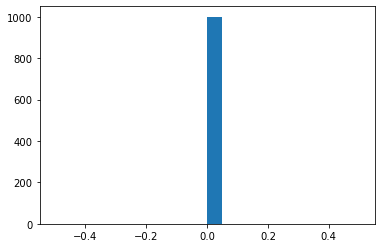

In [423]:
fig, ax = plt.subplots()
ax.hist(tf.keras.backend.eval(model.smooth_overlap_tf(Xtrain[0:1000])),bins=20)

In [427]:
np.array([f[-1].particles.position[:,:2].flatten(), Xtrain[-1]]).T

array([[ 0.70426345,  3.50787544],
       [ 3.59875178,  4.00698233],
       [ 0.66067493,  3.8949368 ],
       [-0.55142546, -4.13938951],
       [ 2.70731091,  4.798419  ],
       [-2.20287609, -2.57125878],
       [ 1.05227089,  4.02671719],
       [ 2.57348919, -1.51185513],
       [-2.39799094,  4.40564632],
       [-2.09704113, -0.10306334],
       [ 1.71431649,  4.08311272],
       [-1.5266993 ,  2.52854395],
       [ 4.798419  , -4.17038774],
       [-2.57125878,  4.70190287],
       [-3.92576528, -3.74221063],
       [-1.51659548, -3.81480908],
       [-0.9295913 , -2.59081316],
       [-0.00864144, -3.09157872],
       [ 4.02671719, -3.92576528],
       [-1.51185513, -1.51659548],
       [ 2.86907482, -4.14851284],
       [ 1.17682588,  0.75898933],
       [-0.87459266, -4.33959293],
       [-2.78883696,  3.30661368],
       [ 4.08311272, -1.9466269 ],
       [ 2.52854395,  2.85835433],
       [ 4.40564632, -0.78210586],
       [-0.10306334, -4.76854944],
       [-1.65577376,

In [436]:
def plot_config_wrap_num(pts,L=1,title=None):
    fig, ax = plt.subplots()
    fig.set_size_inches(5,5)
    pts_addl = []
    for p in pts:
        if p[0] < -L/2+0.5:
            pts_addl.append([p[0]+L, p[1]])  
            if p[1] < -L/2+0.5:
                pts_addl.append([p[0]+L, p[1]+L])
            if p[1] > -L/2+0.5:
                pts_addl.append([p[0]+L, p[1]-L])
        if p[0] > -L/2+0.5:
            pts_addl.append([p[0]-L, p[1]])
            if p[1] < -L/2+0.5:
                pts_addl.append([p[0]-L, p[1]+L])
            if p[1] > -L/2+0.5:
                pts_addl.append([p[0]-L, p[1]-L])
        if p[1] < -L/2+0.5:
            pts_addl.append([p[0], p[1]+L])
        if p[1] > -L/2+0.5:
            pts_addl.append([p[0], p[1]-L])
        
    circles = [plt.Circle(p,.5,alpha=0.5,ec='red') for p in pts]
    circles2 = [plt.Circle(p,.5,alpha=0.5,ec='red') for p in pts_addl]
    for idx, c in enumerate(circles):
        ax.add_patch(c)
        plt.text(pts[idx][0],pts[idx][1],f'{idx}')
    for c in circles2:
        ax.add_patch(c)
    ax.set_xlim(-L/2,L/2)
    ax.set_ylim(-L/2,L/2)
    if title is not None:
        ax.set_title(title)

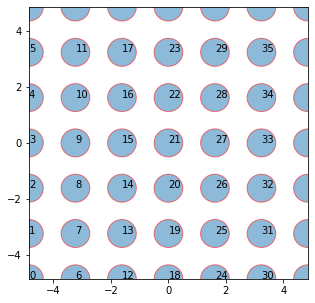

In [439]:
plot_config_wrap_num(model.wrap(f[0].particles.position),L=L)

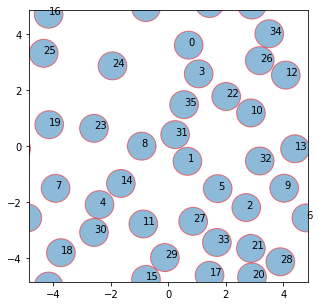

In [438]:
plot_config_wrap_num(model.wrap(f[-1].particles.position),L=L)

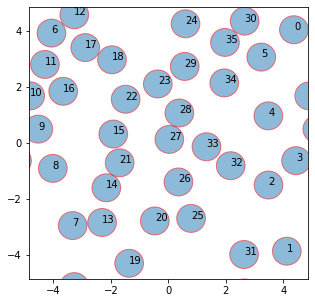

In [544]:
plot_config_wrap_num(Xtrain_new[100].reshape(-1,2),L=L)

In [531]:
Xtest = Xtrain[0].reshape(-1,2)

In [532]:
dist_frac(Xtest,1.1)

0.0

In [526]:
dist_frac_array = np.zeros((len(Xtrain)))
for i in range(len(Xtrain)):
#     if i % 1000 == 0:
#         print(dist_frac(Xtrain[i].reshape(-1,2),4))
    dist_frac_array[i] = dist_frac(Xtrain[i].reshape(-1,2),1.1)

In [539]:
(dist_frac_array > 0.4).sum()


18732

In [540]:
Xtrain_new = Xtrain[dist_frac_array>0.4]

In [541]:
np.where(dist_frac_array > 0.4)

(array([   71,    72,    77, ..., 99987, 99988, 99999]),)

(array([6.6600e+02, 3.7180e+03, 1.8164e+04, 1.9337e+04, 3.1032e+04,
        1.9559e+04, 5.1840e+03, 2.1120e+03, 2.1200e+02, 1.6000e+01]),
 array([0.   , 0.075, 0.15 , 0.225, 0.3  , 0.375, 0.45 , 0.525, 0.6  ,
        0.675, 0.75 ]),
 <BarContainer object of 10 artists>)

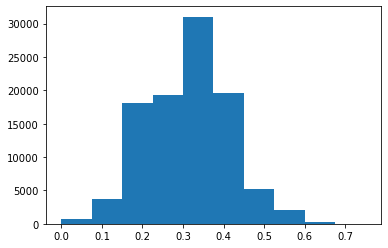

In [534]:
plt.hist(dist_frac_array)

In [520]:
def dist_frac(Xtest, thres=5):
    dist_mat = ((Xtest[:,:,None] - Xtest[:,:,None].T)**2).sum(1)
    dist_mat[dist_mat == 0] = 999
#     print(dist_mat)
#     print(np.min(dist_mat, axis=1))
    dist_mat = np.sqrt(np.min(dist_mat, axis=1)).flatten()
#     print(dist_mat)
    return np.sum(dist_mat < thres) / len(Xtest)

In [93]:
phi = 0.3 # packing fraction
sigma = 1
N = 2
L = (N*(np.pi*0.25*sigma**2)/phi)**0.5
model2 = HardDisks(N=2,
                  L=L,
                  sigma=sigma,
                  eps=500)

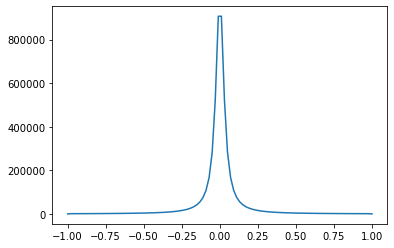

In [94]:
pot = []
for i in np.linspace(-1, 1, 100):
    coords = [[0.0,0.0,i,0.0]]
    pot.append(model2.smooth_overlap_tf(np.array(coords)).numpy())
#     print(model2.smooth_overlap_tf(np.array(coords)).numpy())
#     plot_config_wrap(np.array(coords).reshape(-1,2), L=L)
plt.plot(np.linspace(-1, 1,100),pot)

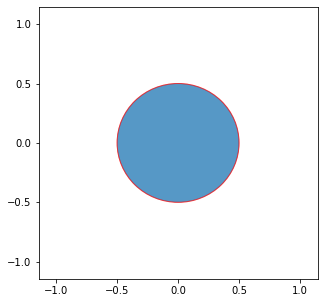

In [89]:
plot_config_wrap(np.array([[0.0,0.0,0.0,0]]).reshape(-1,2), L=L)

In [92]:
def log1pexp(x):
  return tf.math.log(1 + tf.exp(x))

In [93]:
log1pexp(tf.constant(3.)).numpy()

3.0485873

In [94]:
x = tf.Variable(100.)

with tf.GradientTape() as tape:
    y = log1pexp(x)
#     dy = tf.GradientTape(y, x) # Will be NaN when evaluated.

dy_dx = tape.gradient(y, x)


In [95]:
print(dy_dx)

tf.Tensor(nan, shape=(), dtype=float32)


In [96]:
@tf.custom_gradient
def log1pexp(x):
  e = tf.exp(x)
  def grad(dy):
    return dy * (1 - 1 / (1 + e))
  return tf.math.log(1 + e), grad

In [97]:
x = tf.Variable(100.)
with tf.GradientTape() as tape:
    y = log1pexp(x)
dy_dx = tape.gradient(y, x)

In [98]:
print(dy_dx)

tf.Tensor(1.0, shape=(), dtype=float32)
